In [1]:
#%matplotlib inline 
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
import math
from datetime import datetime as dt
from datetime import timedelta

from sklearn.svm import SVR 
from sklearn.preprocessing import MinMaxScaler 
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

from tensorflow.keras.models import Sequential 
from tensorflow.keras.layers import LSTM, Conv1D, MaxPooling1D, Activation, Dropout, Dropout, Dense, Flatten
from tensorflow.keras.constraints import MaxNorm
from tensorflow.keras.optimizers import Adam
import tensorflow.keras.backend as K

In [2]:
from google.colab import drive
drive.mount('/content/drive')

data = pd.read_csv('/content/drive/MyDrive/Data/Bike_Sharing/data_final.csv')
data = data.drop(data.columns[0], axis =1)
data['timestamp'] = data['timestamp'].apply(pd.to_datetime, format='%Y-%m-%d %H:%M:%S.%f')

weather = pd.read_csv('/content/drive/MyDrive/Data/Bike_Sharing/weather_data.csv')
weather = weather.drop(weather.columns[0], axis =1)
weather['timestamp'] = weather['timestamp'].apply(pd.to_datetime, format='%Y-%m-%d %H:%M:%S.%f')

Mounted at /content/drive


In [3]:
weather_data = weather.iloc[:,1:]

In [4]:
all_stations_demand = data.set_index('timestamp')
all_stations_demand

,A.I. Virtasen aukio,"Aalto-yliopisto (M), Korkeakouluaukio","Aalto-yliopisto (M), Tietotie",Abraham Wetterin tie,Agnetankuja,Agronominkatu,Ahertajantie,Alakiventie,Albertinkatu,Annankatu,...,Viikin normaalikoulu,Viikin tiedepuisto,Viiskulma,Vilhonvuorenkatu,Voikukantie,Von Daehnin katu,Westendinasema,Westendintie,Yhdyskunnankuja,Ympyrätalo
timestamp,,,,,,,,,,,,,,,,,,,,,
2016-05-02 15:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
2016-05-02 16:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6
2016-05-02 17:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
2016-05-02 18:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,10
2016-05-02 19:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-31 20:00:00,0,2,0,0,0,0,0,0,1,0,...,0,1,4,0,0,0,1,0,0,2
2020-10-31 21:00:00,0,1,1,0,1,0,0,0,1,0,...,0,0,0,3,0,0,0,0,0,2
2020-10-31 22:00:00,0,3,2,0,0,1,0,0,0,5,...,0,1,1,1,0,0,0,0,0,3


In [5]:
# take sample data to test model
sample_demand = all_stations_demand.iloc[:,:200]
sample_weather = weather.iloc[:,1:]

In [6]:
sample_demand

,A.I. Virtasen aukio,"Aalto-yliopisto (M), Korkeakouluaukio","Aalto-yliopisto (M), Tietotie",Abraham Wetterin tie,Agnetankuja,Agronominkatu,Ahertajantie,Alakiventie,Albertinkatu,Annankatu,...,Munkkiniemen aukio,Muotoilijankatu,Mustikkamaa,Muurarinkuja,Muusantori,Myllypuro (M),Mäkelänkatu,Mäkitorpantie,Mäkkylän asema,Mäntyviita
timestamp,,,,,,,,,,,,,,,,,,,,,
2016-05-02 15:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-05-02 16:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-05-02 17:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-05-02 18:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-05-02 19:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-31 20:00:00,0,2,0,0,0,0,0,0,1,0,...,0,0,0,0,0,2,0,0,0,0
2020-10-31 21:00:00,0,1,1,0,1,0,0,0,1,0,...,0,0,0,1,0,0,1,0,0,0
2020-10-31 22:00:00,0,3,2,0,0,1,0,0,0,5,...,0,0,0,0,0,0,0,0,0,1


In [7]:
sample_weather

,temp,dew,humidity,precip,windspeed,cloudcover,visibility,solarenergy
0,15.3,0.4,36.28,0.0,9.2,0.1,29.4,2.100000
1,14.8,-0.1,36.07,0.0,10.3,0.1,28.2,1.800000
2,15.2,-0.3,34.75,0.0,8.8,0.0,29.7,1.500000
3,15.7,-3.1,27.35,0.0,12.2,0.0,32.9,1.100000
4,15.3,-2.1,30.12,0.0,10.4,0.0,34.7,0.600000
...,...,...,...,...,...,...,...,...
39437,7.9,7.0,93.86,0.0,10.0,90.3,15.4,0.735487
39438,8.2,7.3,94.13,0.0,6.9,91.9,15.2,0.735487
39439,8.6,7.5,92.64,0.0,7.4,91.9,17.4,0.735487
39440,8.9,6.9,87.30,0.0,7.9,91.9,26.8,0.735487


In [8]:
# create future forecast time
def create_prediction_time(start, hours):
    
    start = pd.to_datetime(start,format='%Y-%m-%d %H:%M:%S.%f')
    time_array = []
    time = start
    for i in range(hours):
        time_array.append(time)
        time = time + timedelta(hours=1)
    forecast_time = pd.DataFrame(index=time_array)
    return forecast_time

# get values, station name and drop null values
def get_value_name(all_station_temp,i):
    station_value = all_station_temp[[all_station_temp.columns[i]]]
    station_name = all_station_temp.columns[i]
    return station_value, station_name

# rewrite funxtion to have array
def preparedata_for_model(name, demand_at_station, lag, weather_data, weather_forecast_hours, split_ratio):
    
    demand_features = demand_at_station.values.reshape(-1)
    weather = weather_data.values

    # Create the features from previous demand
    for i in range(1,lag+1):
        demand_features =np.append(demand_features, np.roll(demand_at_station,i))
    demand_features = demand_features.reshape(lag+1,-1).T

    # Creating features from predicting weather data
    for j in range(1, weather_forecast_hours+1):   # predict 2 hours but get the forecast weather as 3 next hours
        weather = np.hstack((weather, np.roll(weather_data,-j, axis=0)))

    # add the weather data of previous t: because it will need time to make decision
    weather = np.hstack((np.roll(weather_data,1, axis=0), weather))   
    
    X = np.hstack((demand_features, weather))

    y = []
    for s in range (0,len(X)-2):  # minus predicting hours
          two_hours_demand = X[s+1,0] + X[s+2,0]
          y = np.append(y, two_hours_demand)

    new_y = y[lag:-(weather_forecast_hours -1)].reshape(-1,1)
    new_X = X[lag:-(weather_forecast_hours +1),:]

    total_nrow = int(new_X.shape[0])

    for i in range(total_nrow):
      if new_X[i, 0] !=0: 
        start_nrow = i
        break
      

    nrow = total_nrow - start_nrow
    print(name+' total samples: ',nrow)
    split_row = int(nrow* split_ratio)
    print('Training samples: ',split_row)
    print('Testing samples: ',nrow - split_row)

    X_train = new_X[:start_nrow+ split_row,:]
    X_test = new_X[start_nrow + split_row:,:]
    y_train = new_y[:start_nrow + split_row,:]
    y_test = new_y[start_nrow+split_row:,:] 
    return X_train, y_train, X_test, y_test, start_nrow+split_row

# validation result
def valid_result(model, testX, y_test_tract1_array, station_value, split_row, weather_forecast_hours, lag):    #add scaler if we need to 
    
    testPredict = model.predict(testX)
    testPredict = np.round(testPredict, decimals=0)
    
    rSquare_test = r2_score(y_test_tract1_array, testPredict)
    MAE = mean_absolute_error(y_test_tract1_array, testPredict)
    MSE = mean_squared_error(y_test_tract1_array, testPredict)

    print('R-squared is: %f', rSquare_test)
    print('MAE is: %f', MAE)
    print('MSE is: %f', MSE)

    new_test_tract1 = station_value.iloc[(split_row+lag):]       # check this: run from lag + split_row
    test_tract1_pred = new_test_tract1.iloc[:-(weather_forecast_hours+1)].copy()          # and check this: run until - (tw +1)
    test_tract1_pred['Forecast'] = testPredict
    test_tract1_pred.columns = ['Real', 'Forecast']
    
    return test_tract1_pred, rSquare_test, MAE, MSE

In [9]:
# Define LSTM model
def lstm_model(units, trainX, testX, y_train_tract1_array, y_test_tract1_array):
    model = Sequential()

    model.add(LSTM(units,return_sequences=True, input_shape=(trainX.shape[1],trainX.shape[2]),kernel_initializer='lecun_uniform'))
    model.add(Dropout(0.2))    
    model.add(LSTM(units, return_sequences=True))
    model.add(Dropout(0.2))    
    model.add(LSTM(units))
    model.add(Dropout(0.2))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')
    
    model.fit(trainX, y_train_tract1_array, batch_size=20, epochs=20, validation_data=(testX, y_test_tract1_array), verbose=0)
    return model

A.I. Virtasen aukio total samples:  11838
Training samples:  9470
Testing samples:  2368


R-squared is: %f 0.2111394066230191
MAE is: %f 1.413429054054054
MSE is: %f 4.816300675675675


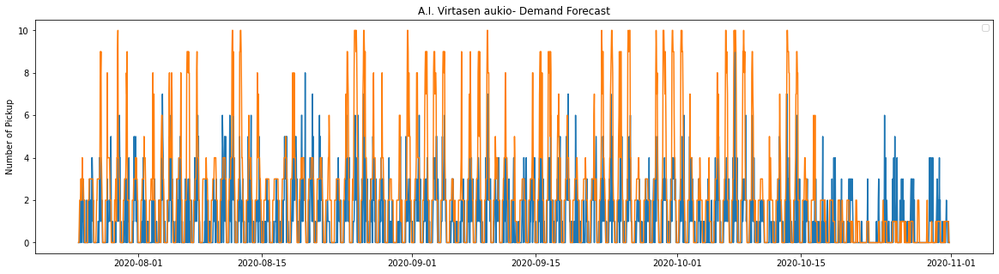

Aalto-yliopisto (M), Korkeakouluaukio total samples:  21925
Training samples:  17540
Testing samples:  4385


R-squared is: %f 0.7637436800750099
MAE is: %f 3.7507411630558725
MSE is: %f 31.73067274800456


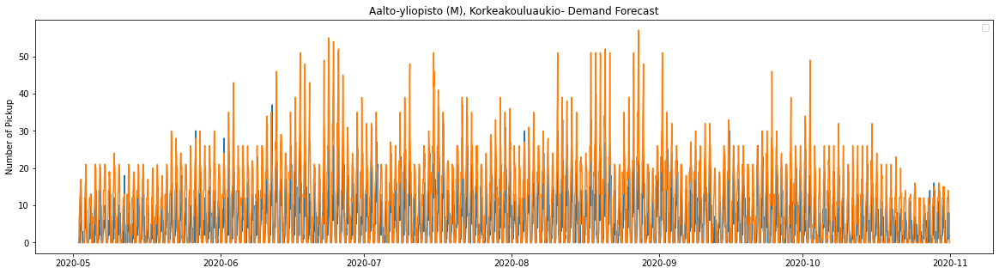

Aalto-yliopisto (M), Tietotie total samples:  21924
Training samples:  17539
Testing samples:  4385


R-squared is: %f 0.38907723388764415
MAE is: %f 1.2118586088939567
MSE is: %f 3.6045610034207525


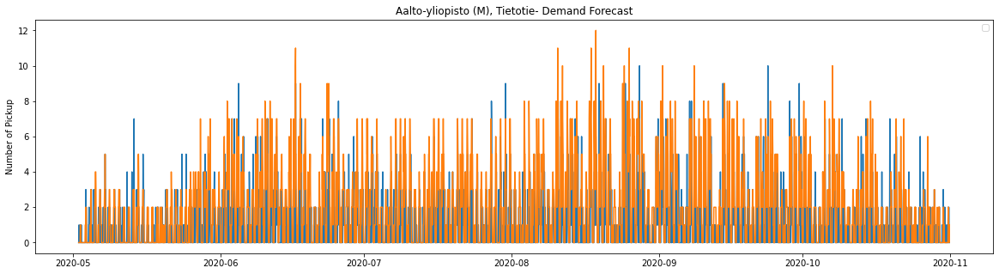

Abraham Wetterin tie total samples:  13537
Training samples:  10829
Testing samples:  2708


R-squared is: %f 0.322314004503196
MAE is: %f 0.98301329394387
MSE is: %f 2.1683899556868536


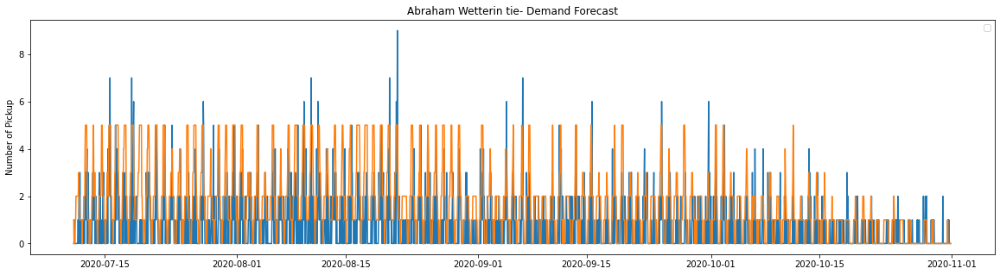

Agnetankuja total samples:  13540
Training samples:  10832
Testing samples:  2708


R-squared is: %f 0.47553827427219175
MAE is: %f 1.2714180206794683
MSE is: %f 3.733751846381093


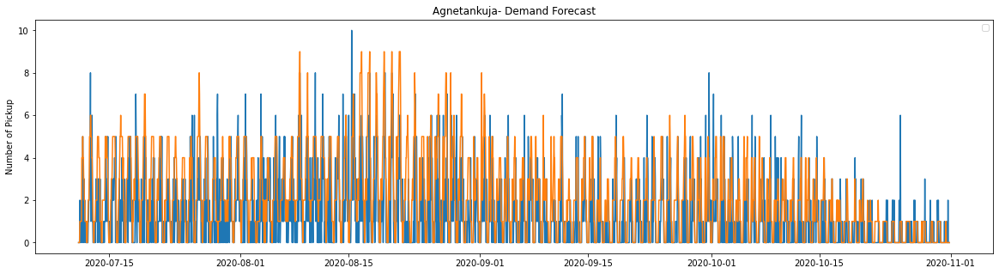

Agronominkatu total samples:  13783
Training samples:  11026
Testing samples:  2757


R-squared is: %f 0.25091423713800043
MAE is: %f 0.8132027566195139
MSE is: %f 1.6060935799782372


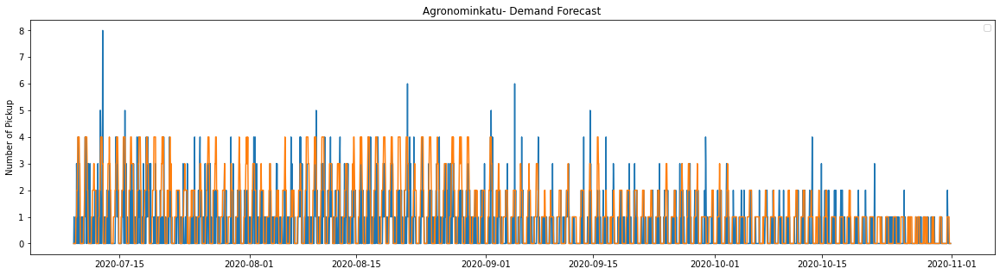

Ahertajantie total samples:  21922
Training samples:  17537
Testing samples:  4385


R-squared is: %f 0.3576027836321315
MAE is: %f 0.8237172177879133
MSE is: %f 1.8102622576966934


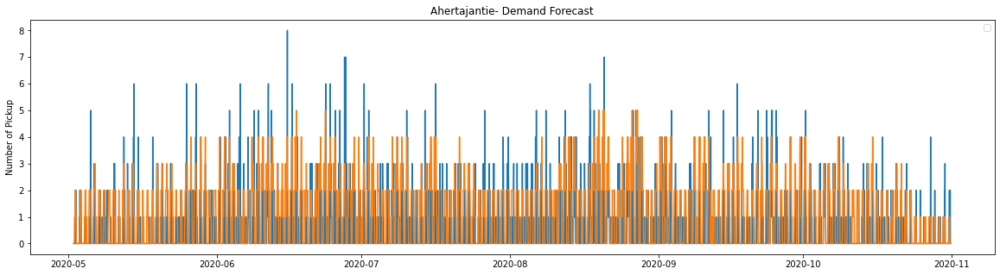

Alakiventie total samples:  13490
Training samples:  10792
Testing samples:  2698


R-squared is: %f -0.03997587329711183
MAE is: %f 0.4603409933283914
MSE is: %f 0.6063750926612306


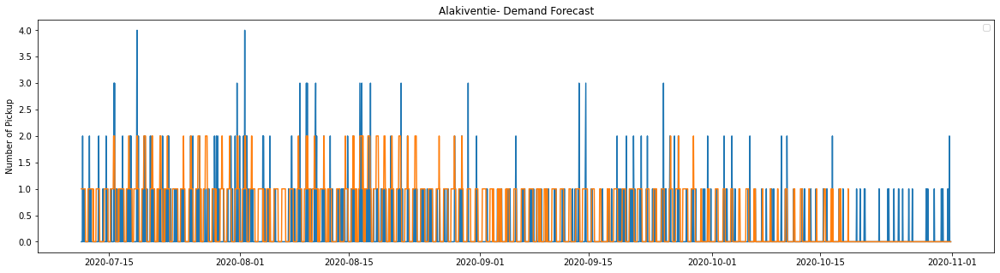

Albertinkatu total samples:  30677
Training samples:  24541
Testing samples:  6136


R-squared is: %f 0.687096052041382
MAE is: %f 2.0625814863103
MSE is: %f 9.662972620599739


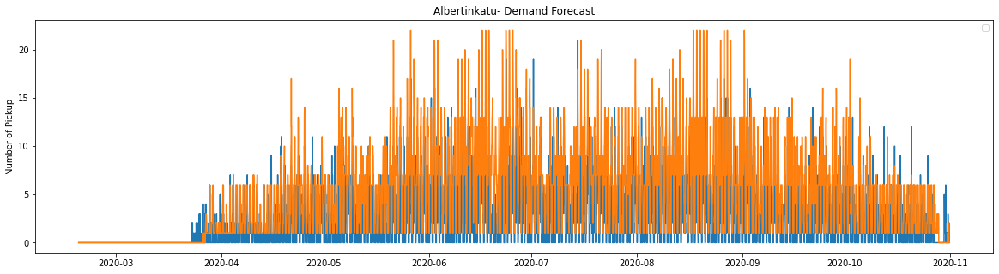

Annankatu total samples:  22397
Training samples:  17917
Testing samples:  4480


R-squared is: %f 0.5834501944961883
MAE is: %f 2.515401785714286
MSE is: %f 12.081473214285714


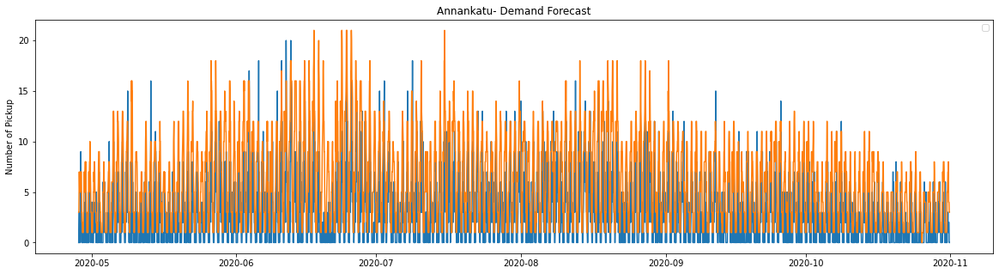

Apollonkatu total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7657045791706875
MAE is: %f 2.2527809742999616
MSE is: %f 14.96240889911776


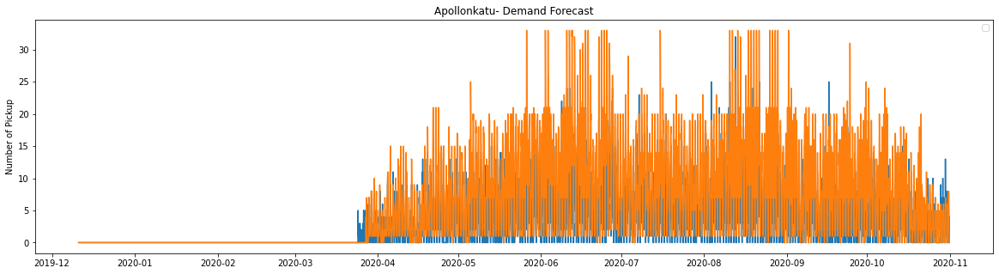

Arabian kauppakeskus total samples:  30679
Training samples:  24543
Testing samples:  6136


R-squared is: %f 0.8122214211903914
MAE is: %f 2.810136897001304
MSE is: %f 19.601857887874836


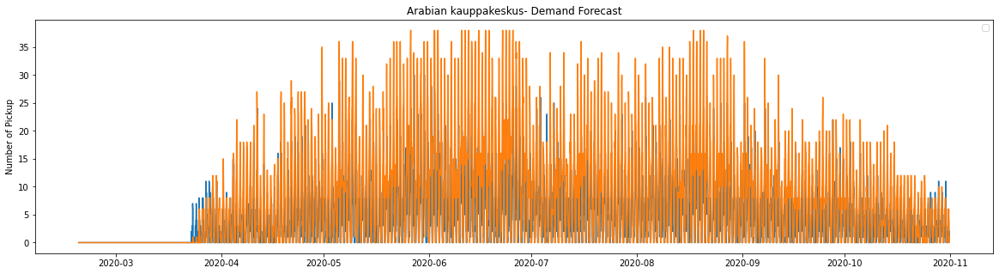

Arabiankatu total samples:  30677
Training samples:  24541
Testing samples:  6136


R-squared is: %f 0.6480603788732067
MAE is: %f 2.0177640156453718
MSE is: %f 10.820241199478488


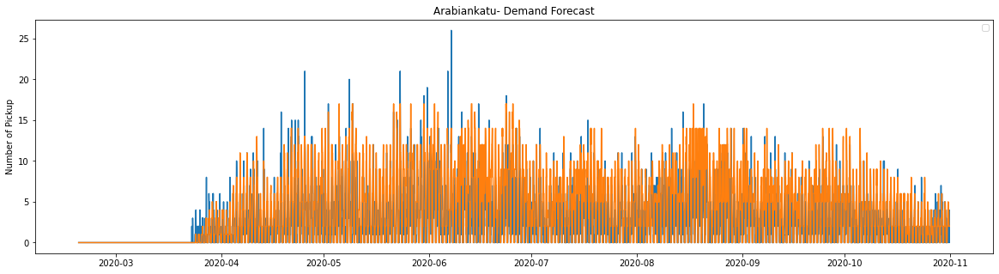

Arielinkatu total samples:  30678
Training samples:  24542
Testing samples:  6136


R-squared is: %f 0.5260977208404115
MAE is: %f 1.371903520208605
MSE is: %f 4.727835723598435


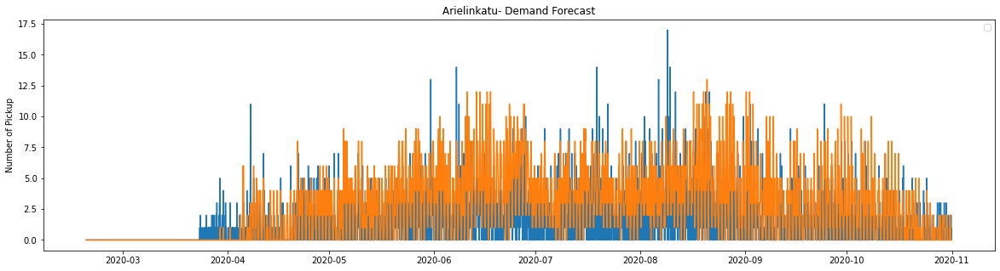

Asentajanpuisto total samples:  13541
Training samples:  10832
Testing samples:  2709


R-squared is: %f 0.21622360573638844
MAE is: %f 0.6581764488741233
MSE is: %f 1.4230343300110742


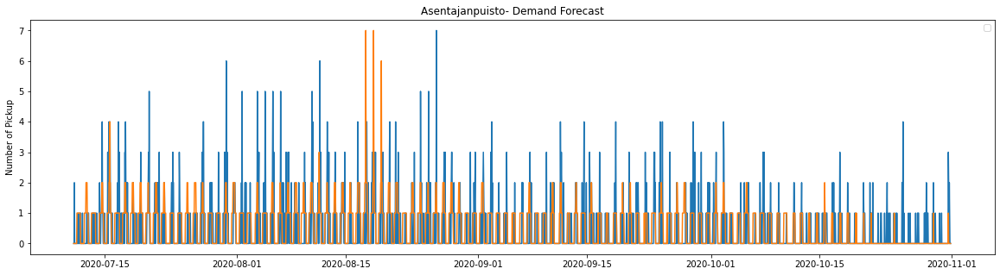

Aulangontie total samples:  13562
Training samples:  10849
Testing samples:  2713


R-squared is: %f -0.17486419863435154
MAE is: %f 0.5009214891264283
MSE is: %f 0.7714706966457796


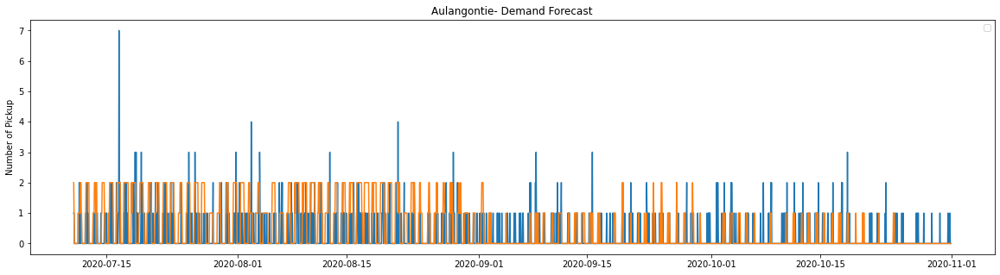

Auringonkatu total samples:  30685
Training samples:  24548
Testing samples:  6137


R-squared is: %f 0.1294635349260148
MAE is: %f 0.5315300635489653
MSE is: %f 0.8639400358481343


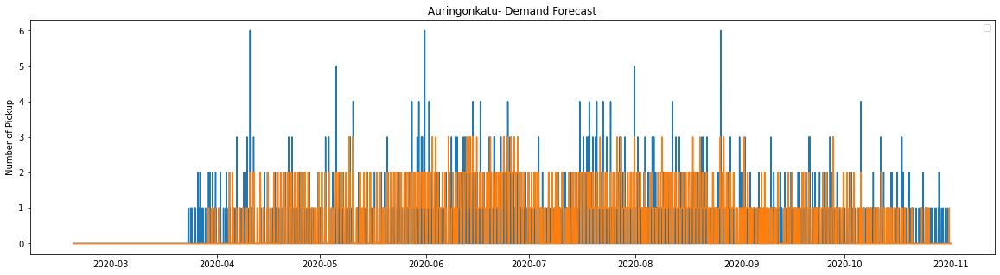

Avaruuskatu total samples:  30682
Training samples:  24545
Testing samples:  6137


R-squared is: %f 0.007567496581909694
MAE is: %f 0.4311552875998045
MSE is: %f 0.7231546358155451


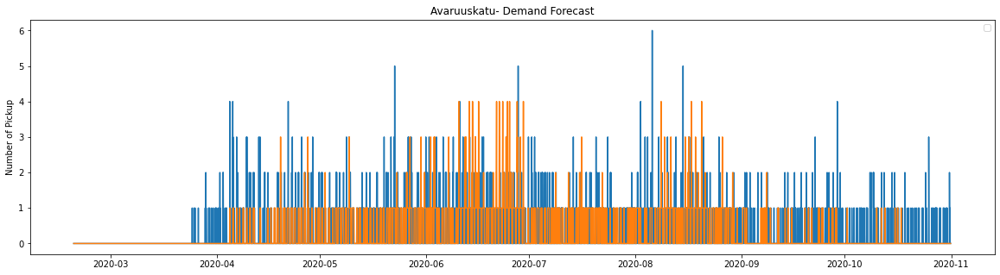

Baana total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7551438296664685
MAE is: %f 2.003196522183864
MSE is: %f 12.231811788773815


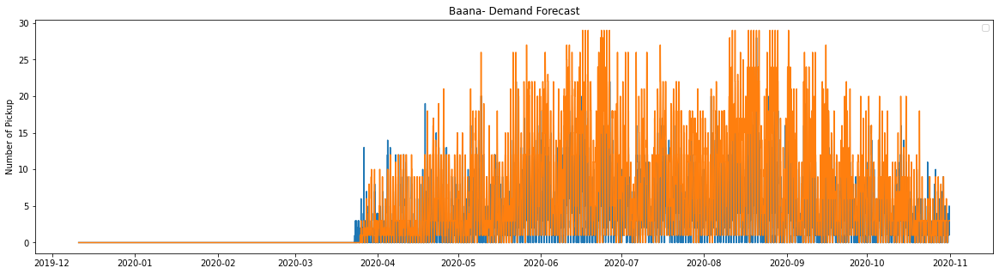

Betonimies total samples:  13785
Training samples:  11028
Testing samples:  2757


R-squared is: %f 0.23950151424228727
MAE is: %f 0.6104461371055495
MSE is: %f 1.22778382299601


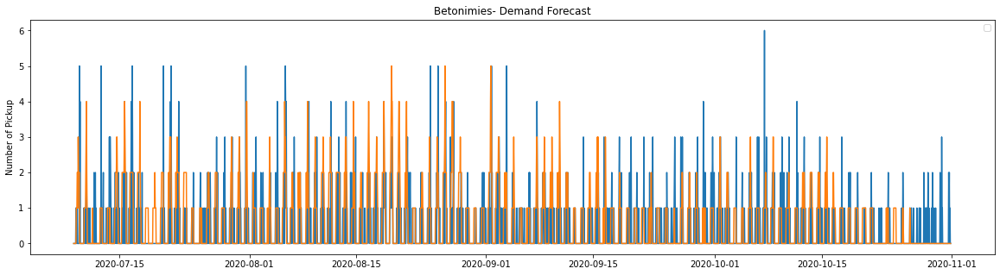

Brahen kenttä total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7620971292140535
MAE is: %f 2.001790052422964
MSE is: %f 11.325150236542642


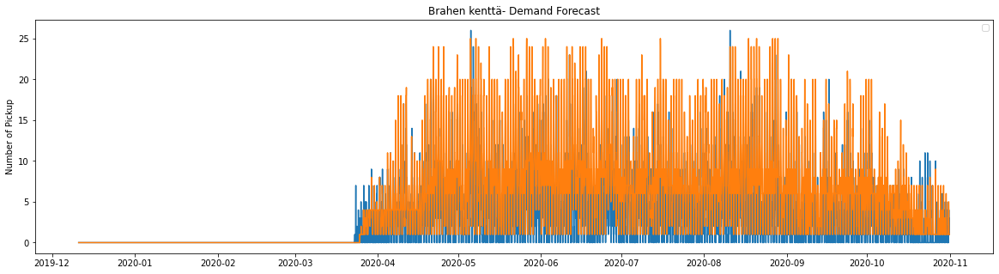

Brahen puistikko total samples:  30678
Training samples:  24542
Testing samples:  6136


R-squared is: %f 0.6426416635360908
MAE is: %f 2.0790417209908734
MSE is: %f 9.33719035202086


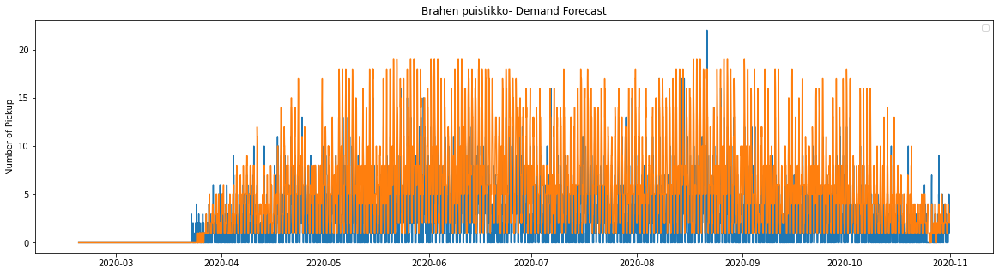

Cygnaeuksenkatu total samples:  22258
Training samples:  17806
Testing samples:  4452


R-squared is: %f 0.3157002145550726
MAE is: %f 1.6963162623539982
MSE is: %f 5.209793351302785


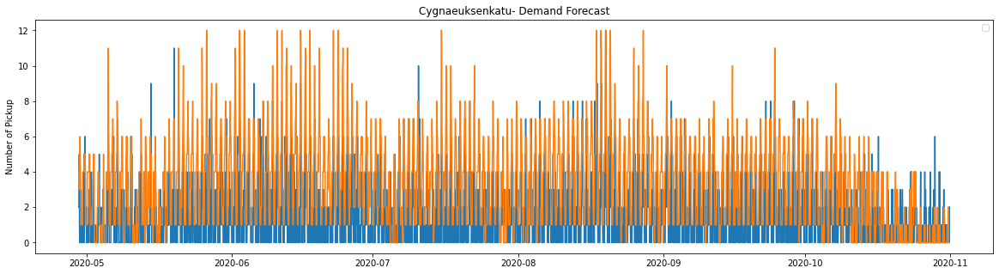

Derby Business Park total samples:  2742
Training samples:  2193
Testing samples:  549


R-squared is: %f -0.046711153479504164
MAE is: %f 0.051001821493624776
MSE is: %f 0.058287795992714025


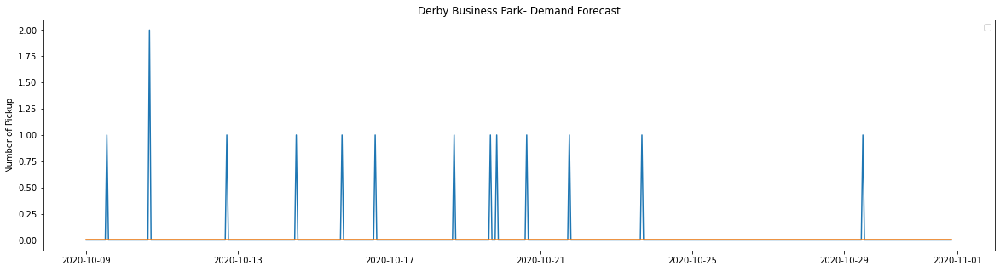

Designmuseo total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.5881609201058396
MAE is: %f 1.1361718450326046
MSE is: %f 3.918680475642501


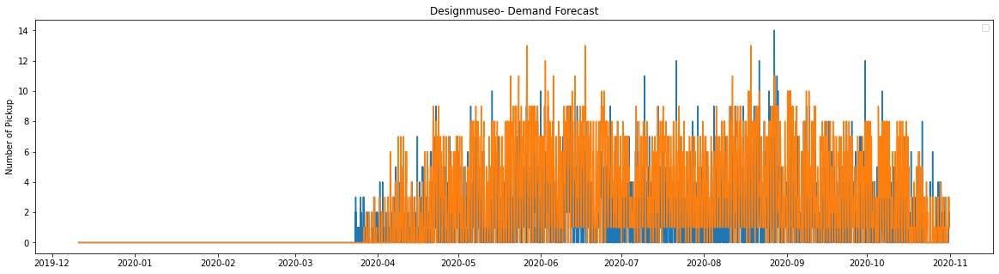

Diakoniapuisto total samples:  30676
Training samples:  24540
Testing samples:  6136


R-squared is: %f 0.4838729986273482
MAE is: %f 1.9439374185136897
MSE is: %f 11.416558018252934


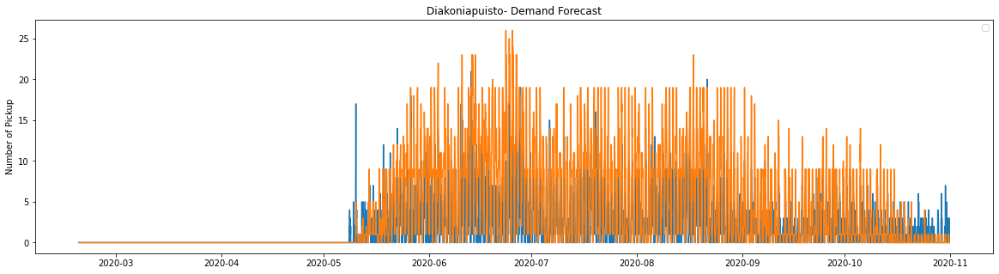

Eerikinkatu total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.555156217606011
MAE is: %f 0.8477176831607212
MSE is: %f 2.515535097813579


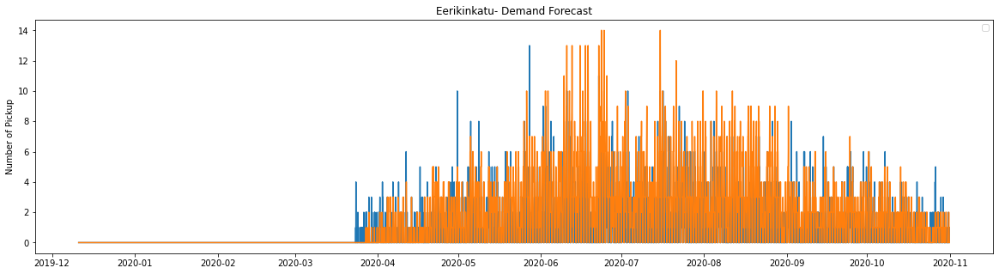

Ehrenströmintie total samples:  30678
Training samples:  24542
Testing samples:  6136


R-squared is: %f 0.617934498865131
MAE is: %f 1.398794002607562
MSE is: %f 7.342731421121251


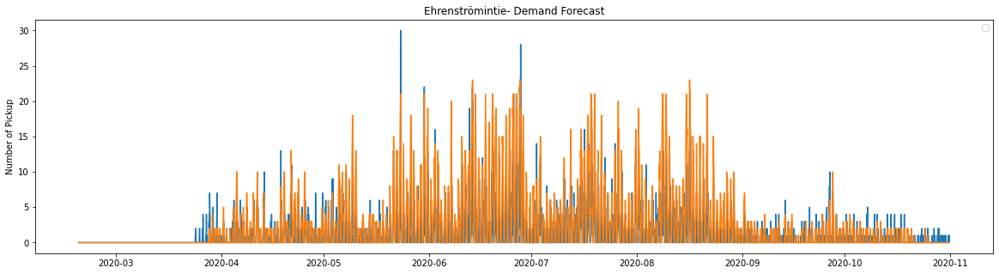

Elfvik total samples:  13807
Training samples:  11045
Testing samples:  2762


R-squared is: %f 0.10276215820165613
MAE is: %f 0.39717595944967415
MSE is: %f 0.8758146270818248


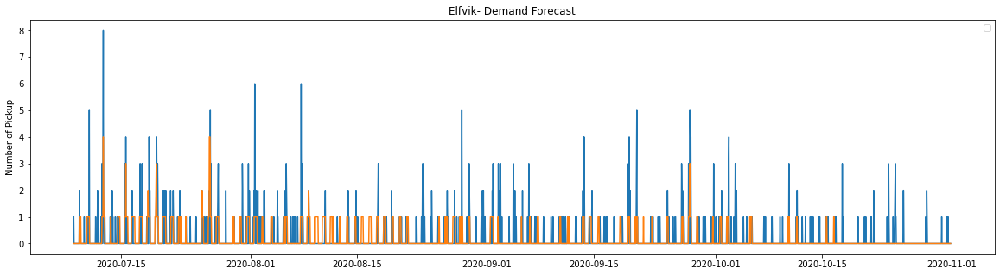

Elimäenkatu total samples:  30678
Training samples:  24542
Testing samples:  6136


R-squared is: %f 0.5852257310944324
MAE is: %f 1.3766297262059974
MSE is: %f 5.250488917861799


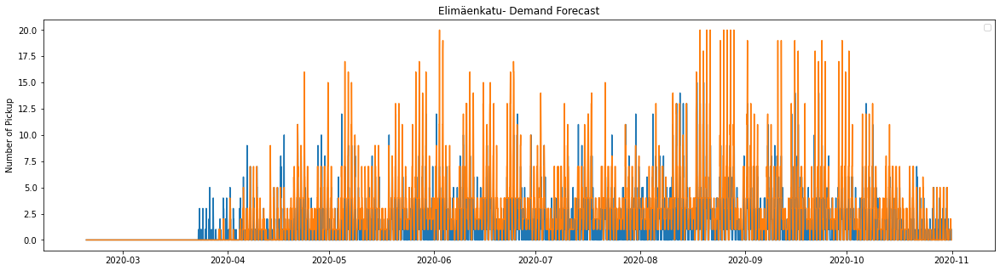

Eläinmuseo total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.6154698056935786
MAE is: %f 1.0324766653880577
MSE is: %f 3.6907045134893237


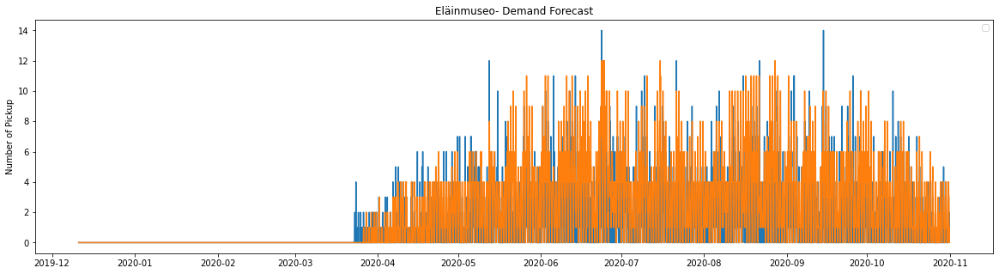

Erottajan aukio total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7515501201780564
MAE is: %f 1.9964198951540724
MSE is: %f 15.147935046669224


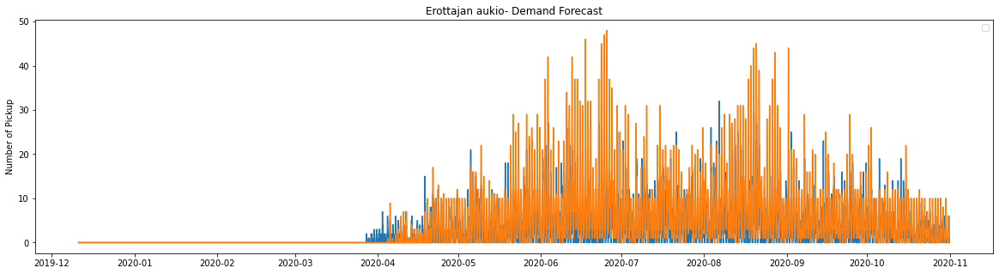

Eränkävijäntori total samples:  13495
Training samples:  10796
Testing samples:  2699


R-squared is: %f 0.2125241843870922
MAE is: %f 0.797332345313079
MSE is: %f 1.55909596146721


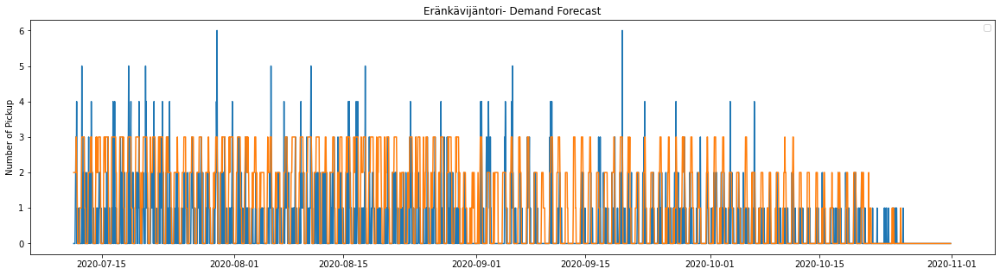

Esterinportti total samples:  30679
Training samples:  24543
Testing samples:  6136


R-squared is: %f 0.6704327924048525
MAE is: %f 1.955671447196871
MSE is: %f 9.29367666232073


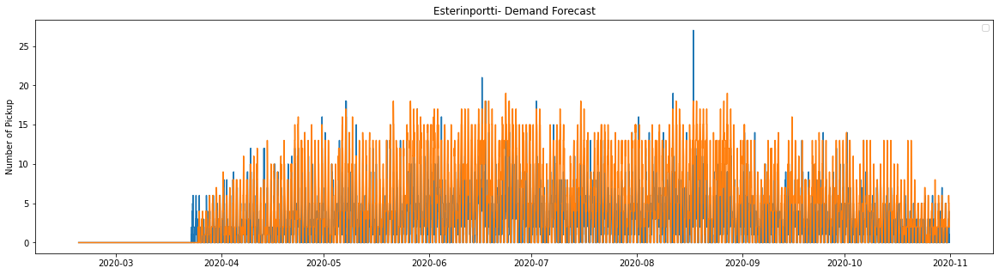

Eteläesplanadi total samples:  22373
Training samples:  17898
Testing samples:  4475


R-squared is: %f 0.4735194190580718
MAE is: %f 2.7839106145251398
MSE is: %f 23.693854748603353


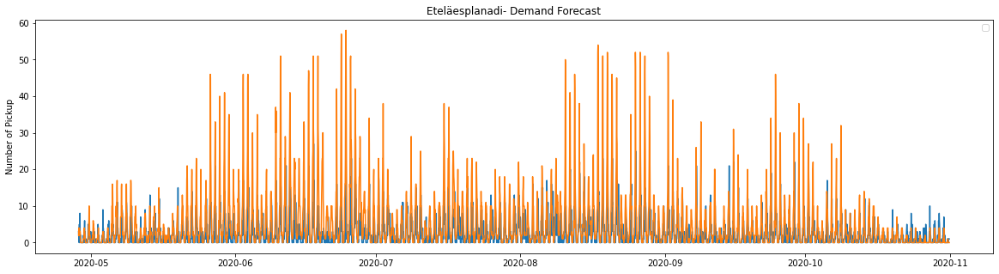

Eteläinen Hesperiankatu total samples:  30682
Training samples:  24545
Testing samples:  6137


R-squared is: %f 0.7516137699582124
MAE is: %f 2.3964477757862146
MSE is: %f 16.21851067296725


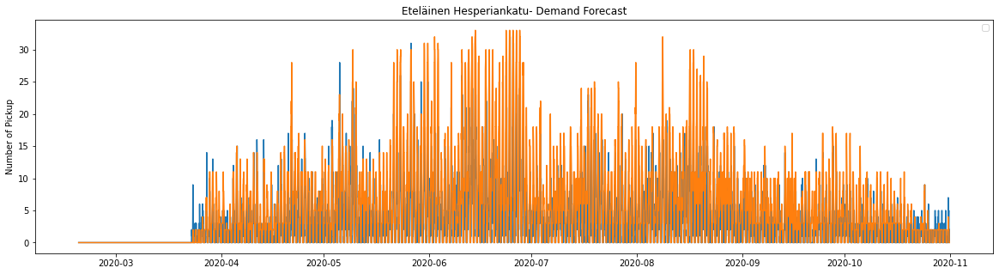

Etuniementie total samples:  30678
Training samples:  24542
Testing samples:  6136


R-squared is: %f 0.20457822919311974
MAE is: %f 0.43122555410691005
MSE is: %f 0.6678617992177314


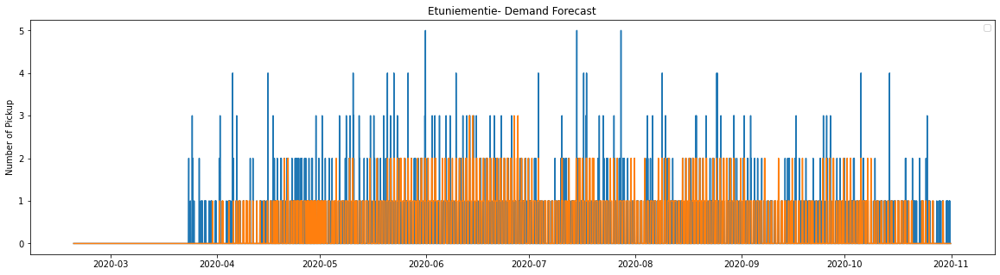

Fleminginkatu total samples:  30677
Training samples:  24541
Testing samples:  6136


R-squared is: %f 0.6806496000118956
MAE is: %f 2.3678292046936114
MSE is: %f 13.023956975228161


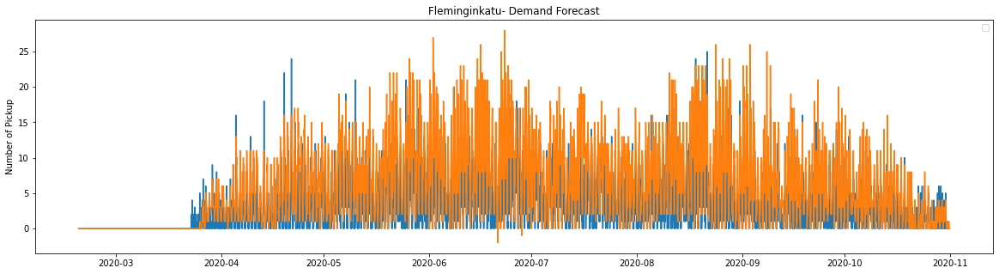

Friisilänaukio total samples:  21926
Training samples:  17540
Testing samples:  4386


R-squared is: %f 0.2934242181030444
MAE is: %f 0.7136342909256725
MSE is: %f 1.7282261741906064


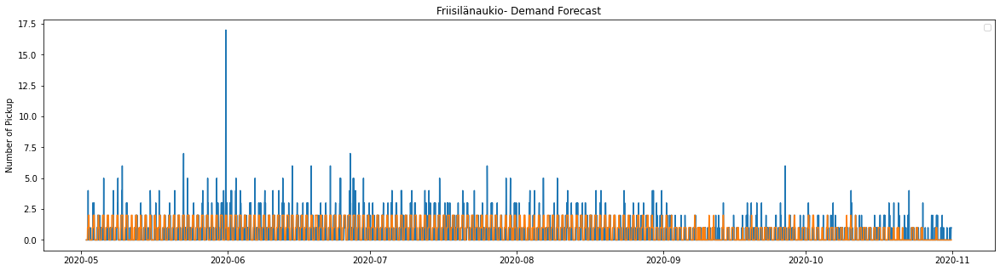

Gallen-Kallelan tie total samples:  20044
Training samples:  16035
Testing samples:  4009


R-squared is: %f 0.4814252999618781
MAE is: %f 0.9770516338238963
MSE is: %f 3.571713644300324


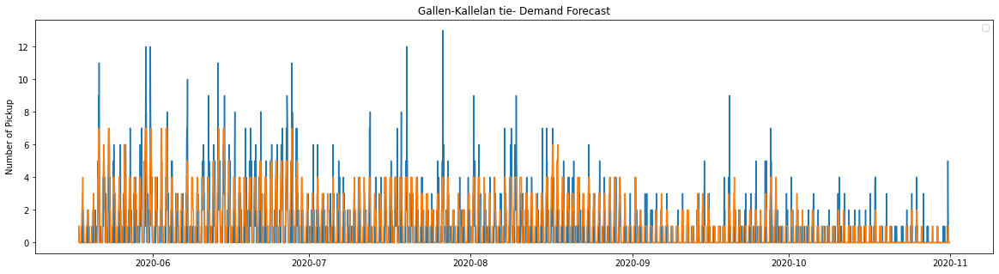

Gebhardinaukio total samples:  30677
Training samples:  24541
Testing samples:  6136


R-squared is: %f 0.46258895662884414
MAE is: %f 1.518089960886571
MSE is: %f 5.486147327249022


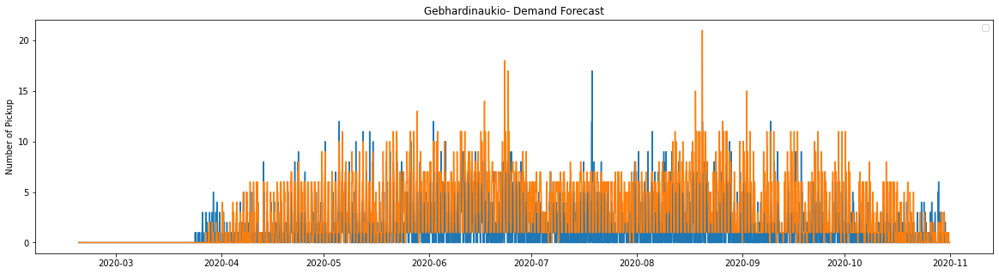

Golfpolku total samples:  21916
Training samples:  17532
Testing samples:  4384


R-squared is: %f 0.14120643348677953
MAE is: %f 0.5237226277372263
MSE is: %f 0.9256386861313869


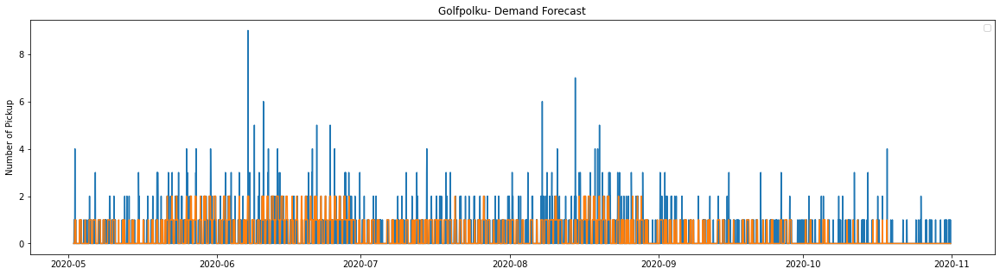

Gransinmäki total samples:  19904
Training samples:  15923
Testing samples:  3981


R-squared is: %f -0.09143196670338072
MAE is: %f 0.2793268023109771
MSE is: %f 0.4325546345139412


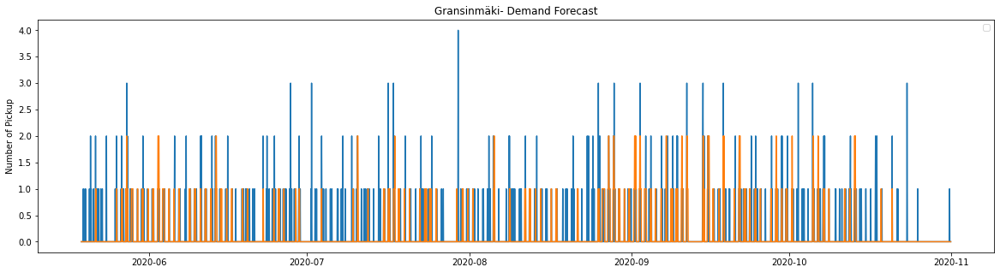

Gunillantie total samples:  13494
Training samples:  10795
Testing samples:  2699


R-squared is: %f 0.2149091951813259
MAE is: %f 0.652463875509448
MSE is: %f 1.3297517599110782


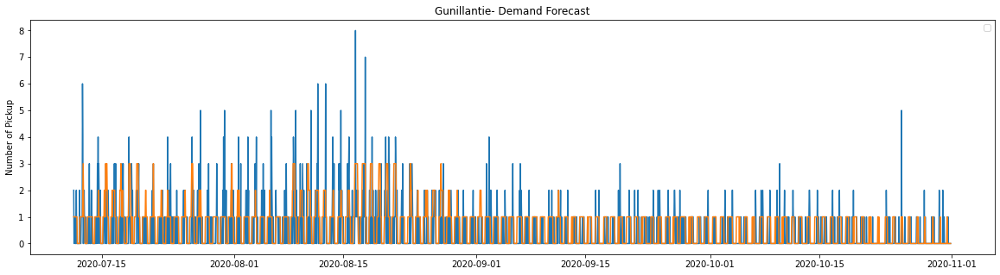

Gyldenintie total samples:  30007
Training samples:  24005
Testing samples:  6002


R-squared is: %f 0.6540640245472373
MAE is: %f 2.3357214261912698
MSE is: %f 13.922192602465845


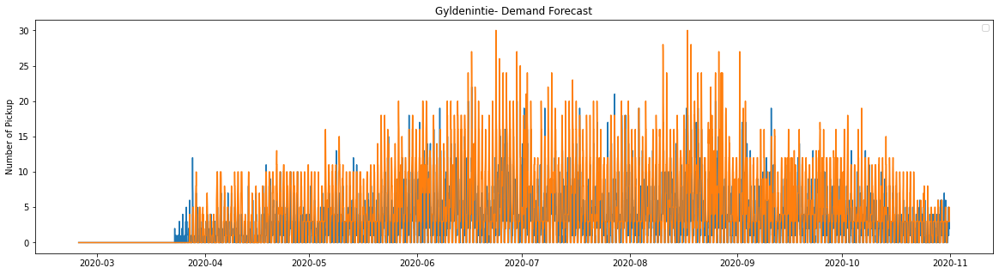

Haagan tori total samples:  13539
Training samples:  10831
Testing samples:  2708


R-squared is: %f 0.5017170690745754
MAE is: %f 1.286927621861152
MSE is: %f 3.750738552437223


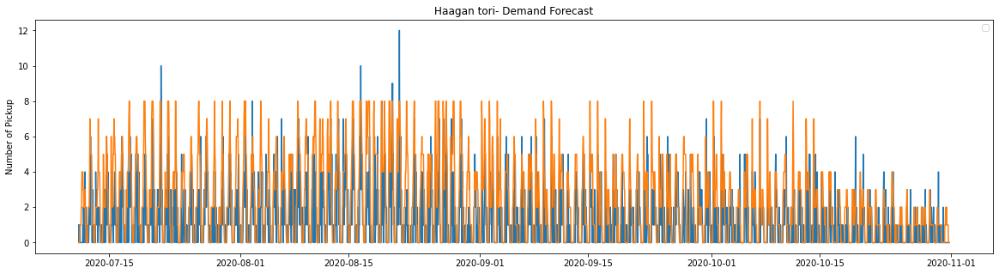

Haakoninlahdenkatu total samples:  13494
Training samples:  10795
Testing samples:  2699


R-squared is: %f 0.08091669581858996
MAE is: %f 0.3908855131530196
MSE is: %f 0.6650611337532419


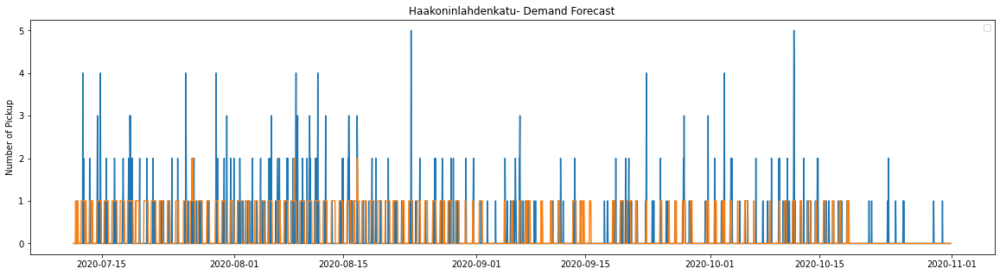

Haapaniemenkatu total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.46661157428083744
MAE is: %f 0.8336529855517197
MSE is: %f 2.219409282700422


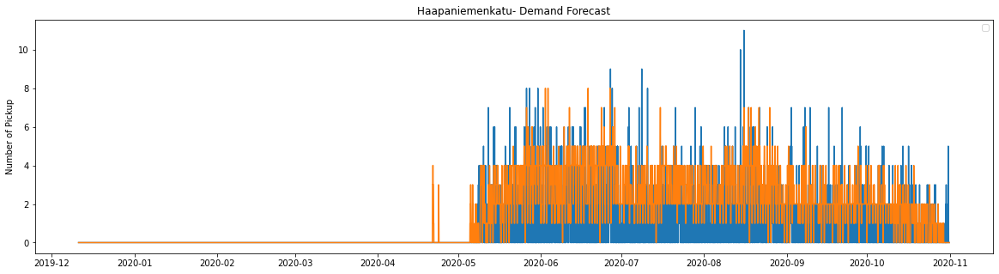

Hagalundinpuisto total samples:  13379
Training samples:  10703
Testing samples:  2676


R-squared is: %f -0.17755857309038836
MAE is: %f 0.16890881913303438
MSE is: %f 0.23692077727952168


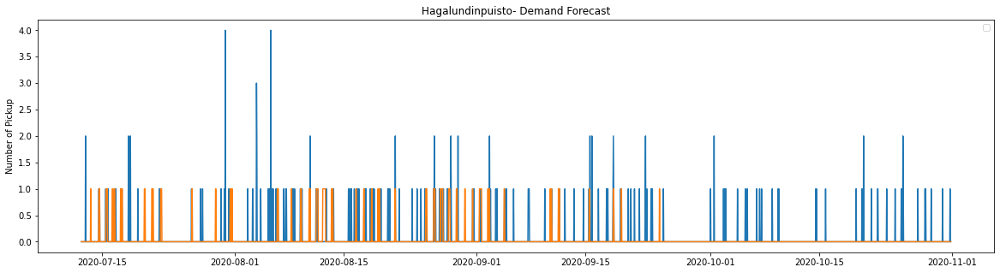

Hakalehto total samples:  21923
Training samples:  17538
Testing samples:  4385


R-squared is: %f 0.3382646008185184
MAE is: %f 1.0645381984036488
MSE is: %f 2.501254275940707


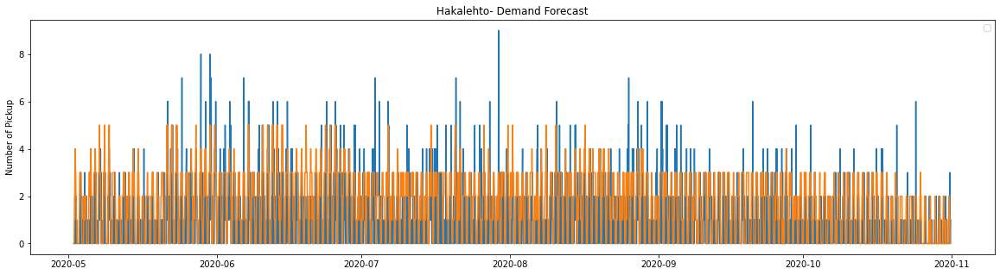

Hakaniemi (M) total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7626916118279555
MAE is: %f 2.075310062651835
MSE is: %f 12.752205600306866


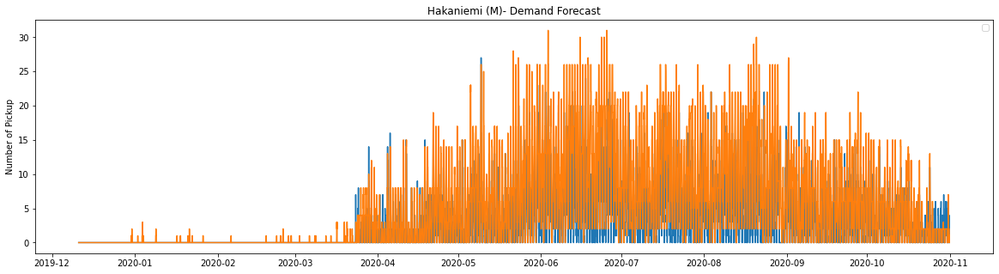

Hanasaari total samples:  19782
Training samples:  15825
Testing samples:  3957


R-squared is: %f 0.4699252094589971
MAE is: %f 1.1372251705837755
MSE is: %f 4.190548395248926


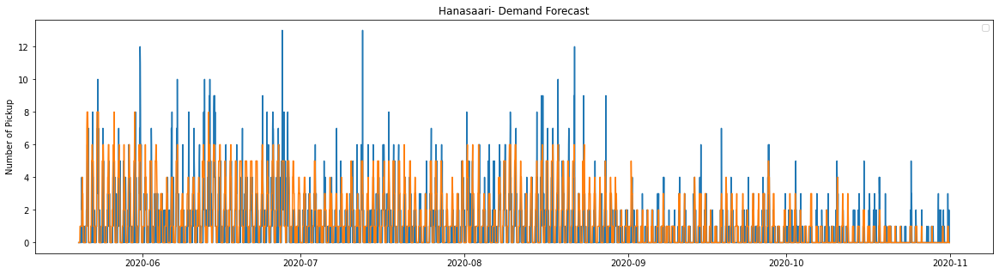

Hauenkallio total samples:  21920
Training samples:  17536
Testing samples:  4384


R-squared is: %f 0.10507046548748356
MAE is: %f 0.583257299270073
MSE is: %f 0.9185675182481752


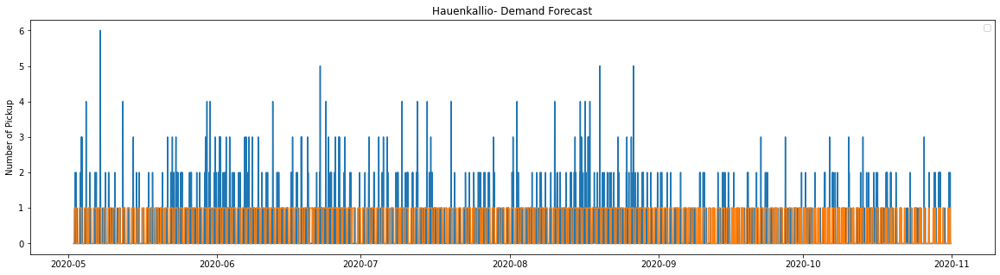

Hauenkalliontie total samples:  21923
Training samples:  17538
Testing samples:  4385


R-squared is: %f 0.31864417189261995
MAE is: %f 0.8305587229190422
MSE is: %f 1.7701254275940708


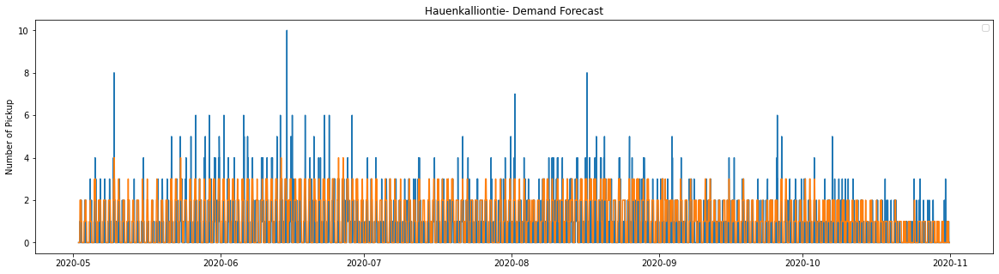

Haukilahdenaukio total samples:  21916
Training samples:  17532
Testing samples:  4384


R-squared is: %f 0.40437700242954844
MAE is: %f 1.062271897810219
MSE is: %f 3.0672901459854014


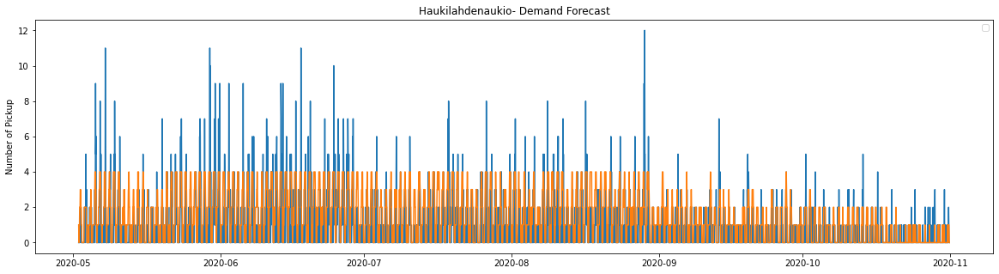

Haukilahdenkatu total samples:  30676
Training samples:  24540
Testing samples:  6136


R-squared is: %f 0.7487904502529379
MAE is: %f 2.279009126466754
MSE is: %f 12.810951760104302


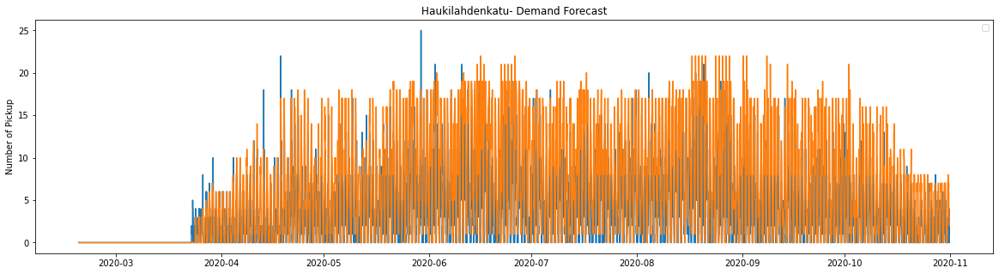

Haukilahdenranta total samples:  21926
Training samples:  17540
Testing samples:  4386


R-squared is: %f 0.4032214364307234
MAE is: %f 0.8839489284085728
MSE is: %f 2.7690378476972186


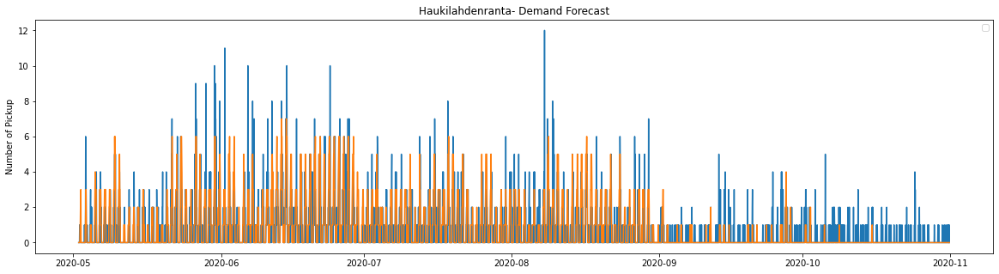

Heikkilänaukio total samples:  30678
Training samples:  24542
Testing samples:  6136


R-squared is: %f 0.6841892199334774
MAE is: %f 1.5721968709256844
MSE is: %f 6.8127444589309


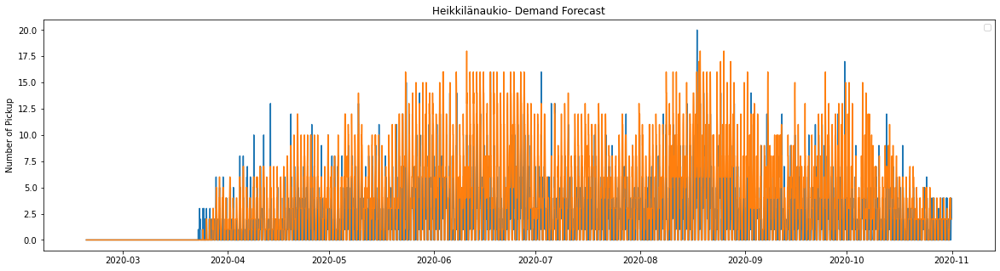

Heikkiläntie total samples:  30677
Training samples:  24541
Testing samples:  6136


R-squared is: %f 0.6530509973761334
MAE is: %f 1.595664928292047
MSE is: %f 6.145208604954368


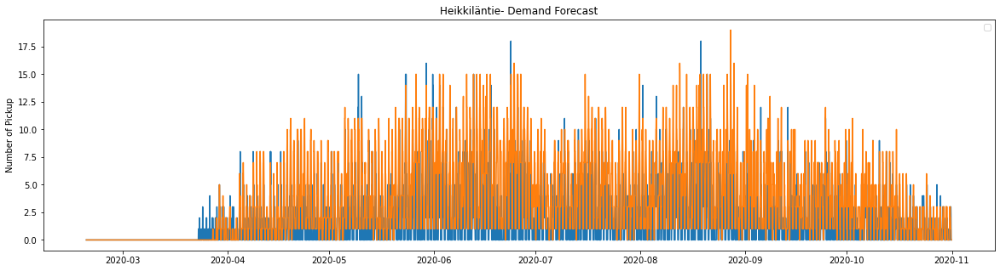

Hernepellontie total samples:  13637
Training samples:  10909
Testing samples:  2728


R-squared is: %f 0.2892105894648873
MAE is: %f 0.6869501466275659
MSE is: %f 1.2016129032258065


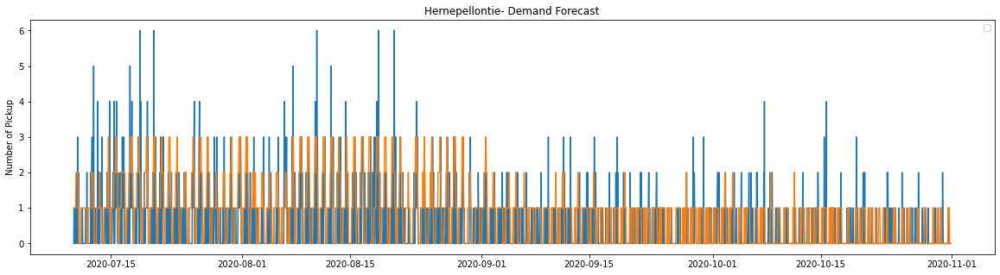

Hernesaarenranta total samples:  30680
Training samples:  24544
Testing samples:  6136


R-squared is: %f 0.682770660182859
MAE is: %f 2.0022816166883963
MSE is: %f 13.28748370273794


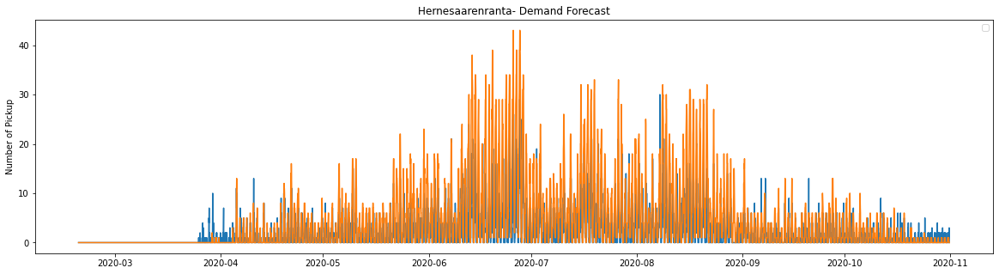

Hertanmäenkatu total samples:  30679
Training samples:  24543
Testing samples:  6136


R-squared is: %f 0.4167498533767846
MAE is: %f 1.1225554106910038
MSE is: %f 3.529335071707953


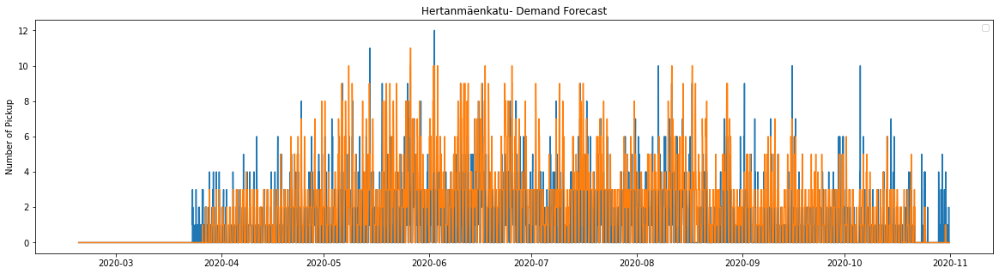

Herttoniemen kirkko total samples:  13525
Training samples:  10820
Testing samples:  2705


R-squared is: %f 0.09401881159837933
MAE is: %f 0.6354898336414048
MSE is: %f 1.077634011090573


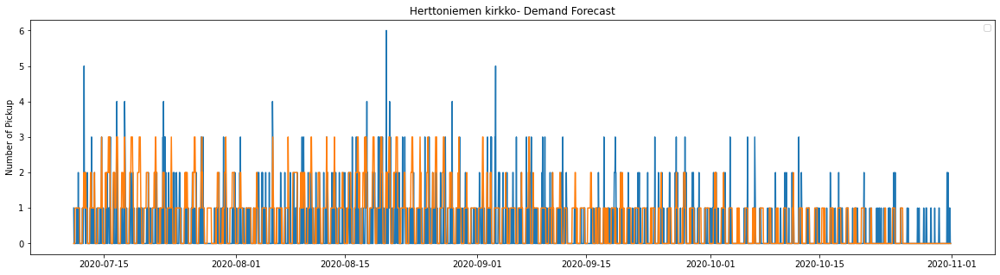

Herttoniemenranta total samples:  13538
Training samples:  10830
Testing samples:  2708


R-squared is: %f 0.36645942602870185
MAE is: %f 1.144387001477105
MSE is: %f 2.889586410635155


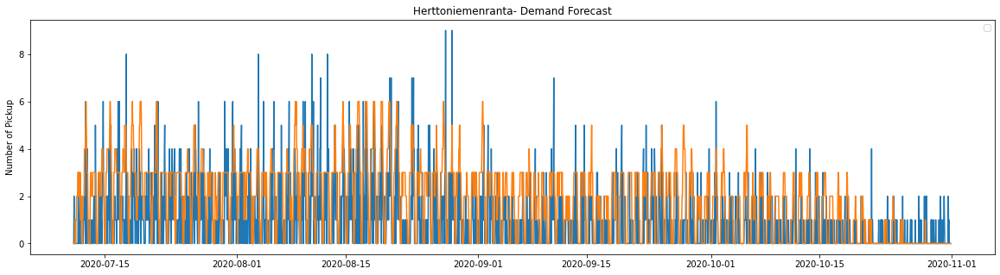

Herttoniemi (M) total samples:  13542
Training samples:  10833
Testing samples:  2709


R-squared is: %f 0.5511834390760719
MAE is: %f 1.8106312292358804
MSE is: %f 6.8124769287559985


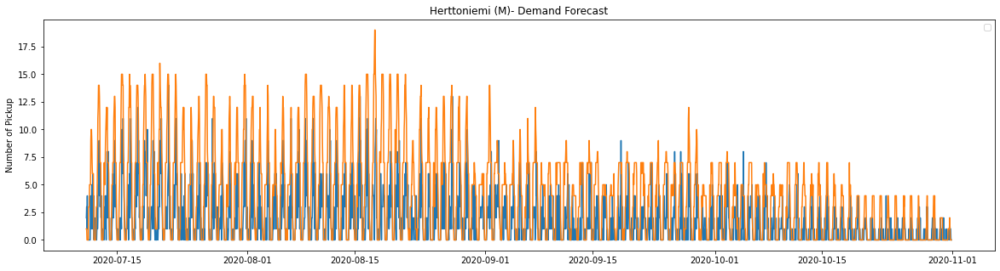

Hietalahdentori total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7780319575128982
MAE is: %f 2.297915867536121
MSE is: %f 15.833269402889655


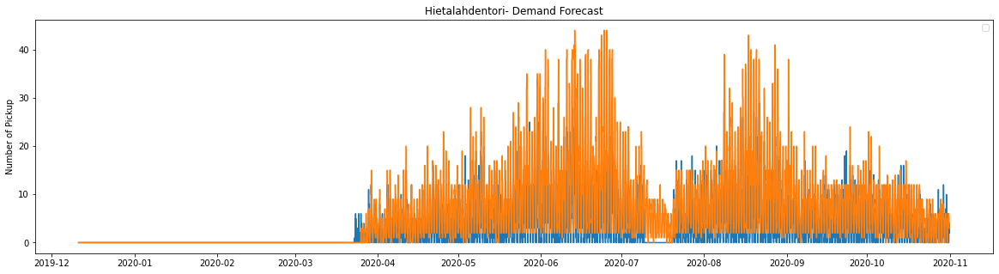

Hietaniemenkatu total samples:  30673
Training samples:  24538
Testing samples:  6135


R-squared is: %f 0.7509877734742307
MAE is: %f 3.0596577017114917
MSE is: %f 45.5639771801141


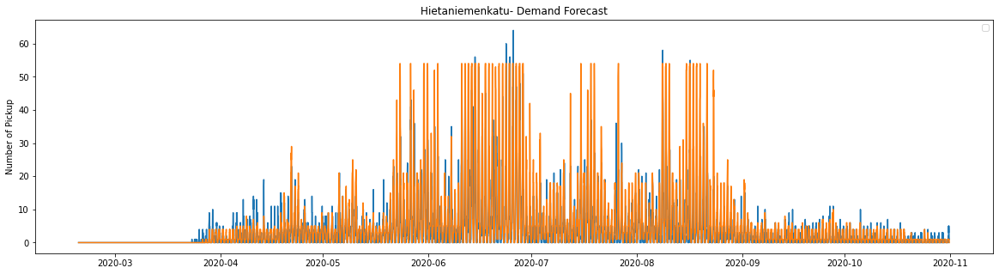

Hollolantie total samples:  22416
Training samples:  17932
Testing samples:  4484


R-squared is: %f 0.4207396955020588
MAE is: %f 1.3911685994647636
MSE is: %f 3.8336306868867083


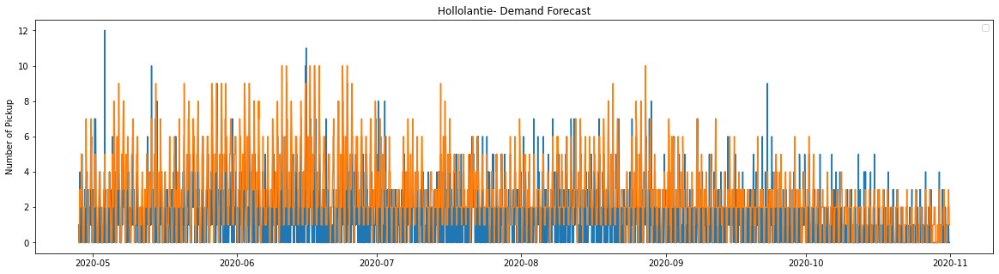

Humalniementie total samples:  13491
Training samples:  10792
Testing samples:  2699


R-squared is: %f 0.16554856114278793
MAE is: %f 0.4964801778436458
MSE is: %f 0.7454612819562801


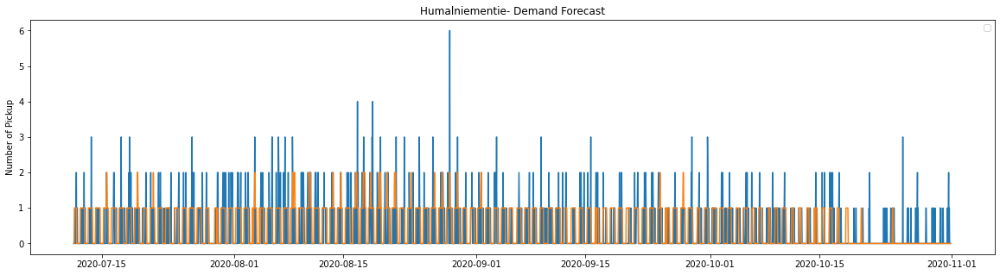

Huopalahden asema total samples:  13564
Training samples:  10851
Testing samples:  2713


R-squared is: %f 0.4651014660078838
MAE is: %f 1.1577589384445264
MSE is: %f 2.9402875046074457


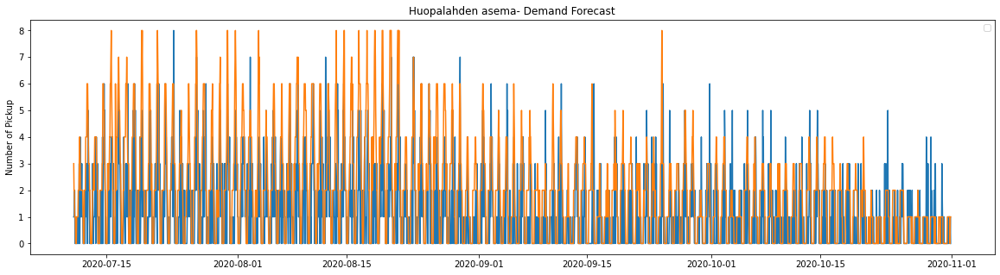

Huopalahdentie total samples:  30677
Training samples:  24541
Testing samples:  6136


R-squared is: %f 0.742406849399889
MAE is: %f 2.666232073011734
MSE is: %f 16.142764015645373


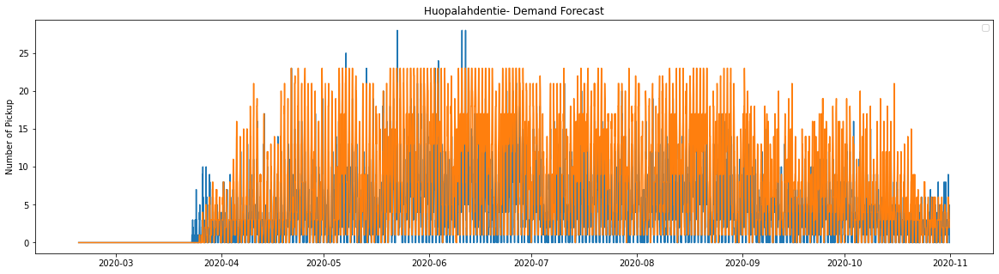

Huovitie total samples:  13543
Training samples:  10834
Testing samples:  2709


R-squared is: %f 0.18165839657805583
MAE is: %f 0.7128091546696198
MSE is: %f 1.372093023255814


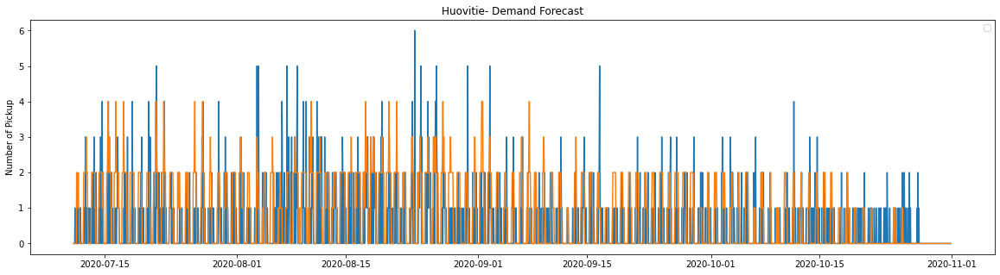

Hämeenlinnanväylä total samples:  13537
Training samples:  10829
Testing samples:  2708


R-squared is: %f 0.1450814021096859
MAE is: %f 0.7507385524372231
MSE is: %f 1.56314623338257


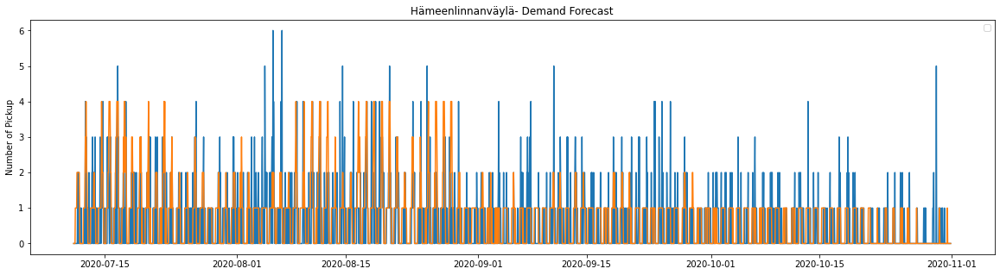

Ida Aalbergin tie total samples:  13571
Training samples:  10856
Testing samples:  2715


R-squared is: %f 0.07013349133499924
MAE is: %f 0.6478821362799263
MSE is: %f 1.1731123388581952


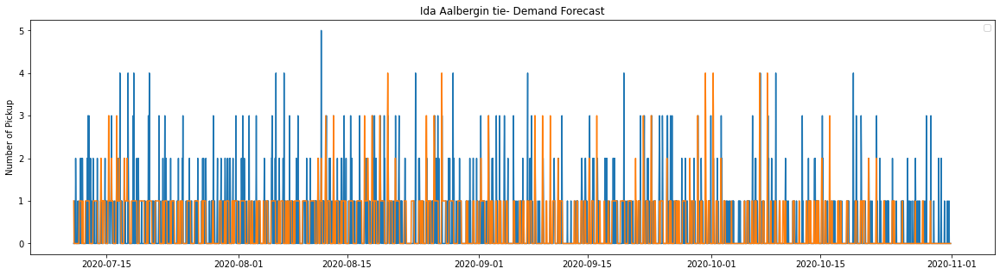

Ilmalan asema total samples:  13467
Training samples:  10773
Testing samples:  2694


R-squared is: %f 0.4146189477090404
MAE is: %f 0.8548626577579806
MSE is: %f 2.181514476614699


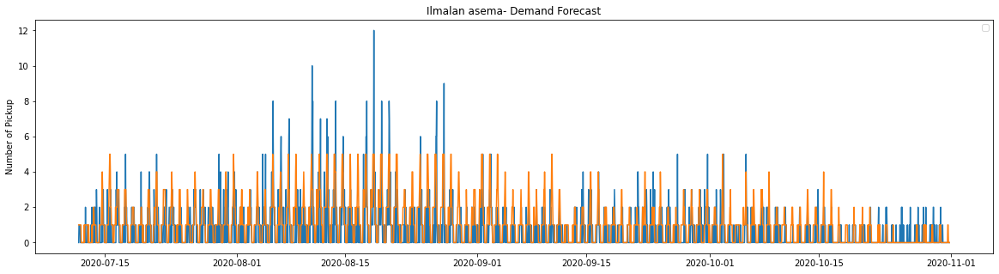

Innopoli total samples:  21920
Training samples:  17536
Testing samples:  4384


R-squared is: %f -0.0616674419588108
MAE is: %f 0.4317974452554745
MSE is: %f 0.8359945255474452


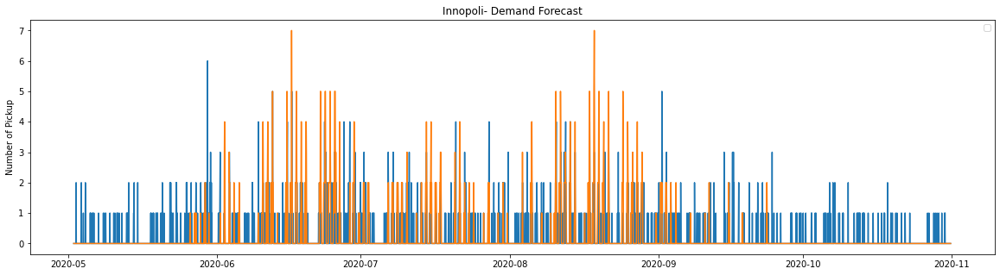

Intiankatu total samples:  30678
Training samples:  24542
Testing samples:  6136


R-squared is: %f 0.6089854023307164
MAE is: %f 1.7035528031290743
MSE is: %f 6.63086701434159


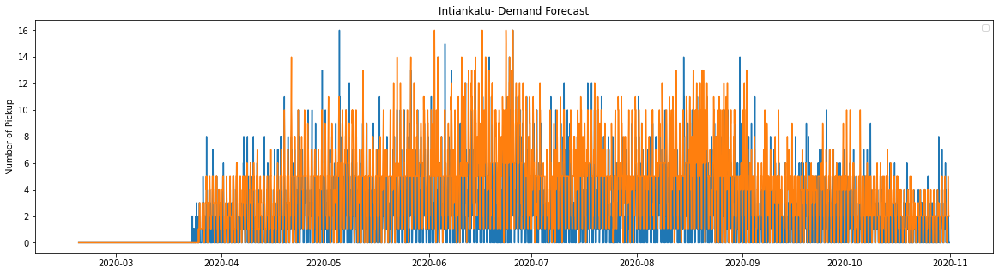

Isoisänsilta total samples:  22300
Training samples:  17840
Testing samples:  4460


R-squared is: %f 0.5813577100986618
MAE is: %f 4.4269058295964125
MSE is: %f 65.09282511210762


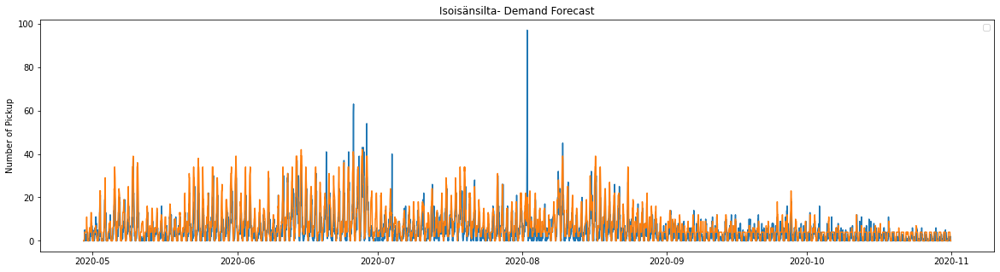

Isosaarentie total samples:  13497
Training samples:  10797
Testing samples:  2700


R-squared is: %f 0.11895962446100583
MAE is: %f 0.585925925925926
MSE is: %f 1.0148148148148148


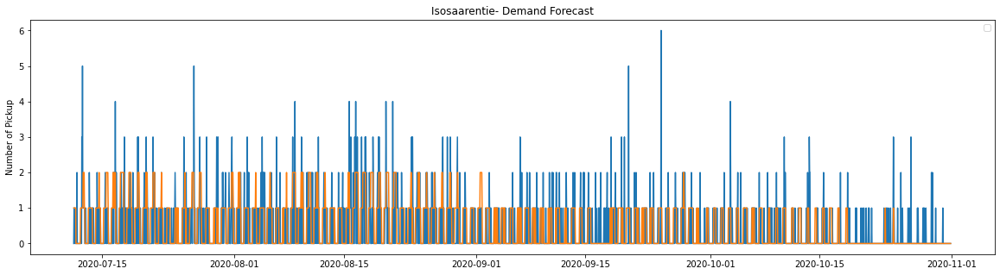

Itäkeskus (M) total samples:  13516
Training samples:  10812
Testing samples:  2704


R-squared is: %f 0.5349666477113741
MAE is: %f 1.4127218934911243
MSE is: %f 4.509615384615385


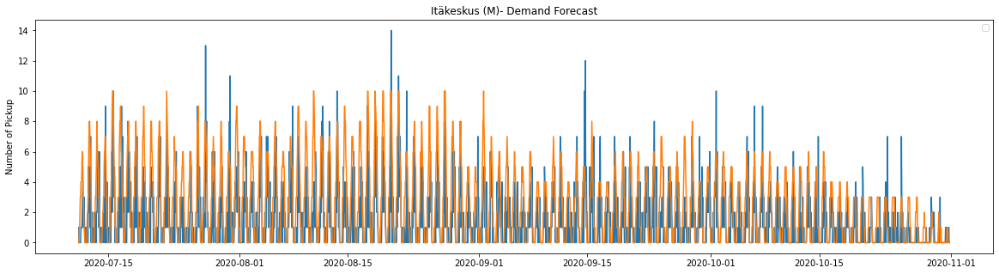

Itäkeskus Metrovarikko total samples:  10646
Training samples:  8516
Testing samples:  2130


R-squared is: %f 0.036802006759742656
MAE is: %f 0.4032863849765258
MSE is: %f 0.6821596244131456


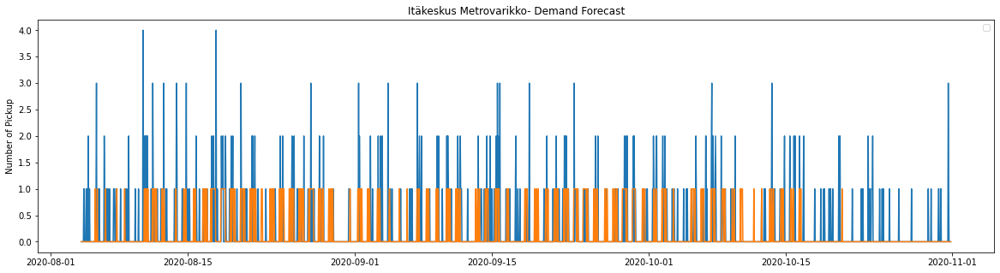

Itälahdenkatu total samples:  30681
Training samples:  24544
Testing samples:  6137


R-squared is: %f 0.5619476385945701
MAE is: %f 1.4608114714029656
MSE is: %f 5.414534788984846


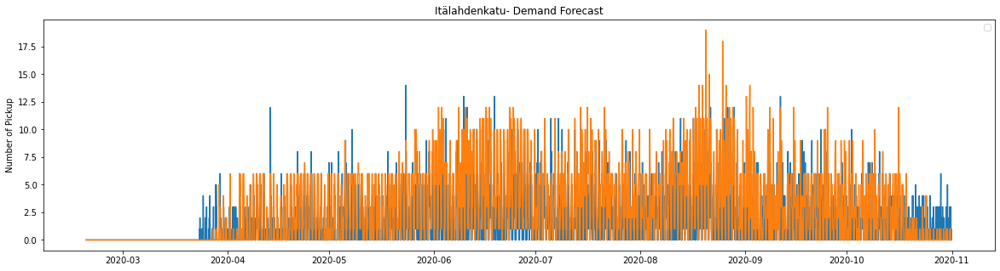

Itämerentori total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.8275103431886055
MAE is: %f 4.198312236286919
MSE is: %f 53.06520905255083


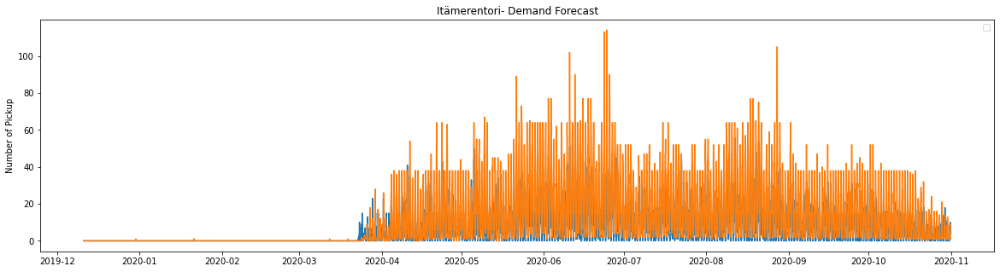

Itäportti total samples:  21921
Training samples:  17536
Testing samples:  4385


R-squared is: %f 0.10532747800252307
MAE is: %f 0.6148232611174458
MSE is: %f 0.9309007981755987


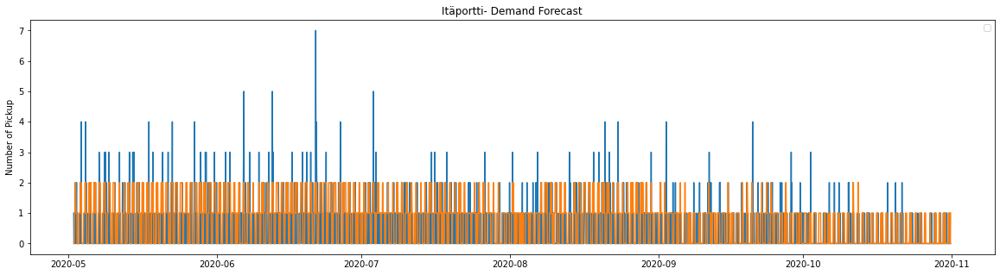

Jalavatie total samples:  30678
Training samples:  24542
Testing samples:  6136


R-squared is: %f 0.5708661641437927
MAE is: %f 1.419328552803129
MSE is: %f 4.645208604954368


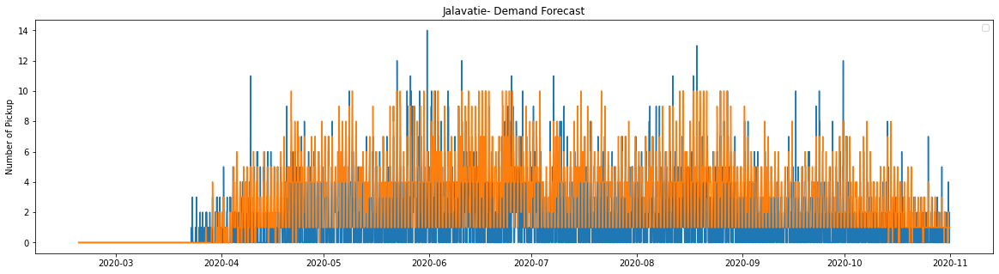

Juhana Herttuan tie total samples:  30680
Training samples:  24544
Testing samples:  6136


R-squared is: %f 0.4908592813266561
MAE is: %f 1.2654823989569752
MSE is: %f 4.192796610169491


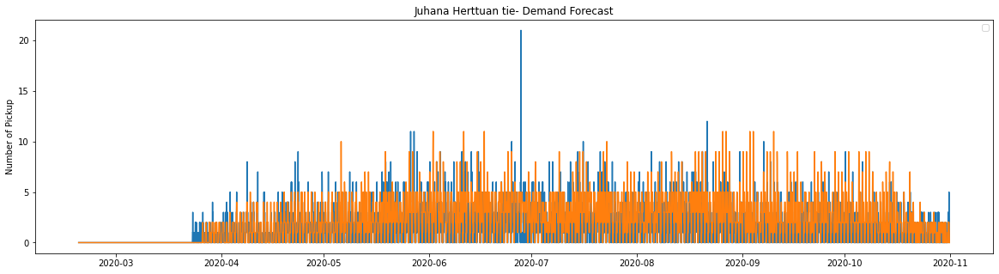

Jämeräntaival total samples:  21925
Training samples:  17540
Testing samples:  4385


R-squared is: %f 0.6200839282381116
MAE is: %f 3.2253135689851766
MSE is: %f 19.519498289623716


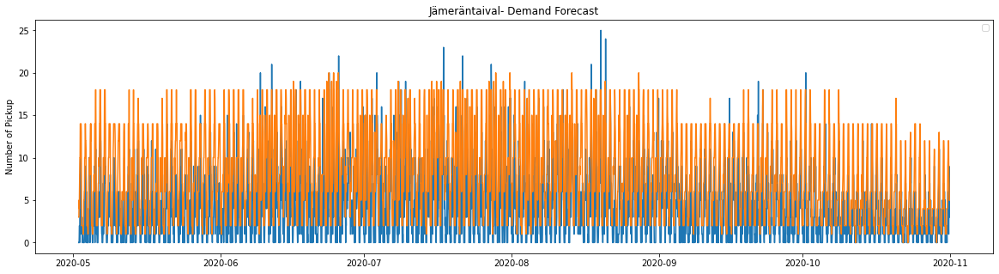

Jännetie total samples:  13466
Training samples:  10772
Testing samples:  2694


R-squared is: %f 0.28332119708216574
MAE is: %f 1.123236822568671
MSE is: %f 2.308092056421678


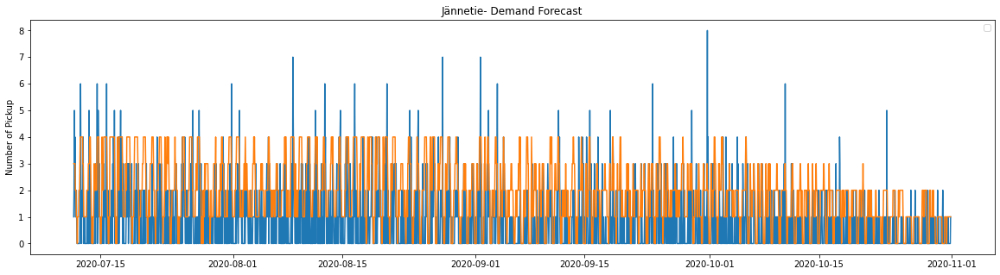

Jätkäsaarenlaituri total samples:  30681
Training samples:  24544
Testing samples:  6137


R-squared is: %f 0.7165757444070506
MAE is: %f 2.729183640215089
MSE is: %f 16.69952745641193


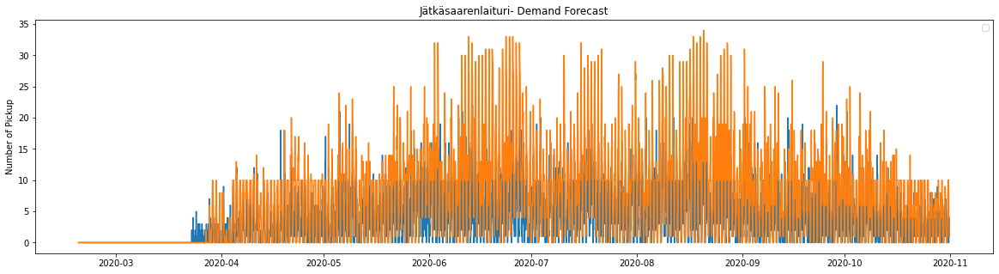

Jäähalli total samples:  30681
Training samples:  24544
Testing samples:  6137


R-squared is: %f 0.6134041351420316
MAE is: %f 2.007984357177774
MSE is: %f 10.657487371679974


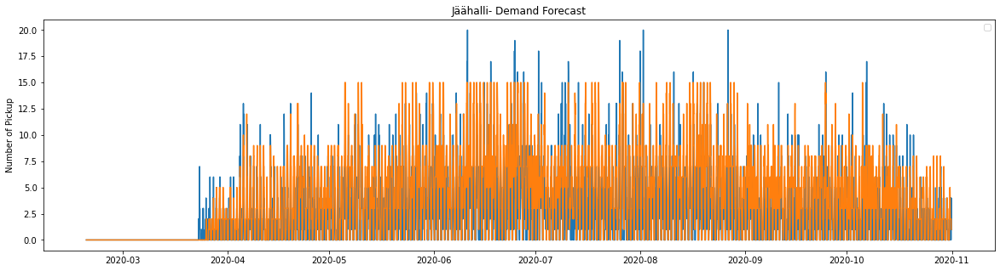

Kaapelitehdas total samples:  4064
Training samples:  3251
Testing samples:  813


R-squared is: %f 0.5525433139793602
MAE is: %f 1.5867158671586716
MSE is: %f 6.115621156211562


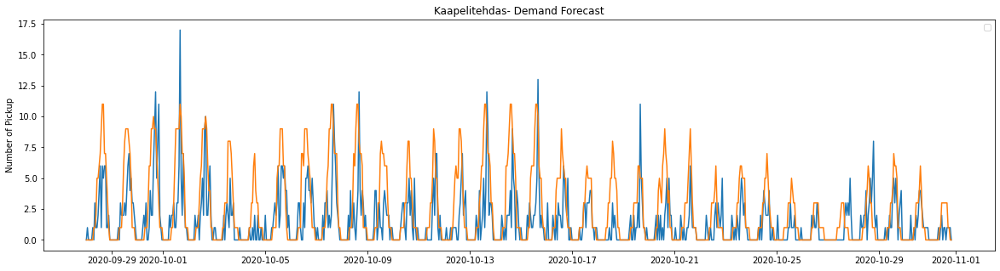

Kaisaniemenpuisto total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.6915159883475799
MAE is: %f 1.7445339470655927
MSE is: %f 9.477560414269275


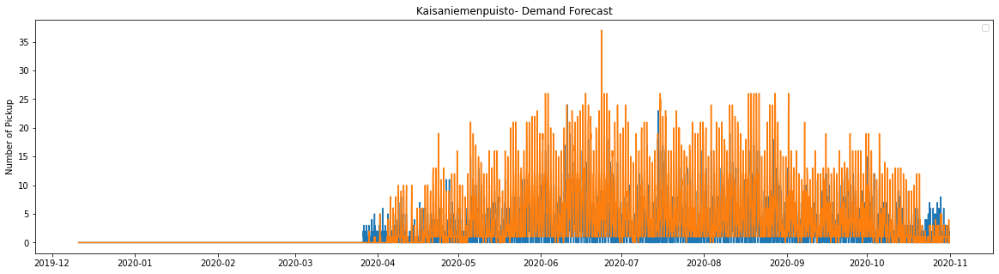

Kaivopuisto total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7890738201266713
MAE is: %f 2.132336018411968
MSE is: %f 16.67881345096535


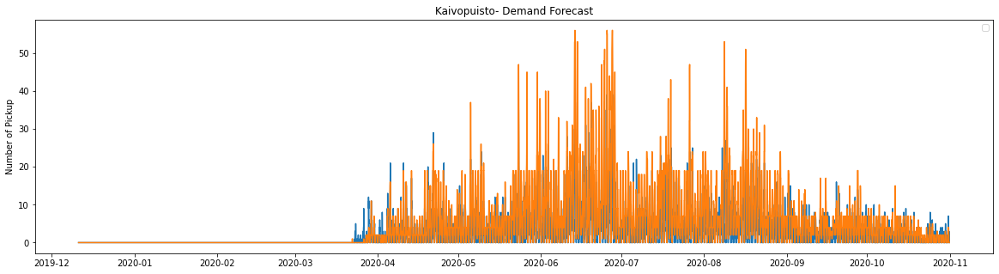

Kalasatama (M) total samples:  30675
Training samples:  24540
Testing samples:  6135


R-squared is: %f 0.7959765884838107
MAE is: %f 5.280032599837001
MSE is: %f 75.30415647921761


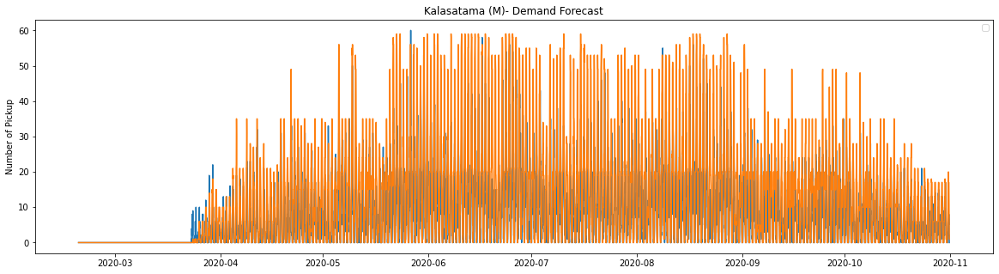

Kalevalantie total samples:  21927
Training samples:  17541
Testing samples:  4386


R-squared is: %f 0.32208319112982065
MAE is: %f 0.9892840857273142
MSE is: %f 2.241906064751482


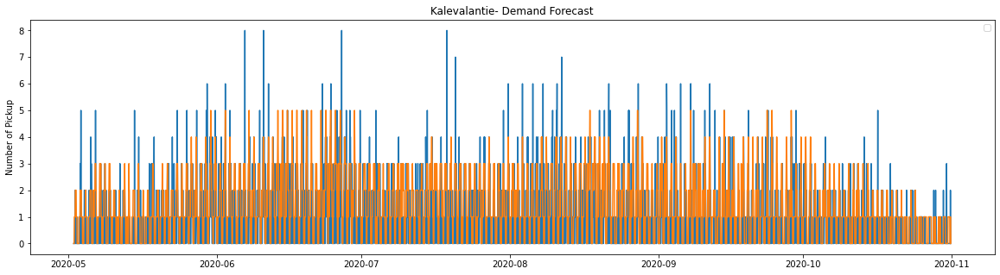

Kalevankatu total samples:  30679
Training samples:  24543
Testing samples:  6136


R-squared is: %f 0.677058188535486
MAE is: %f 1.9708279009126466
MSE is: %f 9.030475880052151


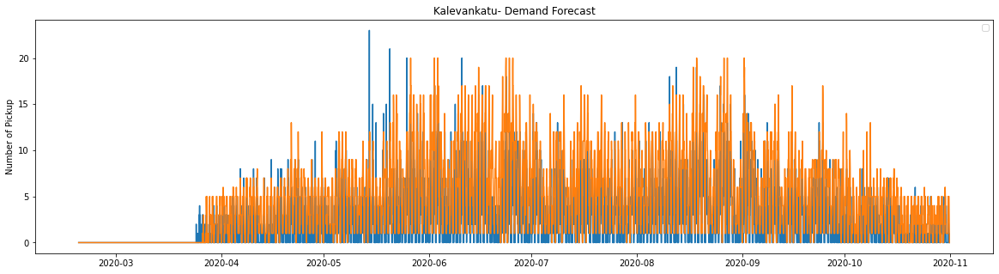

Kalkkipellonmäki total samples:  19896
Training samples:  15916
Testing samples:  3980


R-squared is: %f 0.15886434324906296
MAE is: %f 0.6085427135678392
MSE is: %f 0.9854271356783919


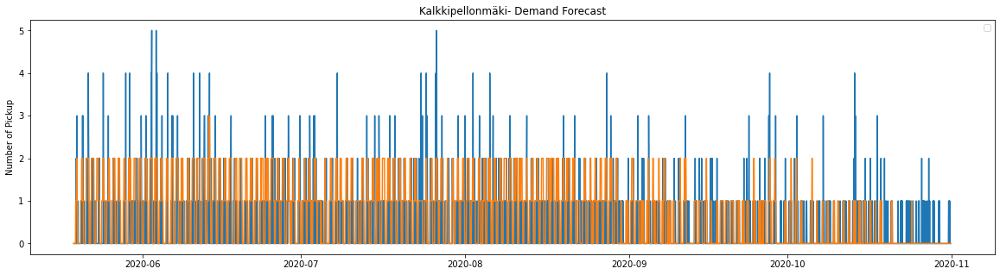

Kamppi (M) total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.815023693747769
MAE is: %f 2.713463751438435
MSE is: %f 23.08323743766782


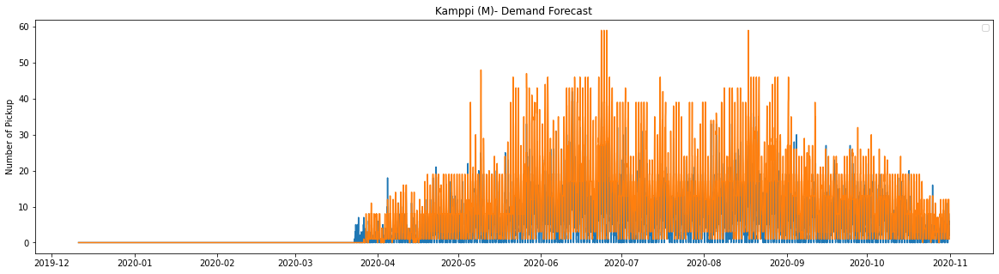

Kanavaranta total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7867026162504804
MAE is: %f 2.5494182329625366
MSE is: %f 24.433064825469888


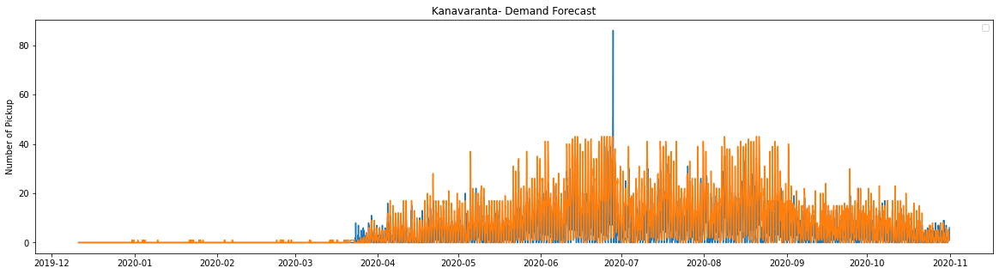

Kansallismuseo total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.5593363231524073
MAE is: %f 1.1767037463239995
MSE is: %f 3.993990538294336


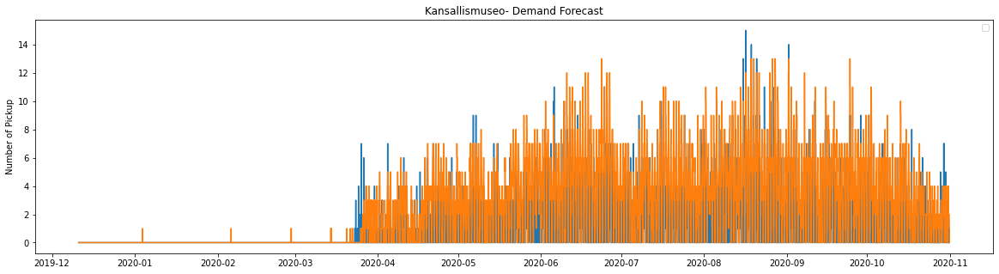

Kapteeninpuistikko total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.6732920440878659
MAE is: %f 1.4880450070323488
MSE is: %f 6.301495972382049


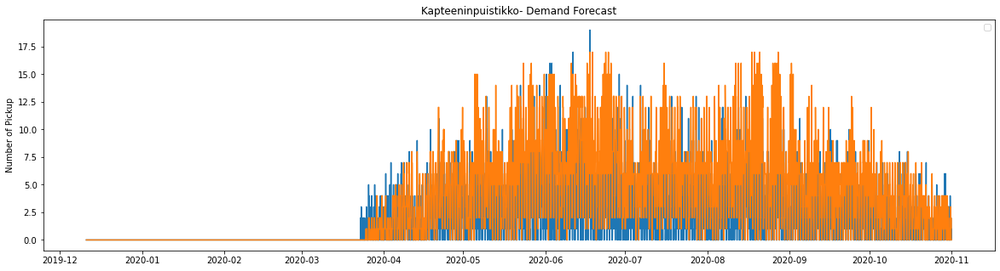

Karhulantie total samples:  13396
Training samples:  10716
Testing samples:  2680


R-squared is: %f 0.11978286479784928
MAE is: %f 0.6018656716417911
MSE is: %f 1.080223880597015


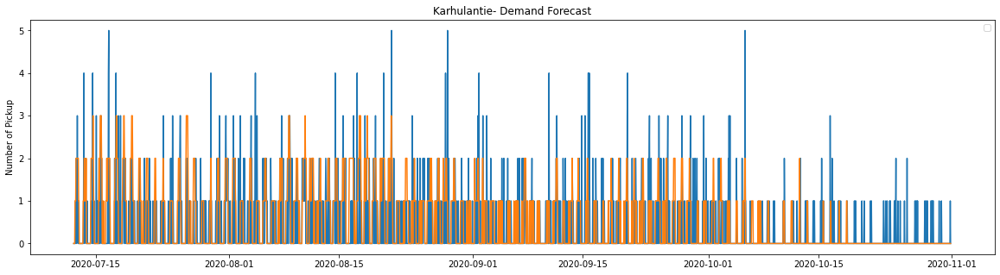

Karhupuisto total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.6548543941514108
MAE is: %f 0.994501981843754
MSE is: %f 3.86114307633295


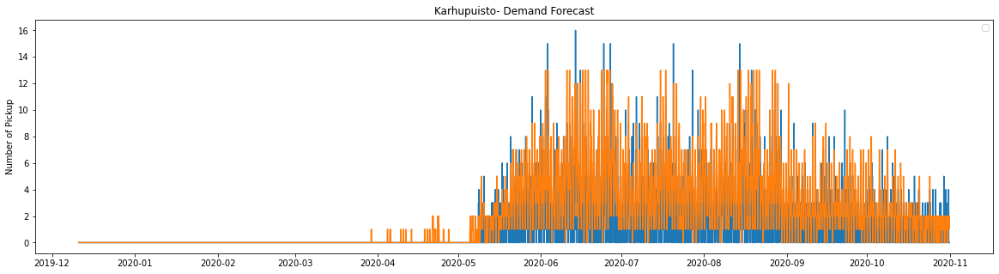

Kasarmitori total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.685628126560361
MAE is: %f 1.1417977240762052
MSE is: %f 4.495077355836849


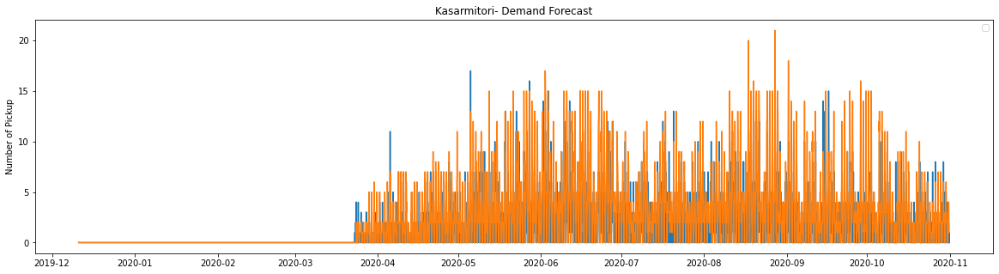

Katariina Saksilaisen katu total samples:  13832
Training samples:  11065
Testing samples:  2767


R-squared is: %f 0.3398445711735023
MAE is: %f 1.083483917600289
MSE is: %f 2.9794000722804483


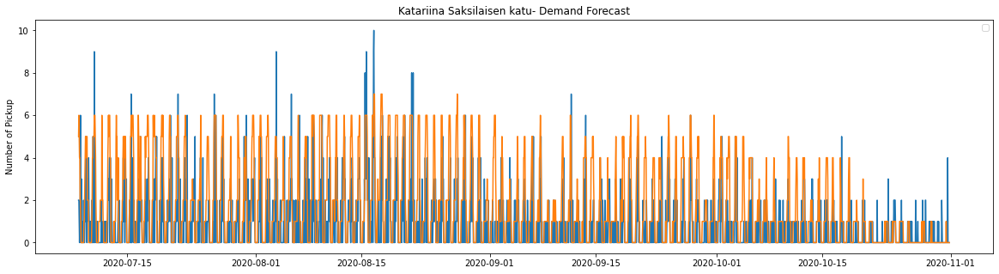

Kauppakorkeakoulu total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.5892229050859266
MAE is: %f 1.5853471423091676
MSE is: %f 7.117120572816775


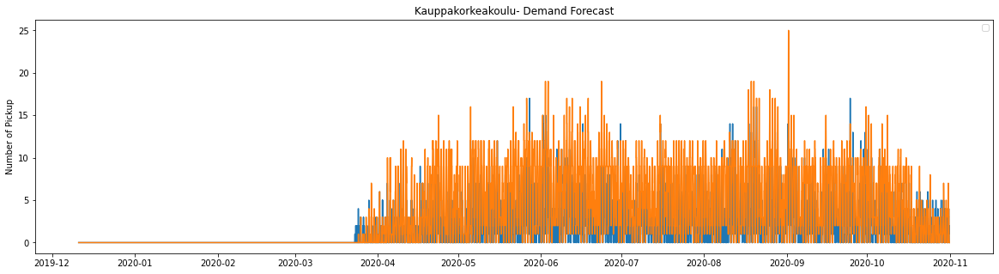

Keilalahti total samples:  21923
Training samples:  17538
Testing samples:  4385


R-squared is: %f 0.48635911925628983
MAE is: %f 0.8597491448118586
MSE is: %f 2.3867730900798176


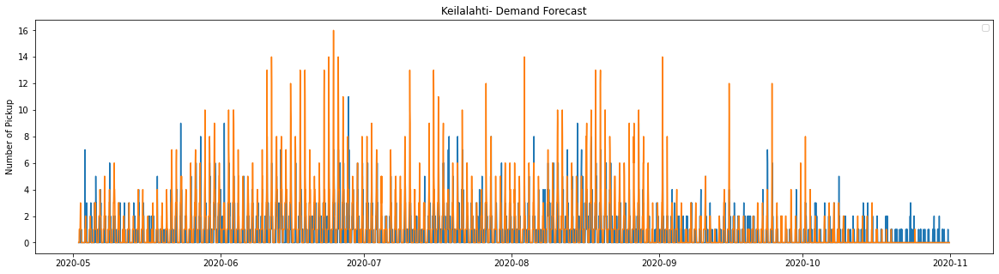

Keilaniemi (M) total samples:  21925
Training samples:  17540
Testing samples:  4385


R-squared is: %f 0.4095991074303432
MAE is: %f 1.2310148232611176
MSE is: %f 4.119042189281642


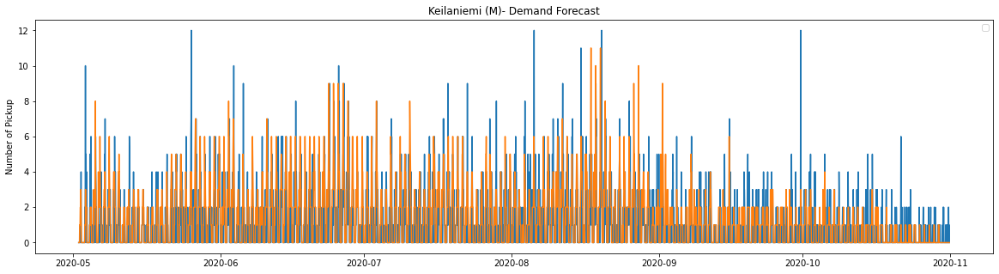

Keilaranta total samples:  21920
Training samples:  17536
Testing samples:  4384


R-squared is: %f 0.30228457630040895
MAE is: %f 0.7951642335766423
MSE is: %f 1.8722627737226278


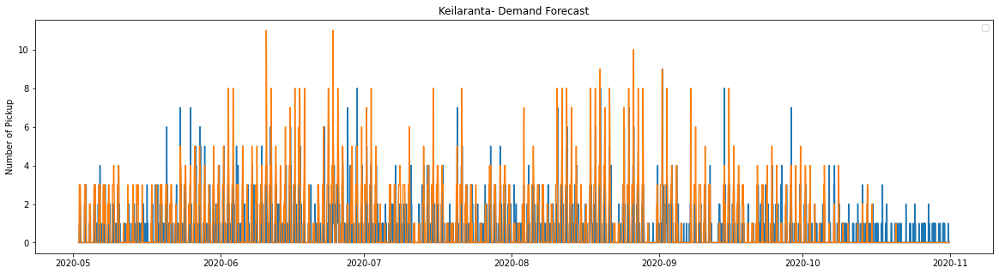

Kesäkatu total samples:  30683
Training samples:  24546
Testing samples:  6137


R-squared is: %f 0.6184165935368029
MAE is: %f 1.7093042203030797
MSE is: %f 9.044158383575036


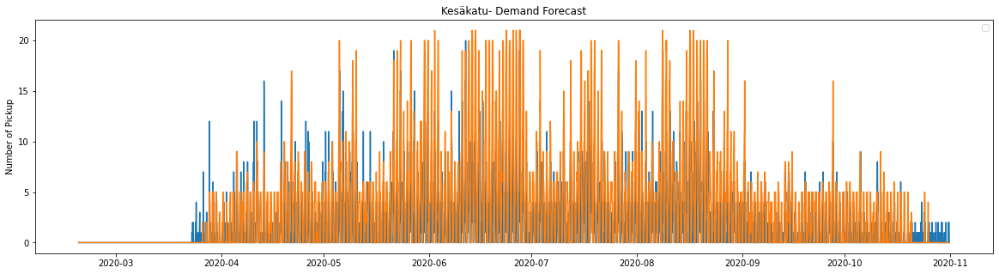

Kiasma total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7648642839543396
MAE is: %f 1.7752205600306865
MSE is: %f 12.287686996547755


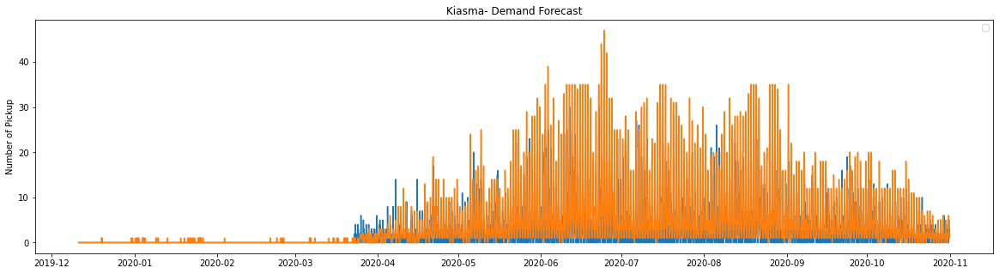

Kirjurinkuja total samples:  20043
Training samples:  16034
Testing samples:  4009


R-squared is: %f 0.579759951834374
MAE is: %f 1.9468695435270642
MSE is: %f 8.359441257171364


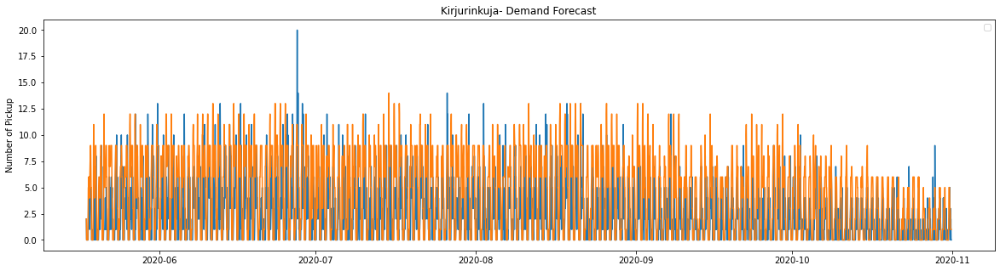

Kirkkoherrantie total samples:  13782
Training samples:  11025
Testing samples:  2757


R-squared is: %f 0.08064247207247266
MAE is: %f 0.544069640914037
MSE is: %f 0.9357997823721437


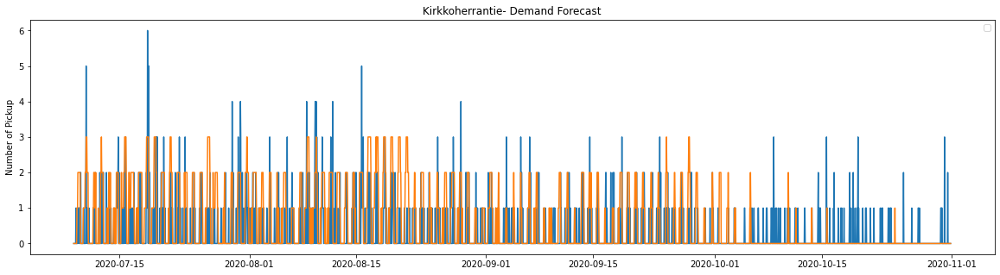

Kiskontie total samples:  30675
Training samples:  24540
Testing samples:  6135


R-squared is: %f 0.5036962920112498
MAE is: %f 1.1185004074979625
MSE is: %f 3.2074979625101876


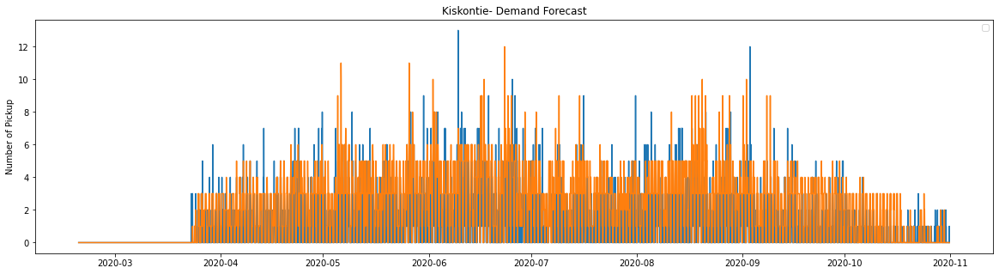

Koivu-Mankkaa total samples:  21917
Training samples:  17533
Testing samples:  4384


R-squared is: %f 0.16508425686608075
MAE is: %f 0.5691149635036497
MSE is: %f 0.9016879562043796


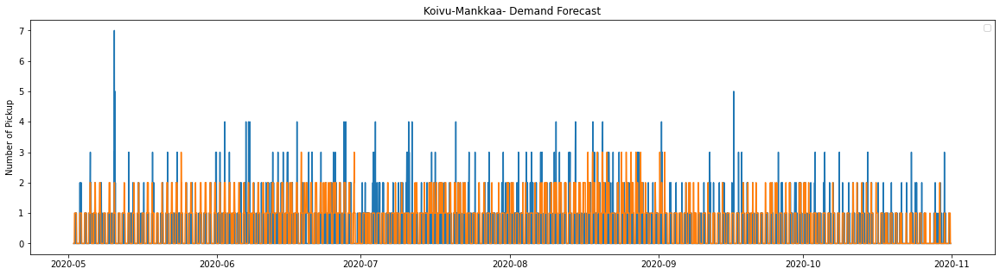

Komeetankatu total samples:  21924
Training samples:  17539
Testing samples:  4385


R-squared is: %f 0.30665380470221415
MAE is: %f 1.0905359179019385
MSE is: %f 2.343443557582668


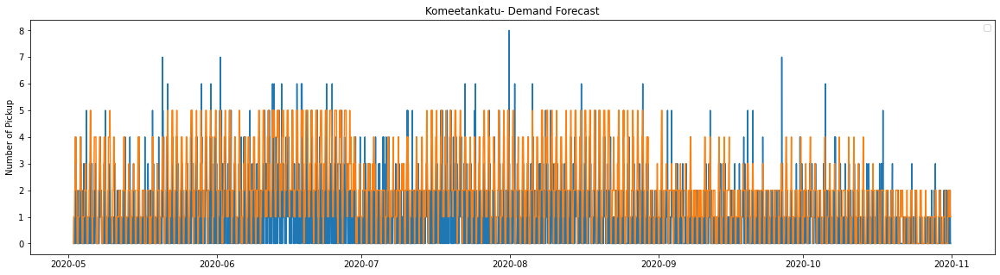

Komentajankatu total samples:  20051
Training samples:  16040
Testing samples:  4011


R-squared is: %f 0.24555939076270628
MAE is: %f 1.0909997506856146
MSE is: %f 2.4507604088755923


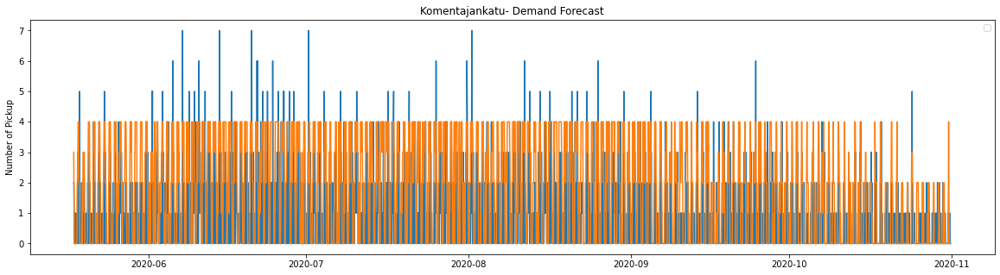

Korjaamo total samples:  30679
Training samples:  24543
Testing samples:  6136


R-squared is: %f 0.6893807428257753
MAE is: %f 2.68122555410691
MSE is: %f 16.908409387222946


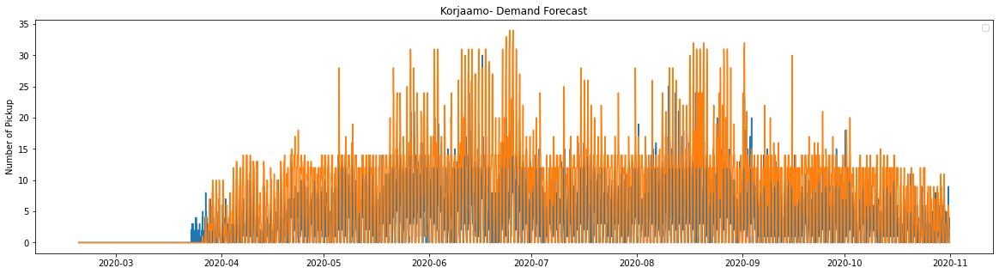

Korkeasaari total samples:  5228
Training samples:  4182
Testing samples:  1046


R-squared is: %f 0.13228555634257821
MAE is: %f 0.6013384321223709
MSE is: %f 2.2437858508604207


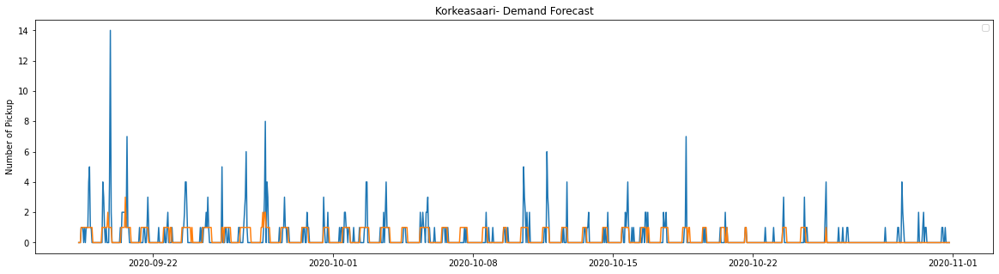

Korppaanmäentie total samples:  30678
Training samples:  24542
Testing samples:  6136


R-squared is: %f 0.45863637767938004
MAE is: %f 1.1888852672750978
MSE is: %f 3.300684485006519


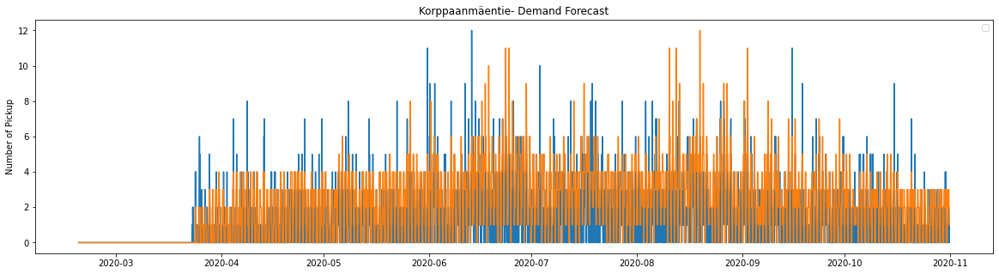

Koskelan varikko total samples:  10661
Training samples:  8528
Testing samples:  2133


R-squared is: %f 0.14146119440783123
MAE is: %f 0.972808251289264
MSE is: %f 1.892639474917956


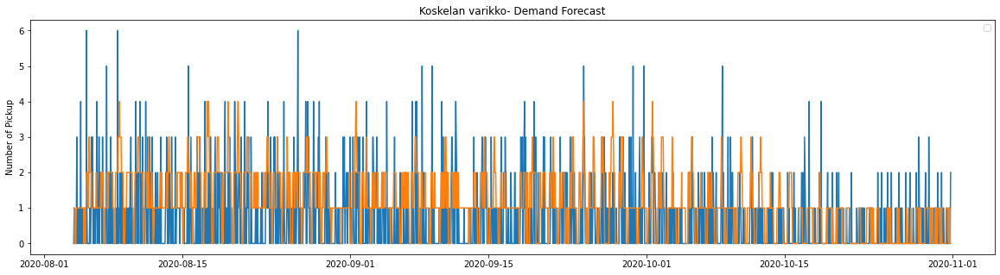

Koskelantie total samples:  30680
Training samples:  24544
Testing samples:  6136


R-squared is: %f 0.6725771234851401
MAE is: %f 1.7946544980443286
MSE is: %f 7.882007822685789


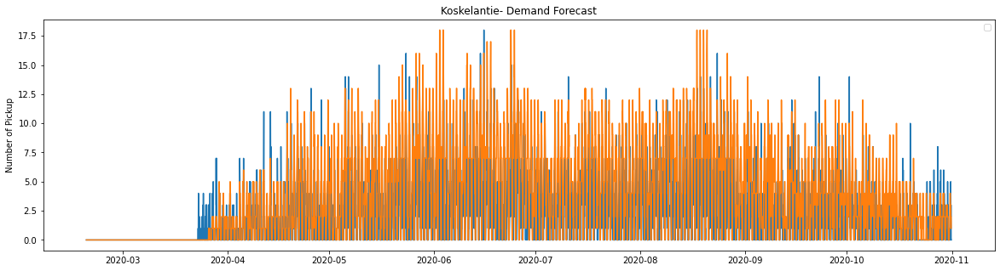

Kriikunakuja total samples:  30677
Training samples:  24541
Testing samples:  6136


R-squared is: %f 0.4837544332902527
MAE is: %f 1.024282920469361
MSE is: %f 2.9196544980443284


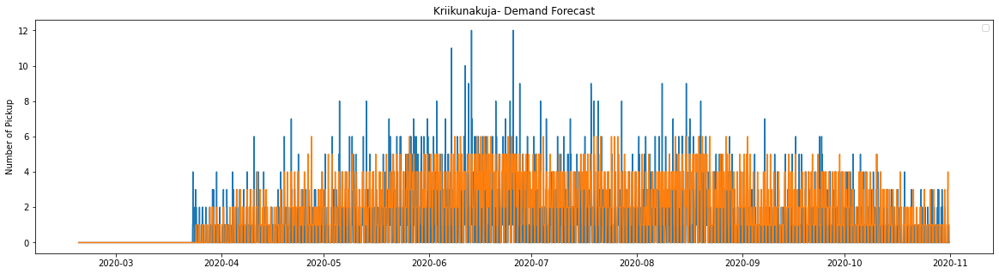

Kuikkarinne total samples:  22226
Training samples:  17780
Testing samples:  4446


R-squared is: %f 0.4882207590984433
MAE is: %f 1.99685110211426
MSE is: %f 8.88034188034188


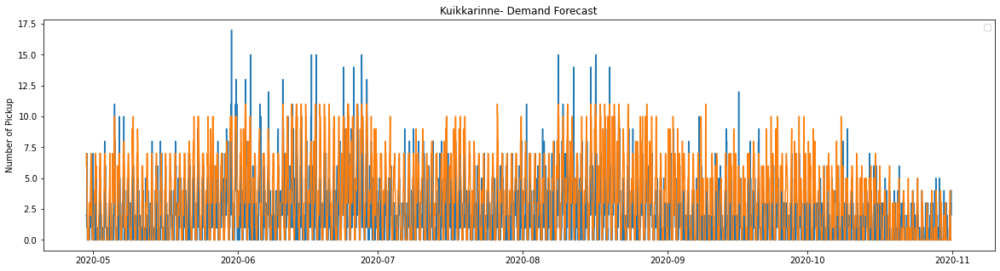

Kulosaari (M) total samples:  13541
Training samples:  10832
Testing samples:  2709


R-squared is: %f 0.5781464446883537
MAE is: %f 1.565891472868217
MSE is: %f 5.55703211517165


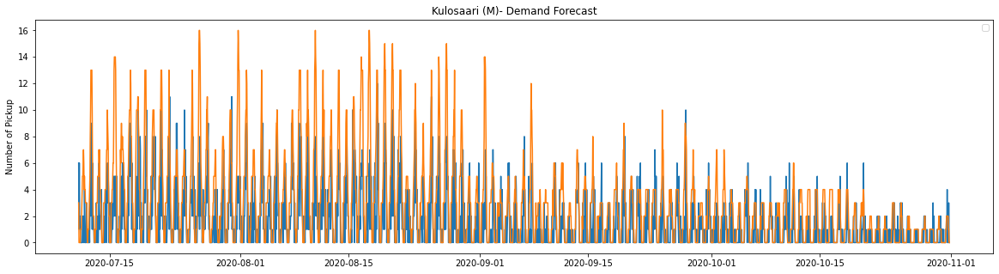

Kulttuuriaukio total samples:  21920
Training samples:  17536
Testing samples:  4384


R-squared is: %f 0.4802034926608115
MAE is: %f 1.1099452554744527
MSE is: %f 2.8385036496350367


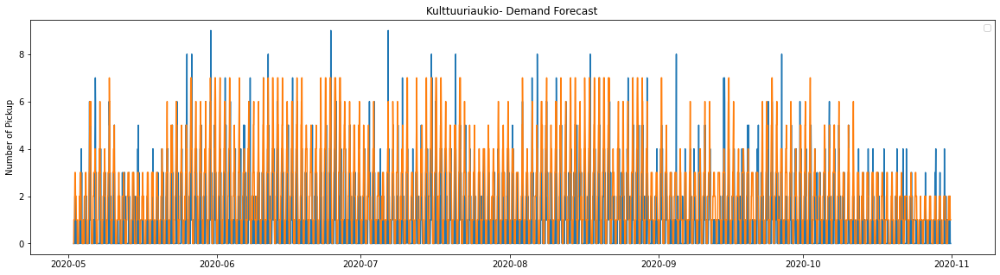

Kustaankartano total samples:  13662
Training samples:  10929
Testing samples:  2733


R-squared is: %f -0.04318838636010147
MAE is: %f 0.5426271496523967
MSE is: %f 0.8997438712038054


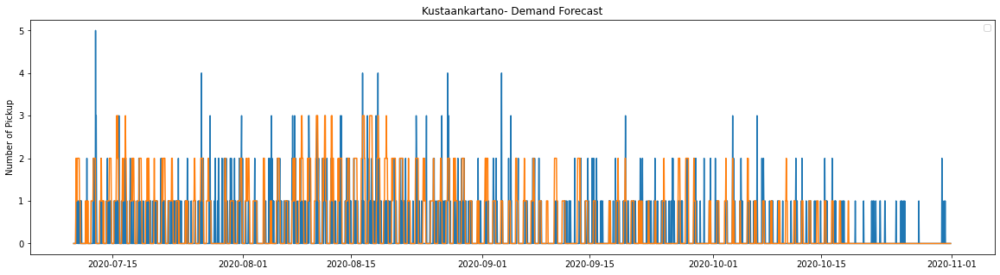

Kustaankatu total samples:  22258
Training samples:  17806
Testing samples:  4452


R-squared is: %f 0.43525219995453024
MAE is: %f 1.842093441150045
MSE is: %f 6.4508086253369274


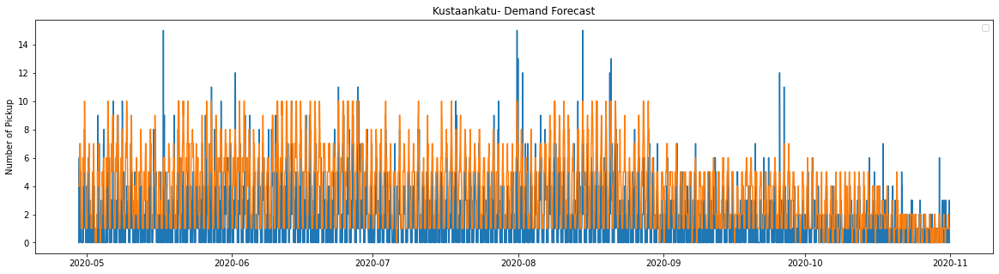

Kutsuntatie total samples:  19876
Training samples:  15900
Testing samples:  3976


R-squared is: %f -0.17970580547040238
MAE is: %f 0.34356136820925554
MSE is: %f 0.4396378269617706


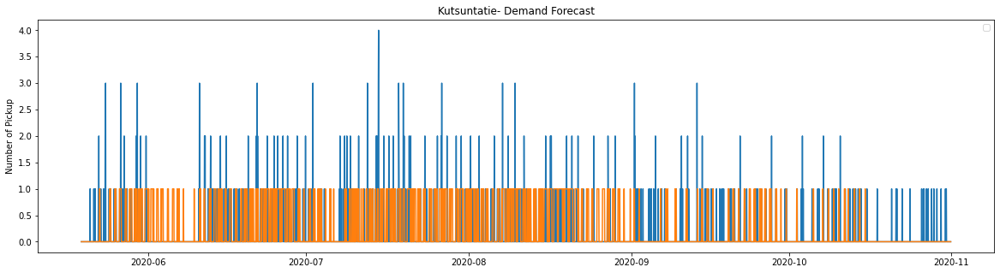

Kuunkatu total samples:  30684
Training samples:  24547
Testing samples:  6137


R-squared is: %f 0.2826889891957599
MAE is: %f 0.7963174189343327
MSE is: %f 1.747596545543425


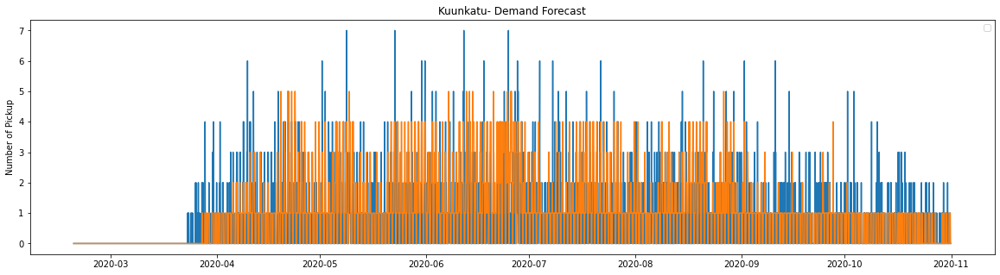

Kuusitie total samples:  30680
Training samples:  24544
Testing samples:  6136


R-squared is: %f 0.5875072653839519
MAE is: %f 1.7786831812255541
MSE is: %f 7.174054758800522


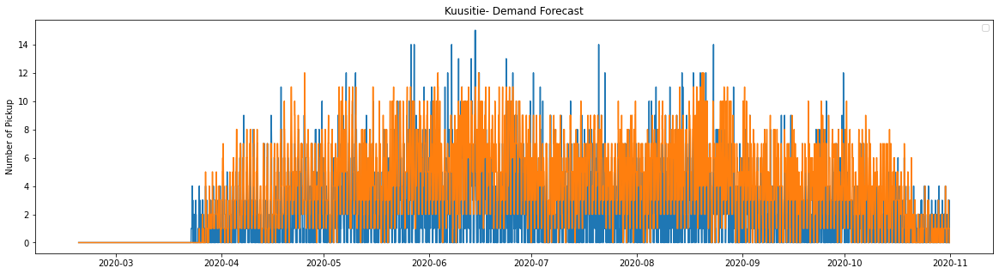

Kylävoudintie total samples:  13631
Training samples:  10904
Testing samples:  2727


R-squared is: %f 0.059732250408057186
MAE is: %f 0.7455078841217455
MSE is: %f 1.2772277227722773


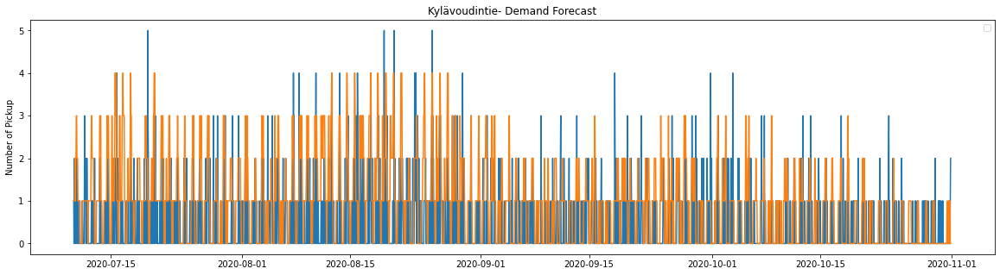

Käpylän asema total samples:  30365
Training samples:  24292
Testing samples:  6073


R-squared is: %f 0.4908078007487555
MAE is: %f 1.0004939897908776
MSE is: %f 2.6622756463033097


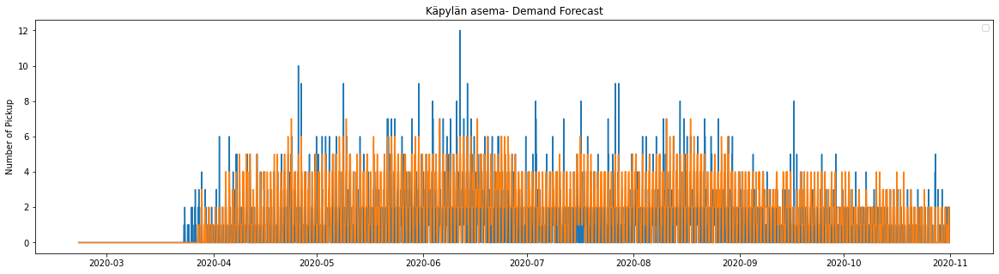

Käpyläntie total samples:  30680
Training samples:  24544
Testing samples:  6136


R-squared is: %f 0.4738478840336129
MAE is: %f 1.2390808344198174
MSE is: %f 3.8521838331160363


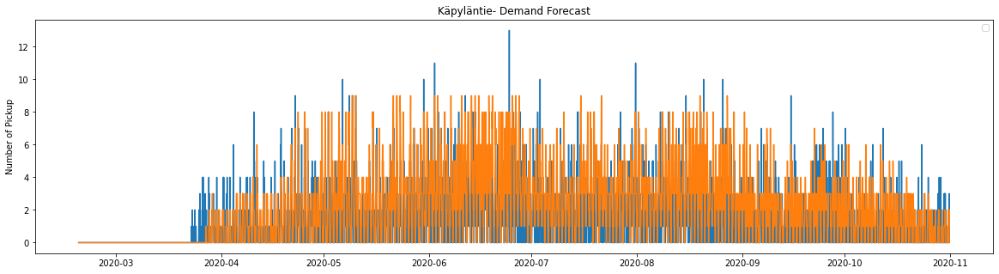

Käskynhaltijantie total samples:  13609
Training samples:  10887
Testing samples:  2722


R-squared is: %f -0.030634170359428614
MAE is: %f 0.3894195444526084
MSE is: %f 0.565025716385011


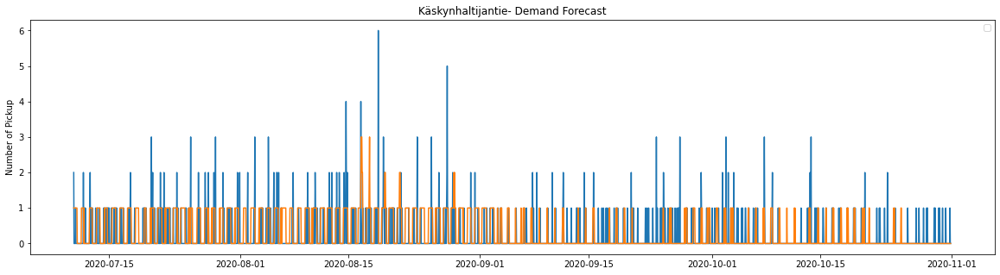

Laajalahden aukio total samples:  30679
Training samples:  24543
Testing samples:  6136


R-squared is: %f 0.6835828126653758
MAE is: %f 2.303780964797914
MSE is: %f 14.932855280312907


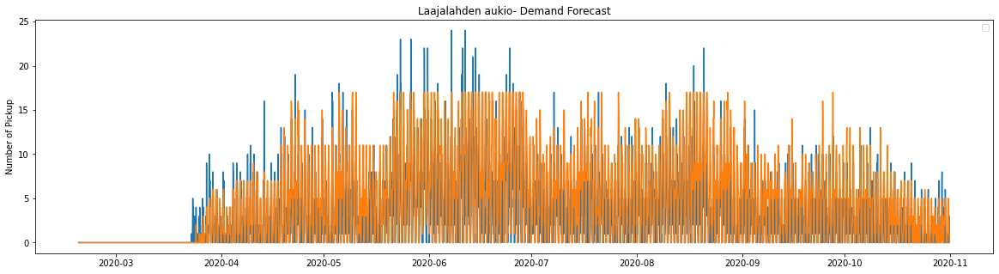

Laajalahden keskus total samples:  30672
Training samples:  24537
Testing samples:  6135


R-squared is: %f 0.17340079736477654
MAE is: %f 0.5962510187449063
MSE is: %f 1.173920130399348


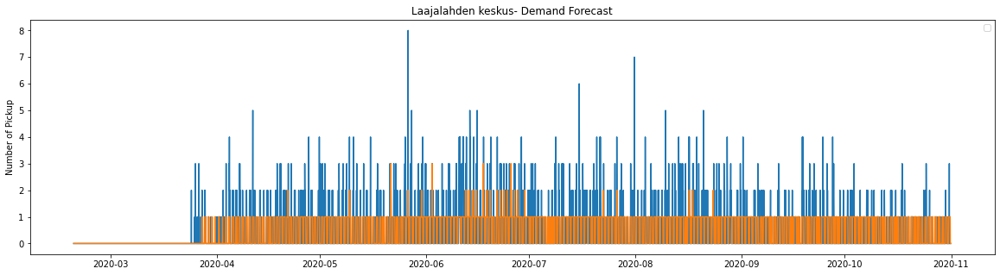

Laajasalon ostoskeskus total samples:  11841
Training samples:  9472
Testing samples:  2369


R-squared is: %f 0.5078571670714997
MAE is: %f 0.8991135500211059
MSE is: %f 2.3022372308991135


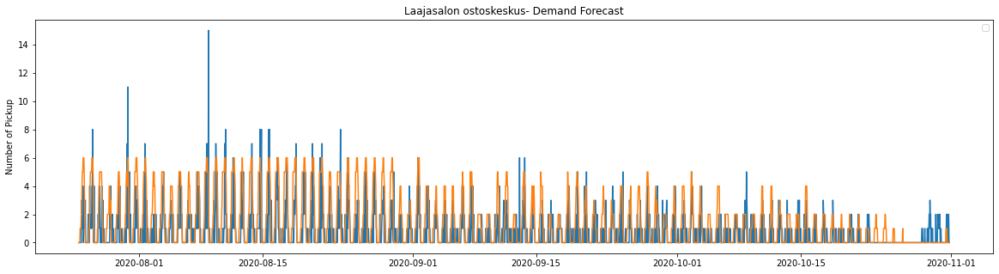

Laivalahden puistotie total samples:  13539
Training samples:  10831
Testing samples:  2708


R-squared is: %f 0.4046637374417298
MAE is: %f 1.1285081240768096
MSE is: %f 2.997784342688331


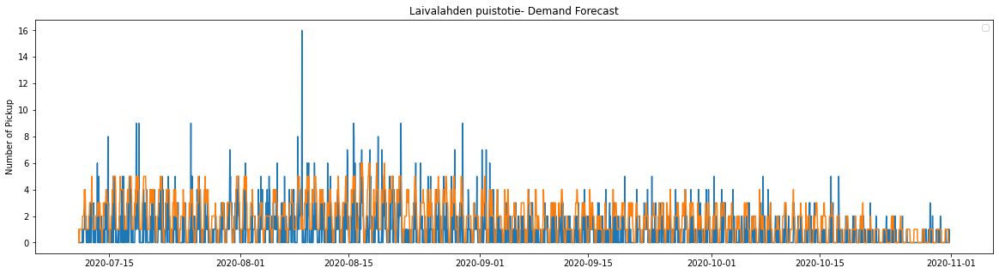

Laivasillankatu total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.5866826552017141
MAE is: %f 1.1177598772535482
MSE is: %f 4.0938498913182455


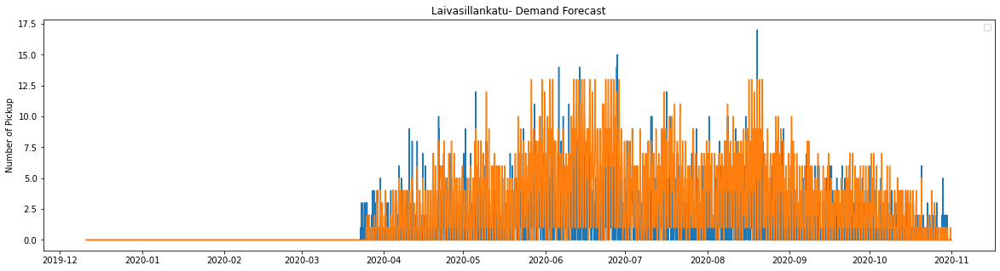

Lastenlehto total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.6692004718745156
MAE is: %f 1.3072497123130034
MSE is: %f 4.745684695051784


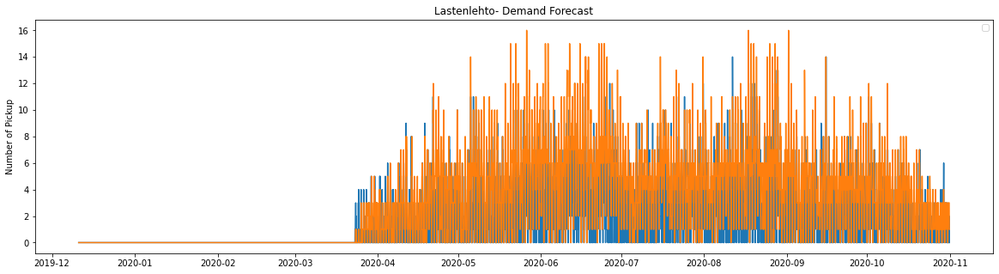

Lauttasaaren ostoskeskus total samples:  30681
Training samples:  24544
Testing samples:  6137


R-squared is: %f 0.7393862565754892
MAE is: %f 2.201890174352289
MSE is: %f 12.815870946716636


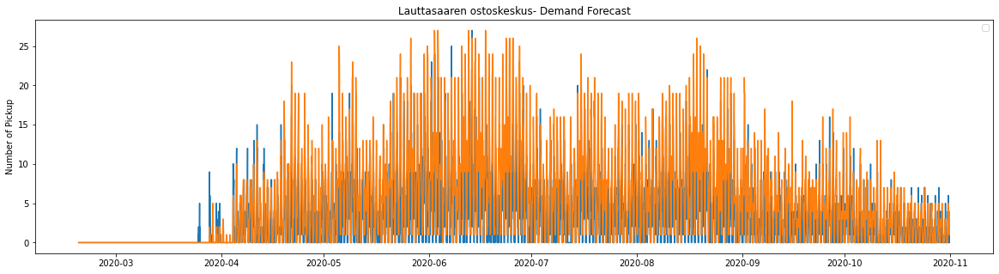

Lauttasaarensilta total samples:  30682
Training samples:  24545
Testing samples:  6137


R-squared is: %f 0.6228702117715297
MAE is: %f 2.142903698875672
MSE is: %f 11.833306175655858


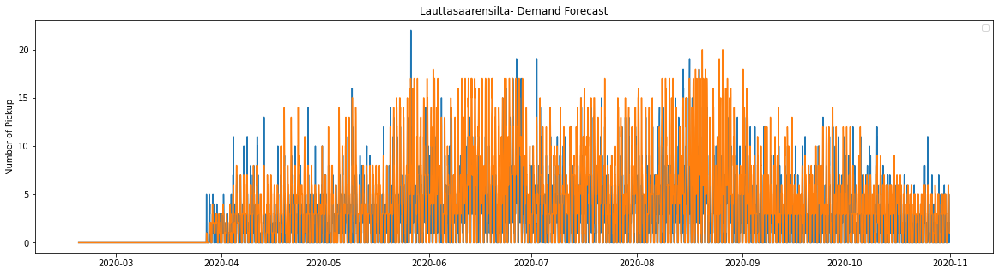

Lehtisaarentie total samples:  22371
Training samples:  17896
Testing samples:  4475


R-squared is: %f 0.5899681840376448
MAE is: %f 1.8265921787709498
MSE is: %f 8.362458100558658


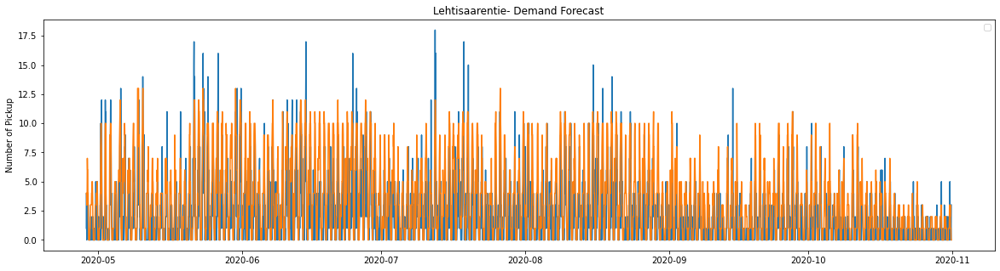

Lepolantie total samples:  13613
Training samples:  10890
Testing samples:  2723


R-squared is: %f 0.15964651355336246
MAE is: %f 0.5618802791039295
MSE is: %f 1.0929122291590159


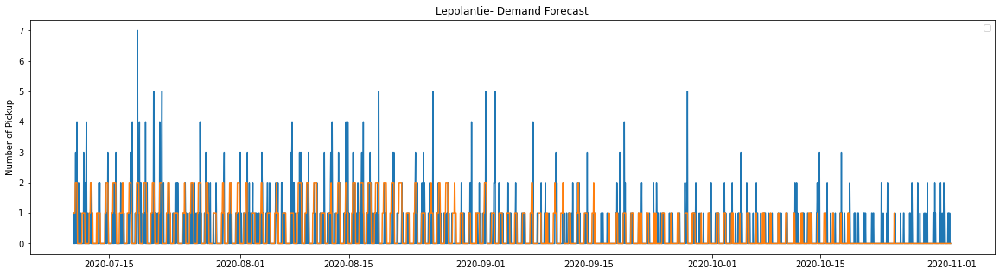

Leppäsuonaukio total samples:  22446
Training samples:  17956
Testing samples:  4490


R-squared is: %f 0.492895552689668
MAE is: %f 2.4211581291759465
MSE is: %f 11.5271714922049


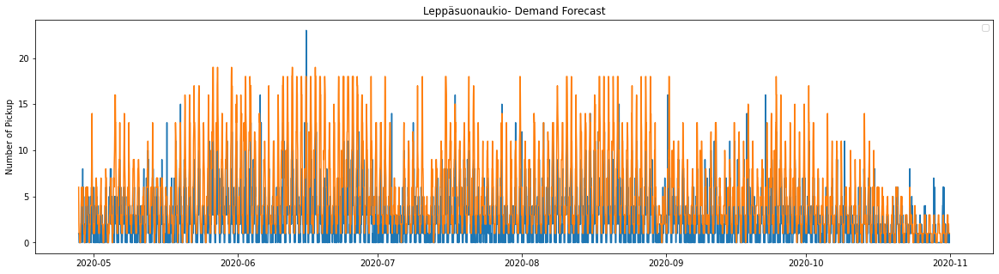

Leppävaaran uimahalli total samples:  19855
Training samples:  15884
Testing samples:  3971


R-squared is: %f 0.2967143518540347
MAE is: %f 0.6791740115839838
MSE is: %f 1.3998992697053638


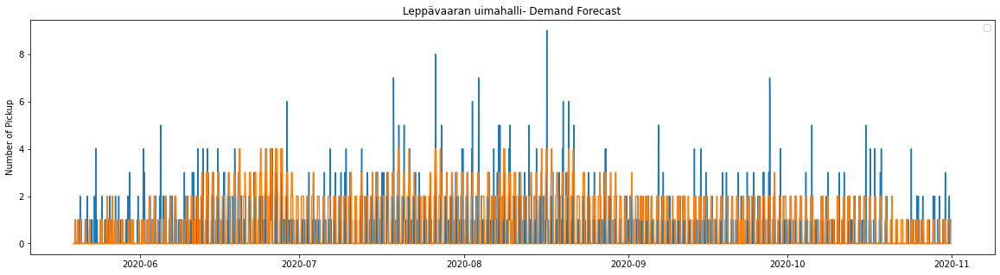

Leppävaaran urheilupuisto total samples:  19878
Training samples:  15902
Testing samples:  3976


R-squared is: %f 0.3758446106077884
MAE is: %f 0.8161468812877264
MSE is: %f 2.2406941649899395


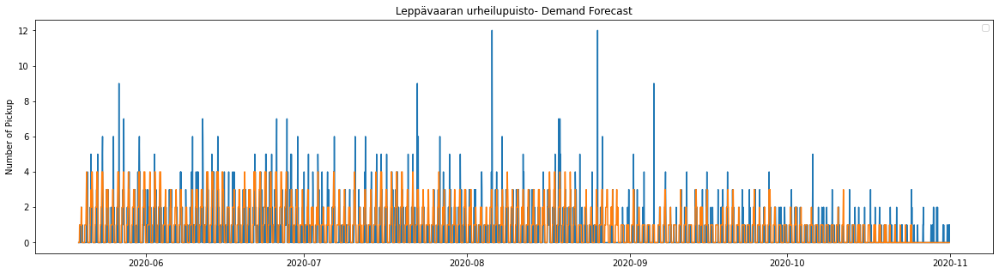

Leppävaaranaukio total samples:  20023
Training samples:  16018
Testing samples:  4005


R-squared is: %f 0.6175991960087102
MAE is: %f 2.1737827715355804
MSE is: %f 10.873907615480649


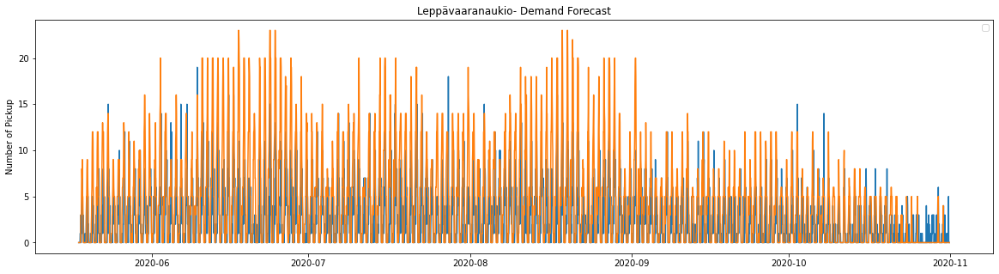

Leppävaarankäytävä total samples:  19568
Training samples:  15654
Testing samples:  3914


R-squared is: %f 0.5455948145154852
MAE is: %f 1.8737864077669903
MSE is: %f 7.2769545222279


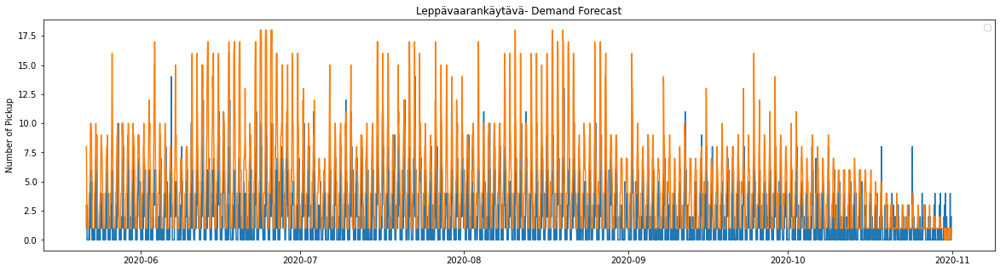

Liisanpuistikko total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7613897414026258
MAE is: %f 2.2702979158675363
MSE is: %f 18.227592379491114


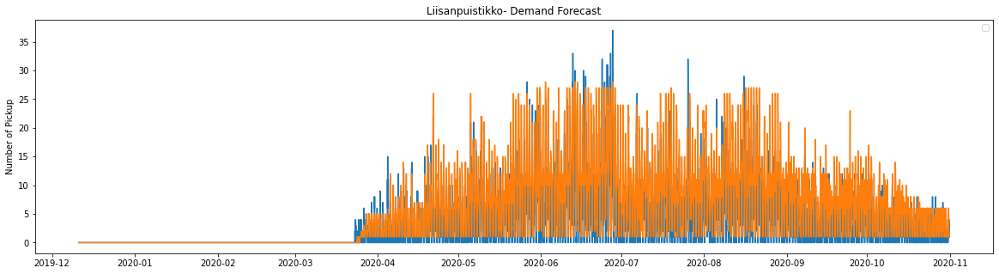

Linnakepolku total samples:  21916
Training samples:  17532
Testing samples:  4384


R-squared is: %f 0.3384928496579428
MAE is: %f 0.708257299270073
MSE is: %f 1.3642791970802919


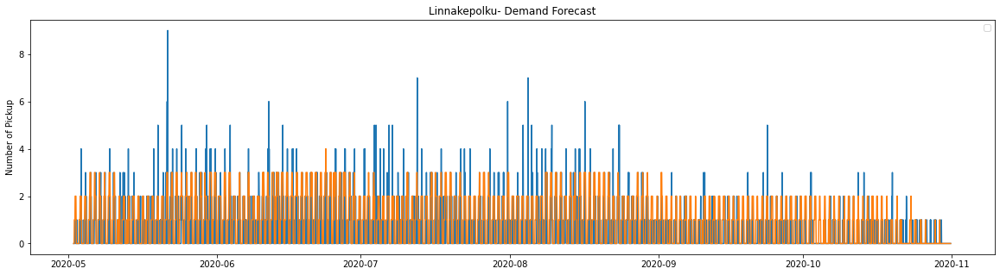

Linnanmäki total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.734644239390646
MAE is: %f 2.021992072624984
MSE is: %f 13.306482546988876


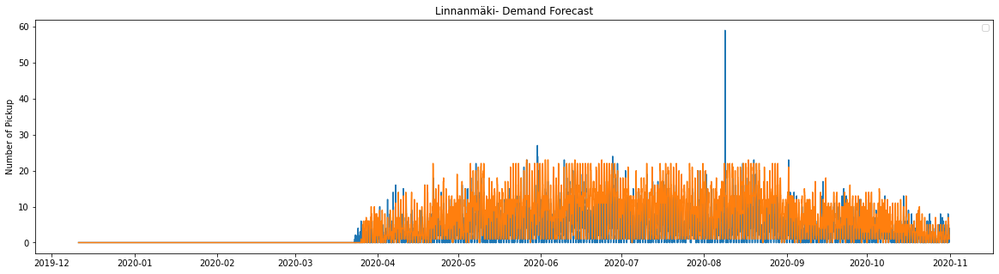

Linnuntie total samples:  19869
Training samples:  15895
Testing samples:  3974


R-squared is: %f 0.2935269927278903
MAE is: %f 0.6836940110719678
MSE is: %f 1.2357825868142929


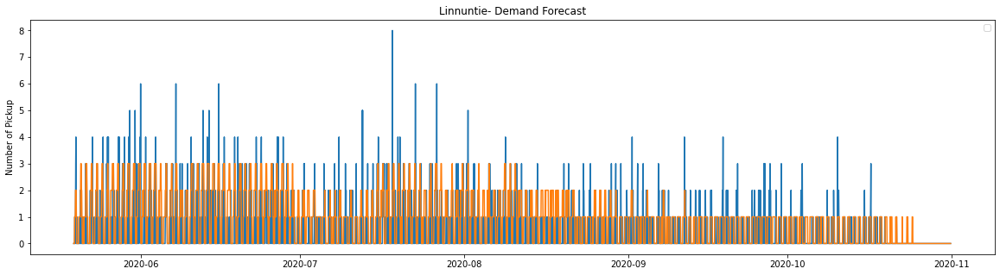

Lintulahdenkatu total samples:  30682
Training samples:  24545
Testing samples:  6137


R-squared is: %f 0.6703258261178188
MAE is: %f 3.3359947857259247
MSE is: %f 29.67590027700831


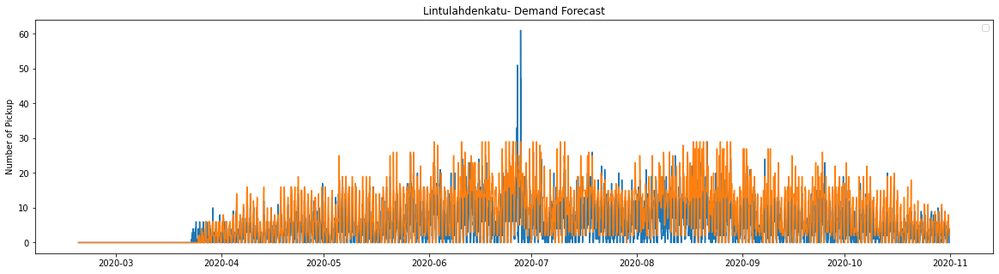

Louhentori total samples:  21924
Training samples:  17539
Testing samples:  4385


R-squared is: %f 0.27582770466841355
MAE is: %f 0.9210946408209806
MSE is: %f 1.9696693272519954


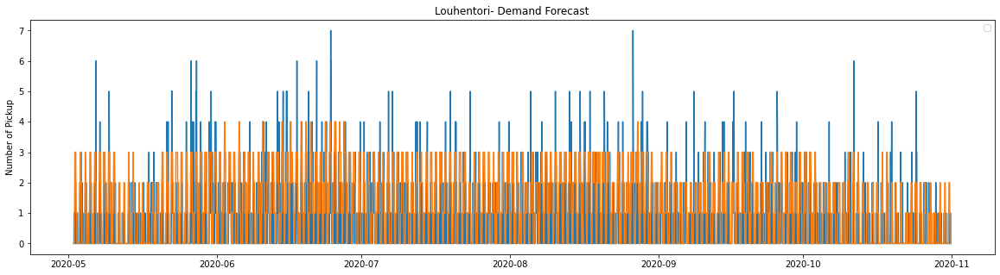

Lukutori total samples:  21920
Training samples:  17536
Testing samples:  4384


R-squared is: %f 0.08880188291356084
MAE is: %f 0.5983120437956204
MSE is: %f 1.1512317518248176


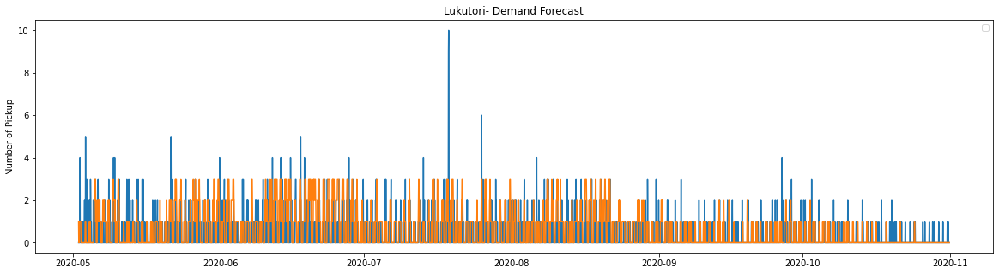

Lumivaarantie total samples:  20018
Training samples:  16014
Testing samples:  4004


R-squared is: %f 0.05519706562624105
MAE is: %f 0.3531468531468531
MSE is: %f 0.6053946053946054


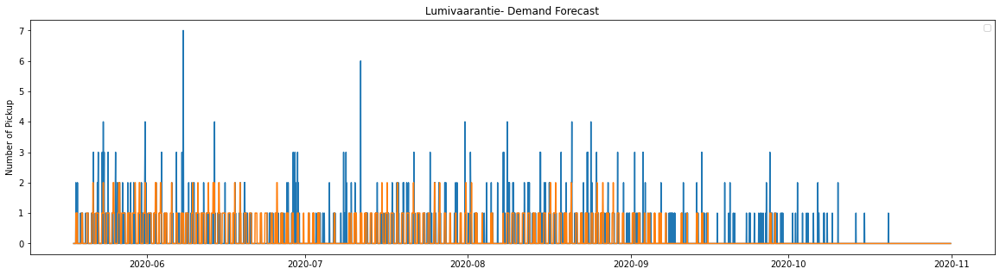

Luoteisväylä total samples:  30677
Training samples:  24541
Testing samples:  6136


R-squared is: %f 0.564854218329534
MAE is: %f 1.6711212516297262
MSE is: %f 8.617014341590613


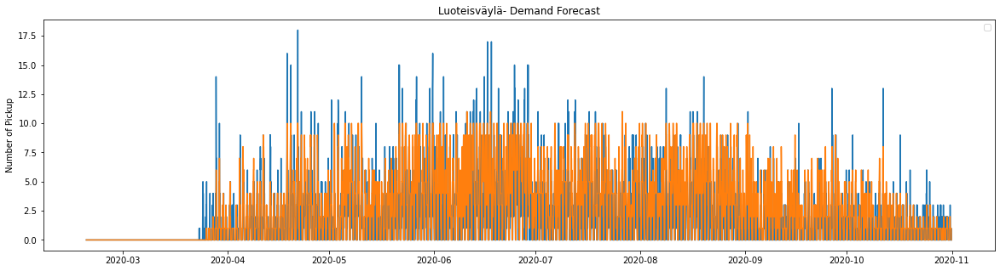

Lystimäensilta total samples:  20041
Training samples:  16032
Testing samples:  4009


R-squared is: %f 0.06209732028161441
MAE is: %f 0.53404839111998
MSE is: %f 0.8907458219007234


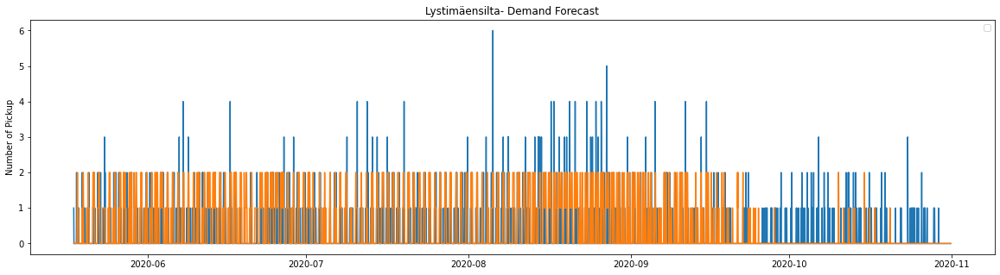

Lystimäki total samples:  21924
Training samples:  17539
Testing samples:  4385


R-squared is: %f -0.013615888177385571
MAE is: %f 0.5163055872291904
MSE is: %f 0.7384264538198404


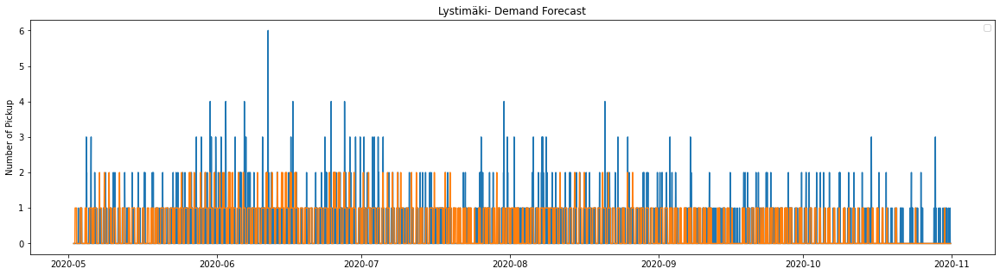

Läkkitori total samples:  20046
Training samples:  16036
Testing samples:  4010


R-squared is: %f 0.3652244827727714
MAE is: %f 1.0678304239401497
MSE is: %f 2.6319201995012467


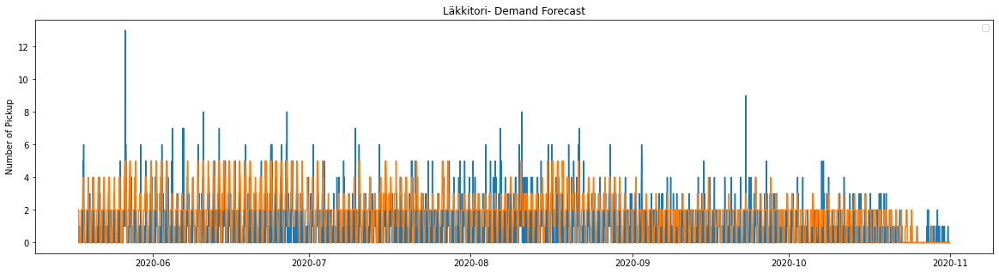

Länsisatamankatu total samples:  30677
Training samples:  24541
Testing samples:  6136


R-squared is: %f 0.6830854839507474
MAE is: %f 2.5392764015645373
MSE is: %f 14.357724902216427


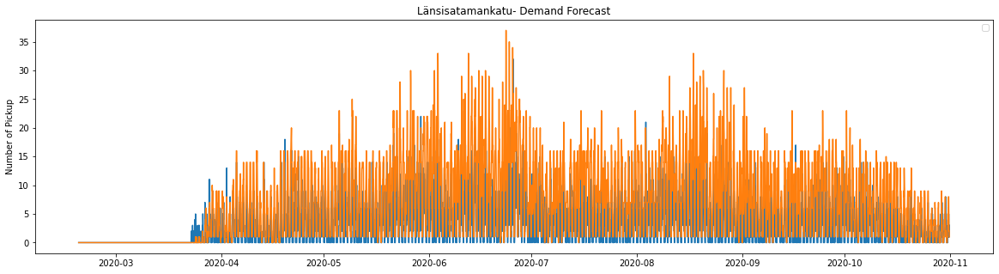

Länsisatamankuja total samples:  13485
Training samples:  10788
Testing samples:  2697


R-squared is: %f 0.6087832095872103
MAE is: %f 3.084538375973304
MSE is: %f 20.626251390433815


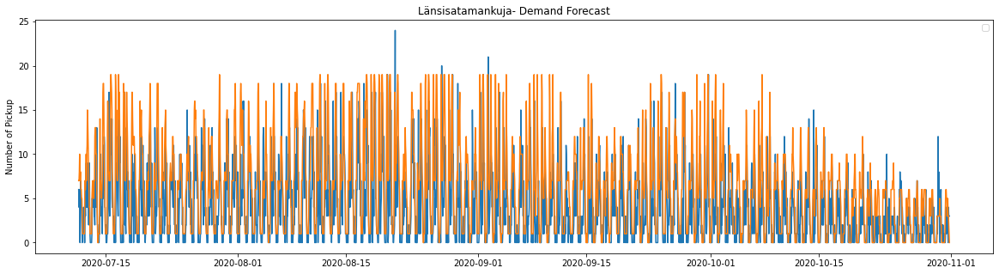

Länsiterminaali total samples:  13491
Training samples:  10792
Testing samples:  2699


R-squared is: %f 0.42011686351991395
MAE is: %f 0.7298999629492404
MSE is: %f 2.0978140051871064


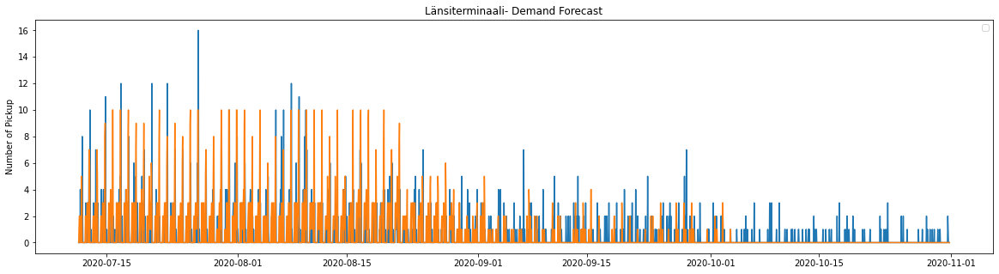

Länsituuli total samples:  21925
Training samples:  17540
Testing samples:  4385


R-squared is: %f 0.6348274035765257
MAE is: %f 1.6720638540478905
MSE is: %f 6.696009122006841


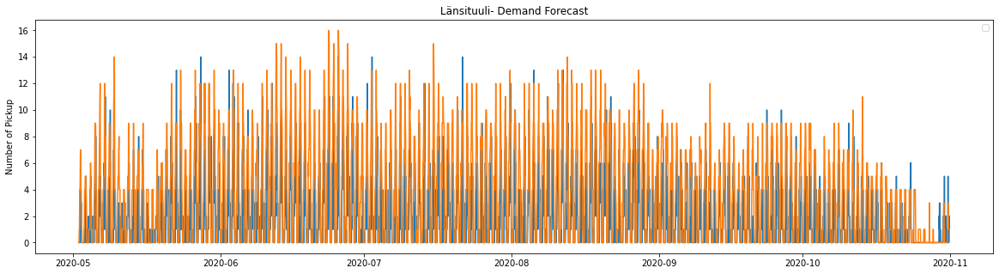

Maarinranta total samples:  19781
Training samples:  15824
Testing samples:  3957


R-squared is: %f 0.28692280750970367
MAE is: %f 0.6340662117765984
MSE is: %f 1.4948193075562295


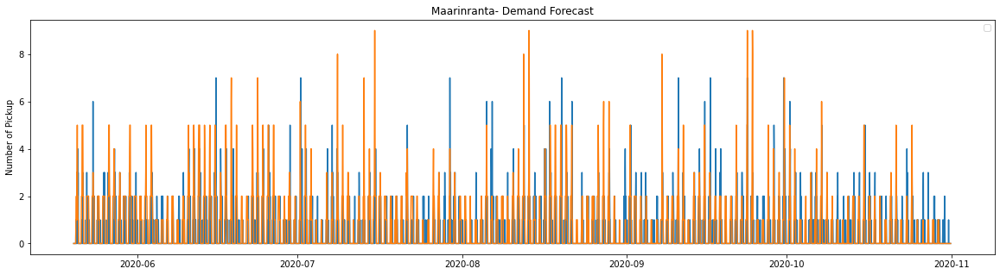

Maistraatintori total samples:  30679
Training samples:  24543
Testing samples:  6136


R-squared is: %f 0.35261135319907067
MAE is: %f 0.9092242503259452
MSE is: %f 2.3150260756192957


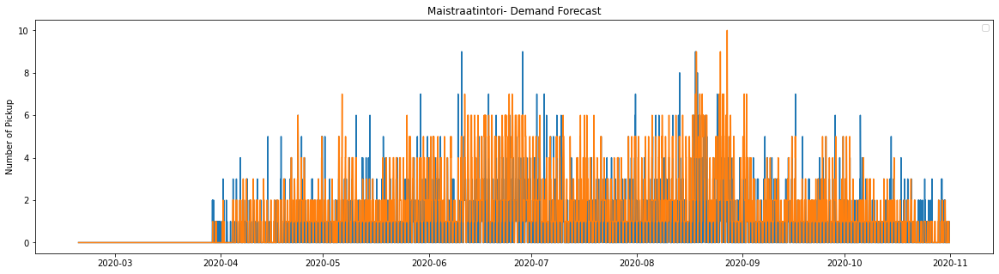

Majurinkulma total samples:  19949
Training samples:  15959
Testing samples:  3990


R-squared is: %f 0.4288912457829548
MAE is: %f 1.0646616541353384
MSE is: %f 2.8481203007518796


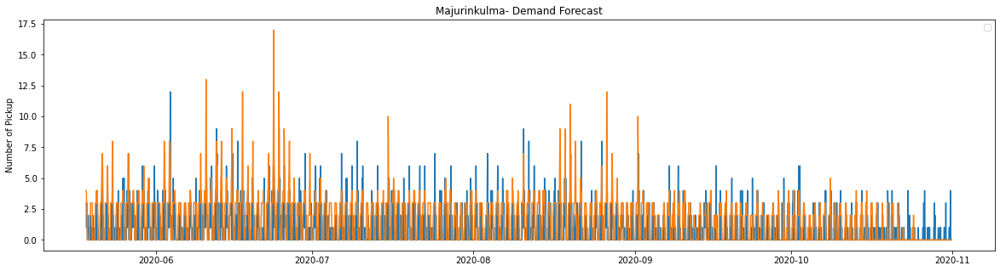

Mamsellimyllynkatu total samples:  13494
Training samples:  10795
Testing samples:  2699


R-squared is: %f 0.0400337489521454
MAE is: %f 0.387921452389774
MSE is: %f 0.5087069284920341


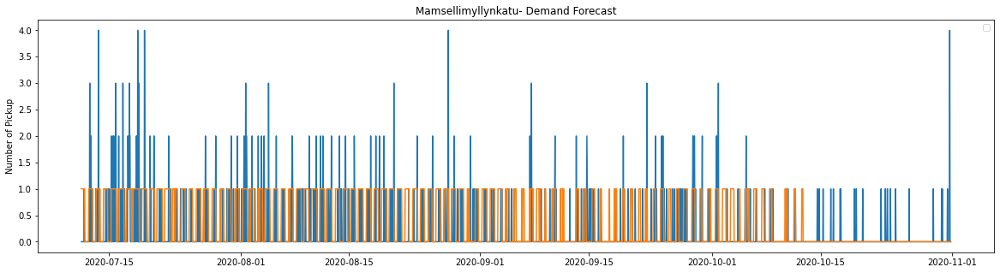

Mankkaanaukio total samples:  21922
Training samples:  17537
Testing samples:  4385


R-squared is: %f 0.20392722722495282
MAE is: %f 0.688939566704675
MSE is: %f 1.2973774230330672


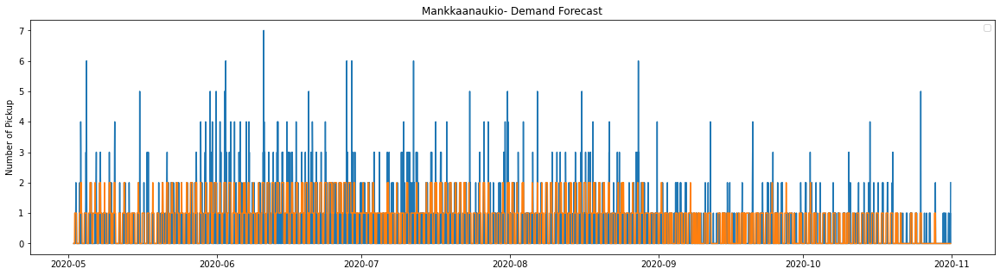

Mankkaanlaaksontie total samples:  21925
Training samples:  17540
Testing samples:  4385


R-squared is: %f 0.23554568591323555
MAE is: %f 0.7222348916761687
MSE is: %f 1.556442417331813


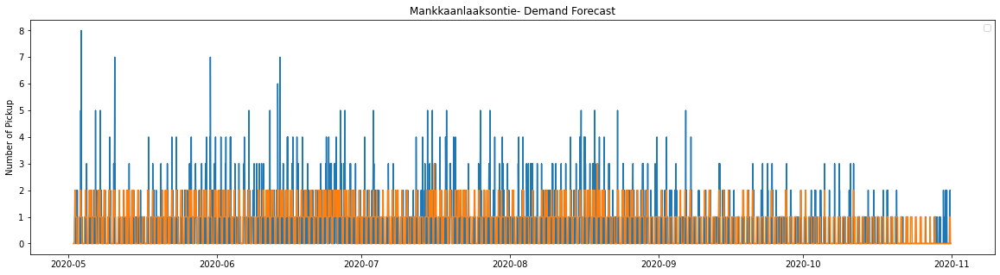

Mannerheimintie total samples:  39102
Training samples:  31281
Testing samples:  7821


R-squared is: %f 0.7676881381520971
MAE is: %f 1.9479606188466947
MSE is: %f 13.928014320419384


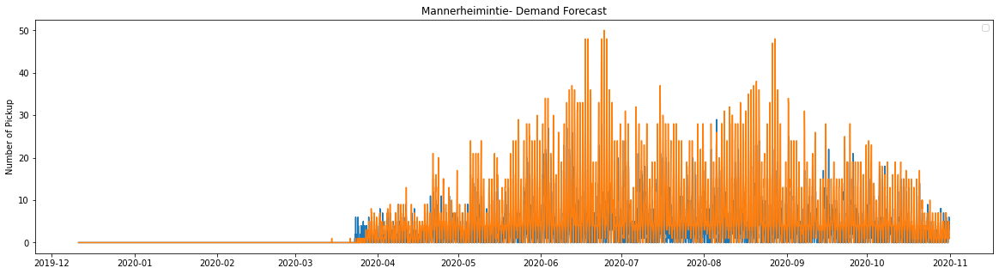

Margareetankuja total samples:  13539
Training samples:  10831
Testing samples:  2708


R-squared is: %f 0.16888349031931793
MAE is: %f 0.7282127031019202
MSE is: %f 1.258493353028065


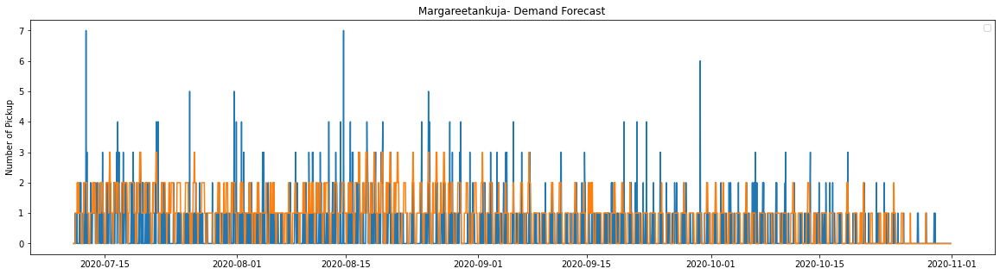

Marian sairaala total samples:  36484
Training samples:  29187
Testing samples:  7297


R-squared is: %f 0.742006635076087
MAE is: %f 1.9841030560504316
MSE is: %f 11.032753186240921


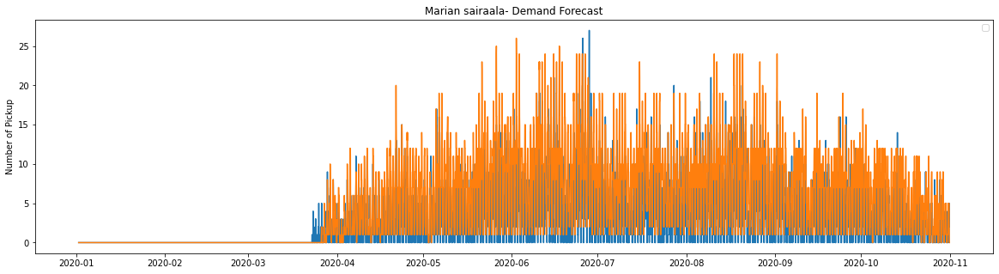

Marjaniementie total samples:  13515
Training samples:  10812
Testing samples:  2703


R-squared is: %f 0.32599924450789086
MAE is: %f 0.9119496855345912
MSE is: %f 1.8242693303736588


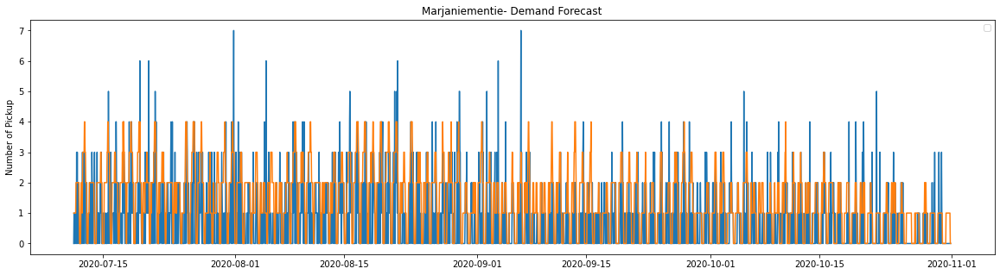

Marjaniemi total samples:  13494
Training samples:  10795
Testing samples:  2699


R-squared is: %f -0.02393640761965976
MAE is: %f 0.3616154131159689
MSE is: %f 0.50389032975176


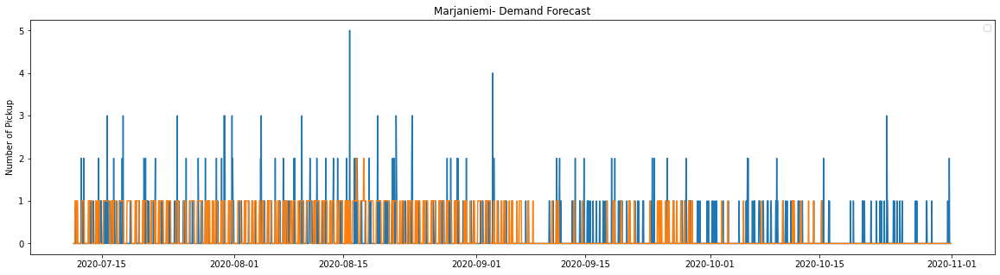

Marttila total samples:  13546
Training samples:  10836
Testing samples:  2710


R-squared is: %f 0.14497563781708467
MAE is: %f 0.6309963099630996
MSE is: %f 1.1107011070110702


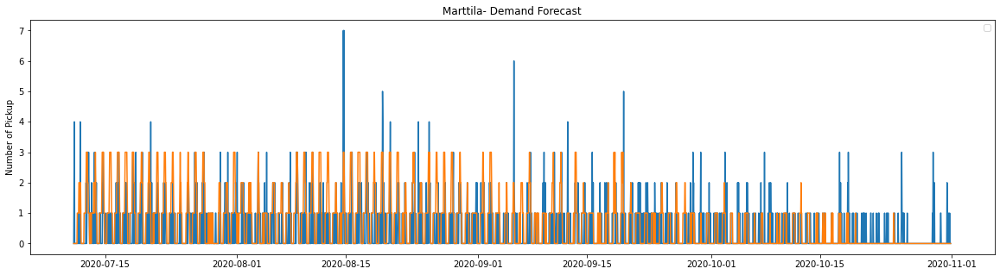

Mastokatu total samples:  39101
Training samples:  31280
Testing samples:  7821


R-squared is: %f 0.5070453172408729
MAE is: %f 0.8762306610407876
MSE is: %f 2.673187571921749


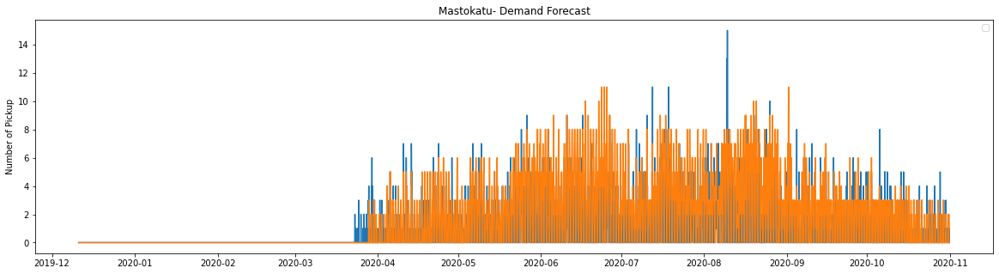

Matinkartanontie total samples:  30684
Training samples:  24547
Testing samples:  6137


R-squared is: %f 0.47535799621761987
MAE is: %f 0.973765683558742
MSE is: %f 2.658953886263647


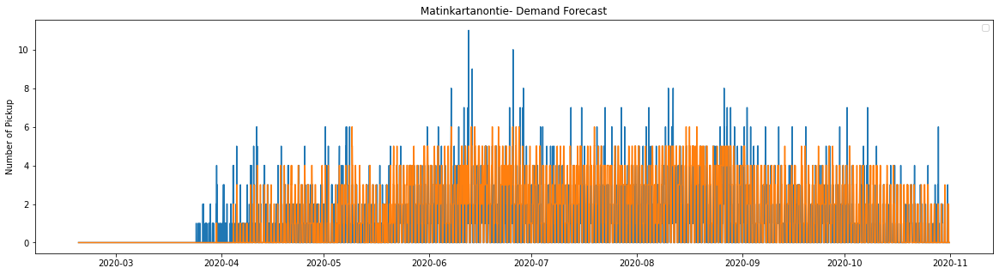

Matinkyläntie total samples:  21915
Training samples:  17532
Testing samples:  4383


R-squared is: %f 0.38249095318133175
MAE is: %f 1.0198494182067077
MSE is: %f 2.48642482318047


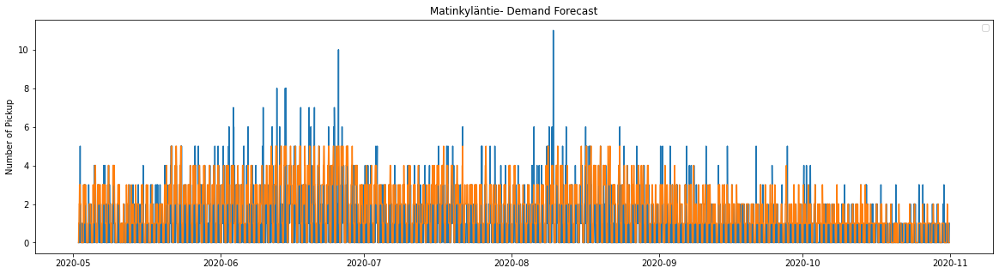

Matinlahdenranta total samples:  21917
Training samples:  17533
Testing samples:  4384


R-squared is: %f 0.553101411549686
MAE is: %f 1.0127737226277371
MSE is: %f 3.4507299270072993


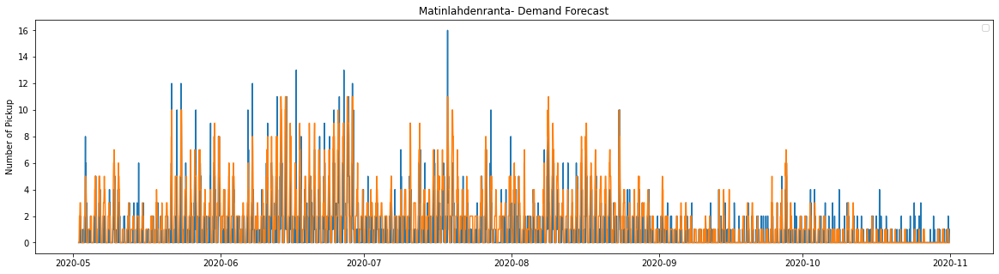

Maunula total samples:  13543
Training samples:  10834
Testing samples:  2709


R-squared is: %f 0.09228600857528602
MAE is: %f 0.6995201181247693
MSE is: %f 1.1823551125876708


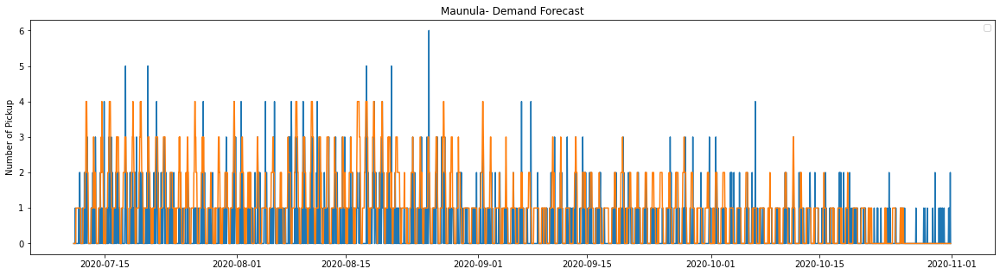

Meilahden sairaala total samples:  30680
Training samples:  24544
Testing samples:  6136


R-squared is: %f 0.7125548651257623
MAE is: %f 1.7869947848761407
MSE is: %f 10.707464146023469


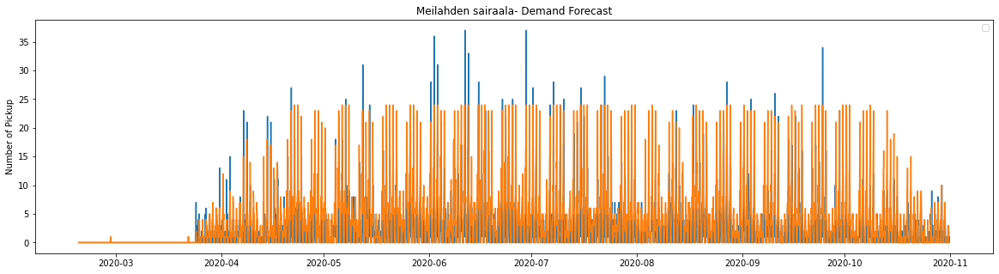

Melkonkuja total samples:  30682
Training samples:  24545
Testing samples:  6137


R-squared is: %f 0.5721931497689676
MAE is: %f 1.1655532018901744
MSE is: %f 3.654391396447776


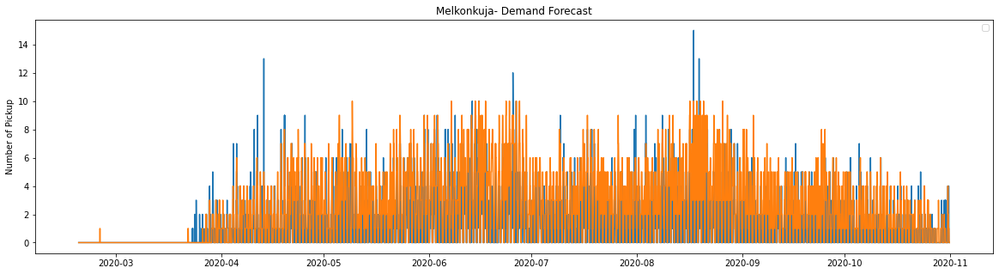

Mellstenintie total samples:  21920
Training samples:  17536
Testing samples:  4384


R-squared is: %f 0.6356821800362014
MAE is: %f 1.2785127737226278
MSE is: %f 6.524863138686132


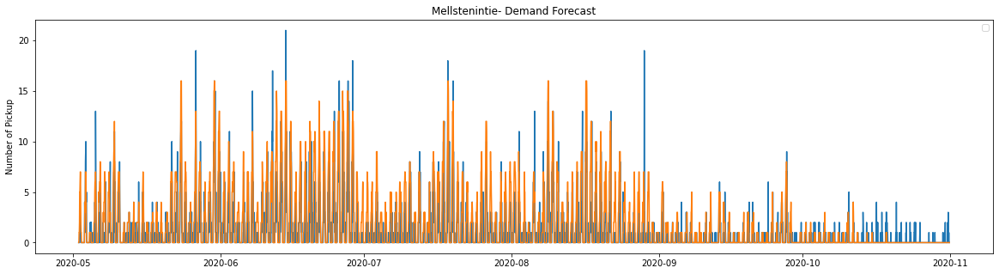

Merihaka total samples:  13831
Training samples:  11064
Testing samples:  2767


R-squared is: %f 0.5372903082363942
MAE is: %f 2.212143115287315
MSE is: %f 9.466931694976509


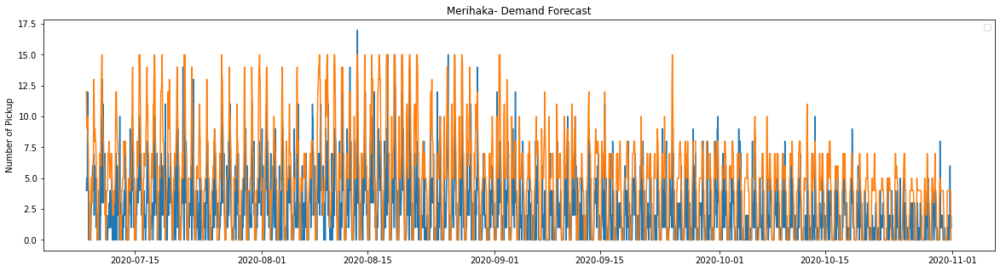

Merisotilaantori total samples:  39101
Training samples:  31280
Testing samples:  7821


R-squared is: %f 0.6475087056657371
MAE is: %f 1.1168648510420662
MSE is: %f 4.186804756425009


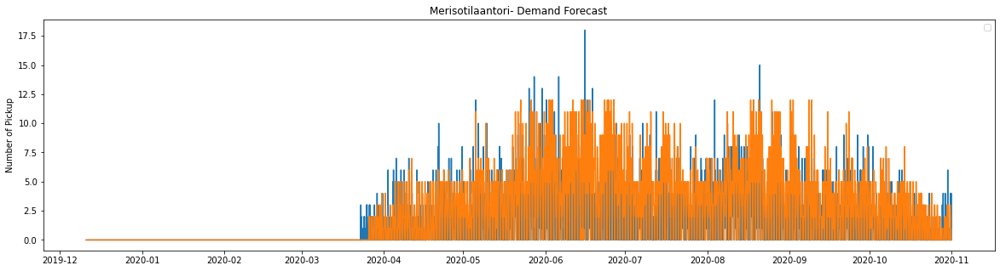

Messeniuksenkatu total samples:  30680
Training samples:  24544
Testing samples:  6136


R-squared is: %f 0.6604187041701863
MAE is: %f 2.36261408083442
MSE is: %f 12.679432855280313


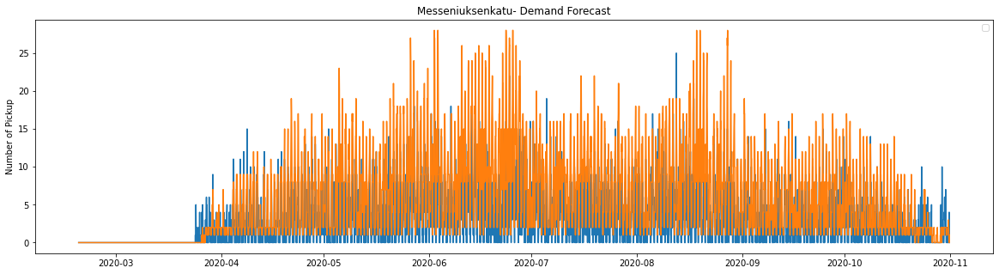

Metsänneidonpolku total samples:  21919
Training samples:  17535
Testing samples:  4384


R-squared is: %f 0.3136472204864633
MAE is: %f 0.8734032846715328
MSE is: %f 2.230155109489051


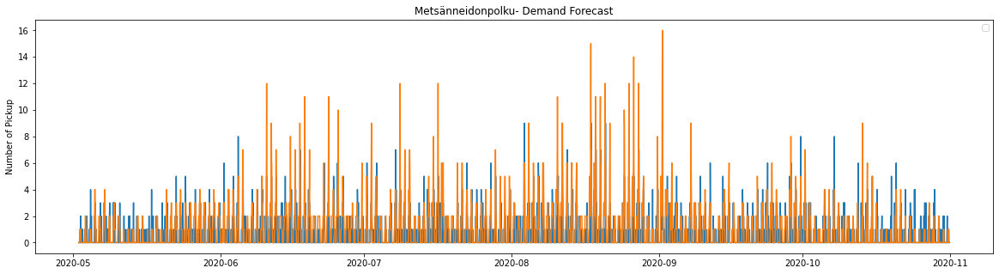

Munkkiniemen aukio total samples:  30680
Training samples:  24544
Testing samples:  6136


R-squared is: %f 0.6705414048753305
MAE is: %f 1.6844850065189048
MSE is: %f 7.092568448500652


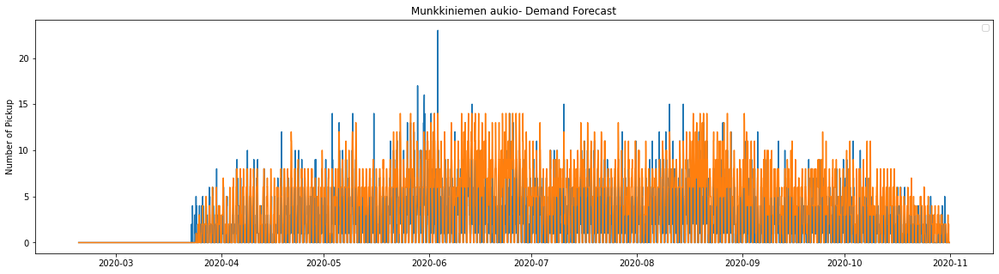

Muotoilijankatu total samples:  4424
Training samples:  3539
Testing samples:  885


R-squared is: %f 0.39744359570027965
MAE is: %f 0.9254237288135593
MSE is: %f 2.3446327683615817


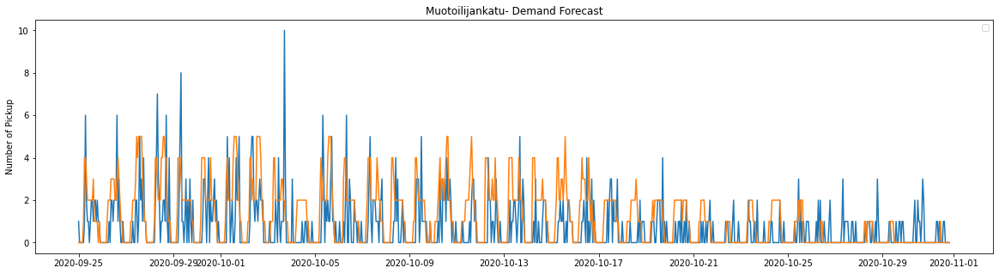

Mustikkamaa total samples:  13493
Training samples:  10794
Testing samples:  2699


R-squared is: %f 0.5834801973120772
MAE is: %f 1.4712856613560579
MSE is: %f 8.55909596146721


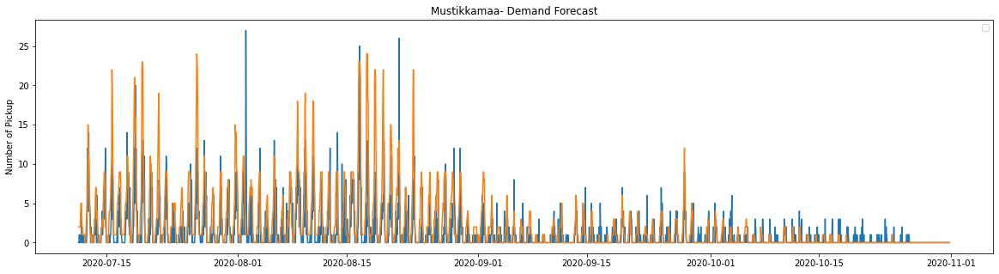

Muurarinkuja total samples:  20019
Training samples:  16015
Testing samples:  4004


R-squared is: %f 0.2481557741514534
MAE is: %f 0.7407592407592407
MSE is: %f 1.2582417582417582


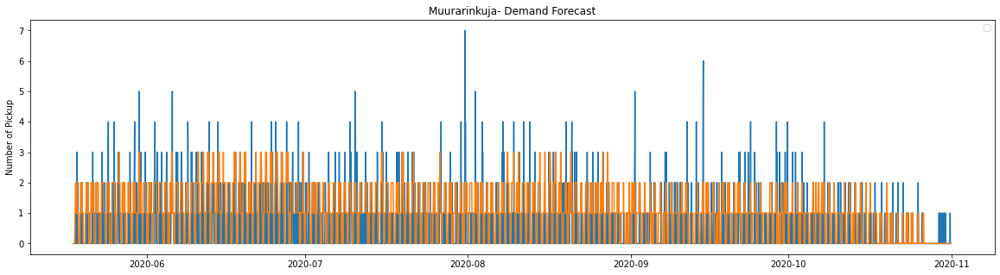

Muusantori total samples:  30658
Training samples:  24526
Testing samples:  6132


R-squared is: %f 0.38515965787215
MAE is: %f 0.9915198956294846
MSE is: %f 2.750815394651011


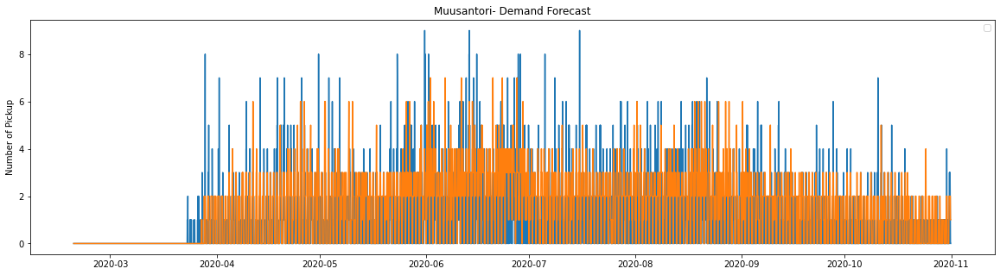

Myllypuro (M) total samples:  13518
Training samples:  10814
Testing samples:  2704


R-squared is: %f 0.21881702287638682
MAE is: %f 0.742603550295858
MSE is: %f 1.5096153846153846


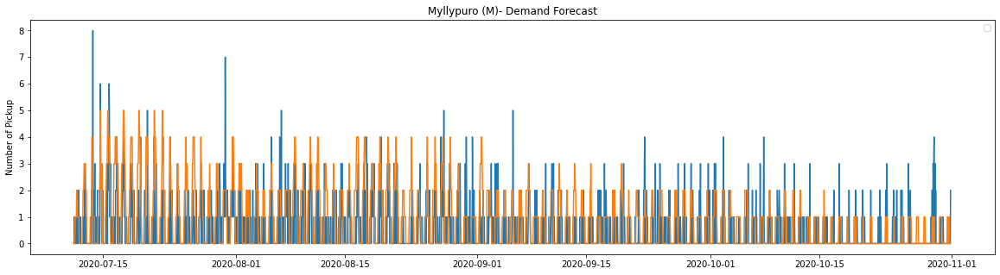

Mäkelänkatu total samples:  30676
Training samples:  24540
Testing samples:  6136


R-squared is: %f 0.3878869297066563
MAE is: %f 1.6631355932203389
MSE is: %f 6.35022816166884


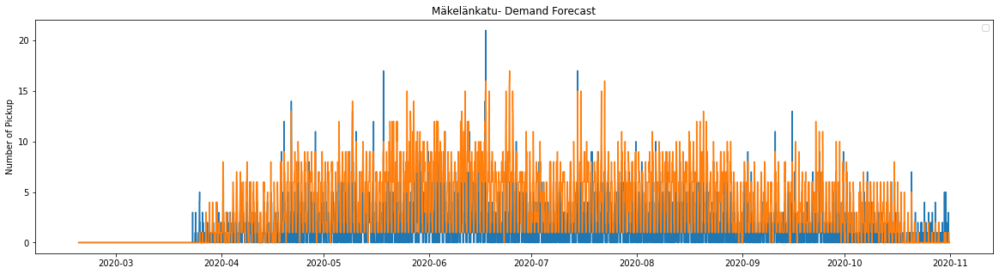

Mäkitorpantie total samples:  13813
Training samples:  11050
Testing samples:  2763


R-squared is: %f -0.09960572092008246
MAE is: %f 0.37857401375316685
MSE is: %f 0.5689467969598263


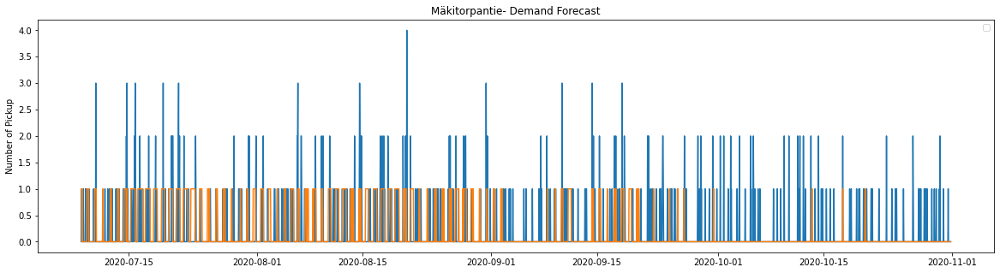

Mäkkylän asema total samples:  19895
Training samples:  15916
Testing samples:  3979


R-squared is: %f 0.17406838215132991
MAE is: %f 0.6177431515456144
MSE is: %f 1.0681075647147524


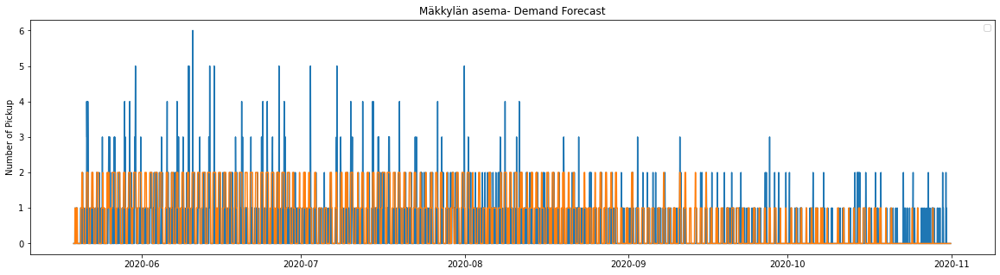

Mäntyviita total samples:  21921
Training samples:  17536
Testing samples:  4385


R-squared is: %f 0.3434530730473452
MAE is: %f 0.9450399087799316
MSE is: %f 2.176054732041049


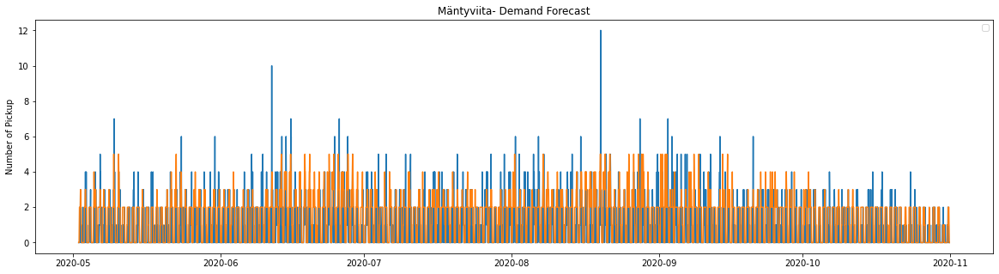

Model: "sequential_199"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_597 (LSTM)             (None, 1, 30)             48960     
                                                                 
 dropout_597 (Dropout)       (None, 1, 30)             0         
                                                                 
 lstm_598 (LSTM)             (None, 1, 30)             7320      
                                                                 
 dropout_598 (Dropout)       (None, 1, 30)             0         
                                                                 
 lstm_599 (LSTM)             (None, 30)                7320      
                                                                 
 dropout_599 (Dropout)       (None, 30)                0         
                                                                 
 dense_199 (Dense)           (None, 1)              

In [10]:
# Input data
all_station_temp=sample_demand
weather_data=sample_weather
lag=336
weather_forecast_hours=3
predicting_hours=2

# run the model
station_name_results = list()
rSquare_results = list()
MAE_results = list()
MSE_results = list()

for i in range(len(all_station_temp.columns)):
    
    # preprocessing
    station_value, station_name = get_value_name(all_station_temp,i)

    X_train_tract1_array, y_train_tract1_array, X_test_tract1_array, y_test_tract1_array, split_row = preparedata_for_model(station_name, station_value, lag, weather_data, weather_forecast_hours, split_ratio=0.8)
    

    trainX = np.reshape(X_train_tract1_array, (X_train_tract1_array.shape[0],1,X_train_tract1_array.shape[1]))
    testX = np.reshape(X_test_tract1_array, (X_test_tract1_array.shape[0],1,X_test_tract1_array.shape[1]))                
    
    # LSTM modelling & forecast
    model = lstm_model(30, trainX, testX, y_train_tract1_array, y_test_tract1_array)             
    test_tract1_pred, rSquare_test, MAE, MSE = valid_result(model, testX, y_test_tract1_array, station_value, split_row, weather_forecast_hours, lag)        
            
    
    #Save result
    station_name_results.append(station_name)
    rSquare_results.append(rSquare_test)
    MAE_results.append(MAE)
    MSE_results.append(MSE)

    # plot result
    plt.figure(figsize=(20,5))
    plt.plot(test_tract1_pred)        
    plt.ylabel('Number of Pickup')
    plt.legend(loc='upper right')
    plt.title(station_name + '- Demand Forecast')
    plt.show() 

model.summary()
mean_rSquare =   sum(rSquare_results) / len(rSquare_results)
print("mean_rSquare: ", mean_rSquare)
#station_name_results.append('Mean of all station')
#rSquare_results.append(mean_rSquare)

results = pd.DataFrame({'station': station_name_results, 'rSquare': rSquare_results, 'MAE': MAE_results, 'MSE': MSE_results}, columns=['station', 'rSquare', 'MAE', 'MSE'])

results.to_csv('lstm_336_3.csv')